<a href="https://colab.research.google.com/github/sina973/Autoencoder-with-GAN/blob/main/Cifar10_Autoencoder.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import matplotlib.pyplot as plt # plotting library
import numpy as np # this module is useful to work with numerical arrays
import pandas as pd
import random
import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader,random_split
from torch import nn
import torch.nn.functional as F
import torch.optim as optim


# convert data to torch.FloatTensor
transform = transforms.ToTensor()

# load the training and test datasets
train_data = torchvision.datasets.CIFAR10(root='data', train=True, download=True, transform=transform)
test_data = torchvision.datasets.CIFAR10(root='data', train=False, download=True, transform=transform)


# Create training and test dataloaders
num_workers = 0
# how many samples per batch to load
batch_size = 20000
batch_size_test = 4000
# prepare data loaders
train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size, num_workers=num_workers, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_data, batch_size=batch_size_test, num_workers=num_workers, shuffle=True)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting data/cifar-10-python.tar.gz to data
Files already downloaded and verified


In [ ]:
class Encoder(nn.Module):

    def __init__(self, encoded_space_dim):
        super().__init__()

        ### Convolutional section
        self.encoder_cnn = nn.Sequential(                       ## Input dimension is 3 * 32 * 32
            nn.Conv2d(3, 8, 5, stride=1, padding=2),
            nn.ReLU(True),                                      ## The output dimension of this layer will be 8 * 32 * 32
            nn.Conv2d(8, 8, 3, stride=1, padding=1),
            nn.ReLU(True),                                      ## The output dimension of this layer will be 8 * 32 * 32
            nn.Conv2d(8, 16, 4, stride=2, padding=1),
            nn.ReLU(True),                                      ## The output dimension of this layer will be 16 * 16 * 16
            nn.BatchNorm2d(16),
            # nn.ReLU(True),
            nn.Conv2d(16, 16, 3, stride=1, padding=1),           ## The output dimension of this layer will be 16 * 16 * 16
            nn.ReLU(True),
            nn.Conv2d(16, 32, 4, stride=2, padding=1),           ## The output dimension of this layer will be 32 * 8 * 8
            nn.LeakyReLU(0.3),
            nn.Conv2d(32, 32, 3, stride=1, padding=1),          ## The output dimension of this layer will be 32 * 8 * 8
            nn.ReLU(True),
            # nn.Conv2d(32, 32, 3, stride=1, padding=1),           ## The output dimension of this layer will be 32 * 8 * 8
            # nn.ReLU(True),
            # nn.Conv2d(32, 32, 3, stride=1, padding=1),           ## The output dimension of this layer will be 32 * 8 * 8
            # nn.ReLU(True),
            nn.Conv2d(32, 32, 3, stride=1, padding=1),           ## The output dimension of this layer will be 32 * 8 * 8
            nn.ReLU(True)
            # nn.Conv2d(64, 64, 5, stride=1, padding=2),          ## The output dimension of this layer will be 64 * 4 * 4
            # nn.ReLU(True),
            # # nn.MaxPool2d(2, stride=2),                          ## The output dimension of this layer will be 32 * 8 * 8 -----> Temporary inactive
            # nn.Conv2d(64, 64, 5, stride=1, padding=2),
            # nn.ReLU(True),                                      ## The output dimension of this layer will be 64 * 4 * 4
            # nn.MaxPool2d(2, stride=2)
        )


    def forward(self, x):
        x = self.encoder_cnn(x)
        return x
class Decoder(nn.Module):

    def __init__(self, encoded_space_dim):
        super().__init__()

        self.decoder_conv = nn.Sequential(
            # nn.ConvTranspose2d(64, 32, 3,
            # stride=2, padding = 1, output_padding=1),
            # nn.BatchNorm2d(32),                                 ## The output dimension of this layer will be 32 * 8 * 8
            # nn.ReLU(True),
            nn.ConvTranspose2d(32, 32, 3, stride=1,
            padding=1, output_padding=0),
            nn.BatchNorm2d(32),                                 ## The output dimension of this layer will be 32 * 8 * 8
            nn.ReLU(True),
            nn.ConvTranspose2d(32, 16, 3, stride=2,
            padding=1, output_padding=1),                       ## The output dimension of this layer will be 16 * 16 * 16
            nn.BatchNorm2d(16),
            nn.ReLU(True),
            nn.ConvTranspose2d(16, 16, 3, stride=1,
            padding=1, output_padding=0),
            # nn.ReLU(True),                     ## The output dimension of this layer will be 16 * 16 * 16
            # nn.ConvTranspose2d(16, 16, 3, stride=1,
            # padding=1, output_padding=0),
            nn.ReLU(True),                     ## The output dimension of this layer will be 16 * 16 * 16
            nn.ConvTranspose2d(16, 8, 3,
            stride=2, padding = 1, output_padding=1),
            # nn.BatchNorm2d(8),                                 ## The output dimension of this layer will be 8 * 32 * 32
            nn.LeakyReLU(0.3),
            nn.ConvTranspose2d(8, 8, 3, stride=1,
            padding=1, output_padding=0),
            # nn.BatchNorm2d(16),
            # nn.ReLU(True),                              ## The output dimension of this layer will be 8 * 32 * 32
            # nn.ConvTranspose2d(8, 8, 3, stride=1,
            # padding=1, output_padding=0),
            # nn.BatchNorm2d(16),                                 ## The output dimension of this layer will be 8 * 32 * 32
            nn.ReLU(True),
            nn.ConvTranspose2d(8, 3, 3, stride=1,
            padding=1, output_padding=0),                       ## The output dimension of this layer will be 3 * 32 * 32
            nn.BatchNorm2d(3),
            nn.ReLU(True),
            nn.ConvTranspose2d(3, 3, 3, stride=1,               ## The output dimension of this layer will be 3 * 32 * 32
            padding=1, output_padding=0)
            # nn.MaxPool2d(2, stride=2)
        )


    def forward(self, x):
        x = self.decoder_conv(x)
        x = torch.sigmoid(x)
        return x

In [ ]:
# import pytorch_ssim
### Define the loss function
# loss_fn = torch.nn.MSELoss()
loss_fn = torch.nn.BCELoss()
# loss_fn = pytorch_ssim.SSIM()

### Define an optimizer (both for the encoder and the decoder!)
lr= 0.006

### Set the random seed for reproducible results
torch.manual_seed(0)

### Initialize the two networks
d = 16

#model = Autoencoder(encoded_space_dim=encoded_space_dim)
encoder = Encoder(encoded_space_dim=d)
decoder = Decoder(encoded_space_dim=d)
params_to_optimize = [
    {'params': encoder.parameters()},
    {'params': decoder.parameters()}
]

optimizer = torch.optim.Adam(params_to_optimize, lr=lr, weight_decay=1e-05)

# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

# Move both the encoder and the decoder to the selected device
encoder.to(device)
decoder.to(device)

Selected device: cuda


Decoder(
  (decoder_conv): Sequential(
    (0): ConvTranspose2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(32, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (4): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): ConvTranspose2d(16, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (9): LeakyReLU(negative_slope=0.3)
    (10): ConvTranspose2d(8, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(8, 3, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(3, eps=1e-05, momentum=0.1, affine=True, track_running_stats=T

In [ ]:
# from sewar.full_ref import ssim

### Training function
def train_epoch(encoder, decoder, device, dataloader, loss_fn, optimizer,noise_factor=0.3):
    # Set train mode for both the encoder and the decoder
    encoder.train()
    decoder.train()
    train_loss = []
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for image_batch, _ in dataloader: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        # print(image_batch.shape)
        image_batch = image_batch.to(device)
        # print(image_batch[0].shape)
        # Encode data
        encoded_data = encoder(image_batch)
        # print(encoded_data.shape)
        # Decode data
        decoded_data = decoder(encoded_data)
        # print(decoded_data.shape)
        # Evaluate loss
        loss = loss_fn(decoded_data, image_batch)
        # print("SSIM: ", ssim(decoded_data, image_batch))
        # print("LOSS: ", loss)
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        # print('\t partial train loss (single batch): %f' % (loss.data))
        train_loss.append(loss.detach().cpu().numpy())

    return np.mean(train_loss)

In [ ]:
### Testing function
import numpy as np
test_array = np.zeros((256,3,32,32))
test_reconstructed_array = np.zeros((256,3,32,32))

def test_epoch(encoder, decoder, device, dataloader, loss_fn):
    # Set evaluation mode for encoder and decoder
    encoder.eval()
    decoder.eval()
    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        conc_out = []
        conc_label = []
        for image_batch, _ in dataloader:
            # Move tensor to the proper device
            image_batch = image_batch.to(device)
            # Encode data
            encoded_data = encoder(image_batch)
            # Decode data
            decoded_data = decoder(encoded_data)
            conc_out.append(decoded_data.cpu())
            conc_label.append(image_batch.cpu())
            # print(image_batch.detach().cpu().numpy())
            # print(image_batch.detach().cpu().numpy().shape)
            np.append(test_array, image_batch.detach().cpu().numpy(), axis=0)
            np.append(test_reconstructed_array, decoded_data.detach().cpu().numpy(), axis=0)
        # Create a single tensor with all the values in the lists
        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label)
        # Evaluate global loss
        val_loss = loss_fn(conc_out, conc_label)
    return val_loss.data

In [ ]:
def plot_ae_outputs(encoder,decoder,n=20):
    img = []
    rec_img = []
    encoder.eval()
    decoder.eval()
    for i in range(n):
      img.append(test_data[i][0].unsqueeze(0).to(device))
      with torch.no_grad():
         rec_img.append(decoder(encoder(img[i])))
      img[i] = img[i].cpu().squeeze().numpy()
      rec_img[i] = rec_img[i].cpu().squeeze().numpy()
    # plot the first ten input images and then reconstructed images
    fig, axes = plt.subplots(nrows=2, ncols=10, sharex=True, sharey=True, figsize=(24,4))
    for idx in np.arange(20):
          ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
          plt.imshow(np.transpose(img[idx], (1, 2, 0)))
          ax.set_title("Original")

    # plot the first ten input images and then reconstructed images
    fig, axes = plt.subplots(nrows=2, ncols=10, sharex=True, sharey=True, figsize=(24,4))
    for idx in np.arange(20):
          ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
          plt.imshow(np.transpose(rec_img[idx], (1, 2, 0)))
          ax.set_title("Recunstructed")
    plt.show()

In [ ]:
def plot_ae_outputs2(encoder,decoder,n=5):
    plt.figure(figsize=(10,4.5))
    for i in range(n):
      ax = plt.subplot(2,n,i+1)
      img = test_dataset[i][0].unsqueeze(0).to(device)
      encoder.eval()
      decoder.eval()
      with torch.no_grad():
         rec_img  = decoder(encoder(img))
      plt.imshow(img.cpu().squeeze().numpy(), cmap='gist_gray')
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)
      if i == n//2:
        ax.set_title('Original images')
      ax = plt.subplot(2, n, i + 1 + n)
      plt.imshow(rec_img.cpu().squeeze().numpy(), cmap='gist_gray')
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)
      if i == n//2:
         ax.set_title('Reconstructed images')
    plt.show()


 EPOCH 1/150 	 train loss 0.7039718627929688 	 val loss 0.6936827898025513


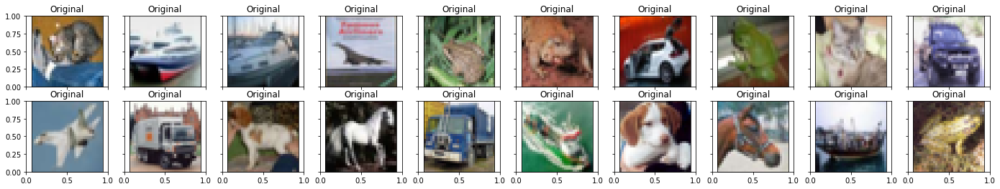

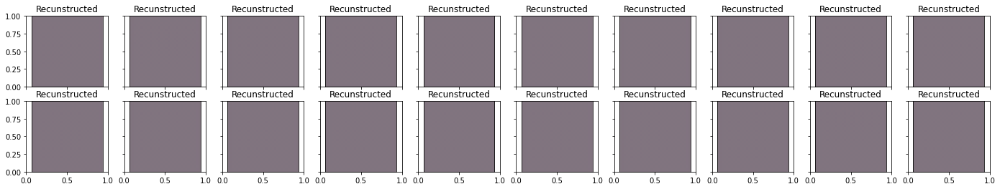


 EPOCH 2/150 	 train loss 0.6738619804382324 	 val loss 0.692955493927002


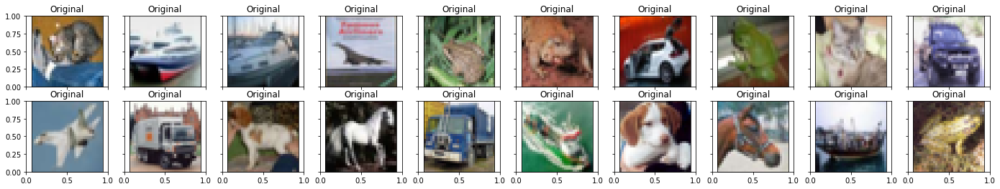

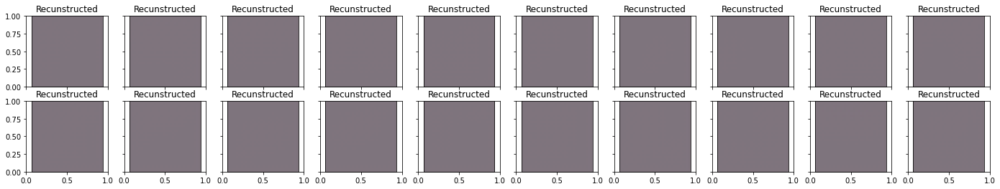


 EPOCH 3/150 	 train loss 0.6575634479522705 	 val loss 0.6849416494369507


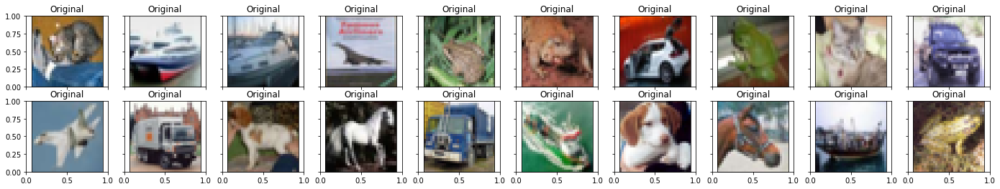

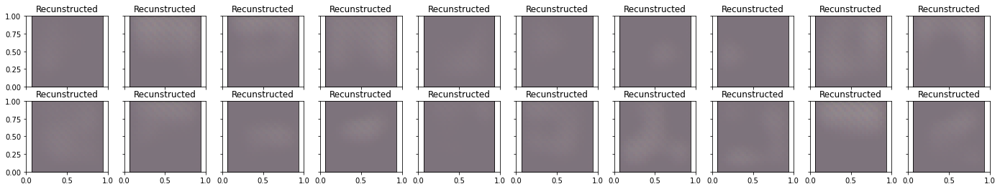


 EPOCH 4/150 	 train loss 0.6504223346710205 	 val loss 0.670433759689331


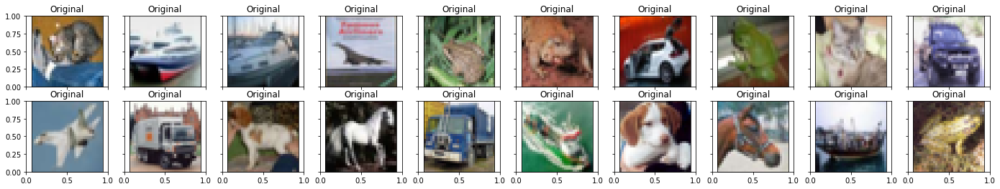

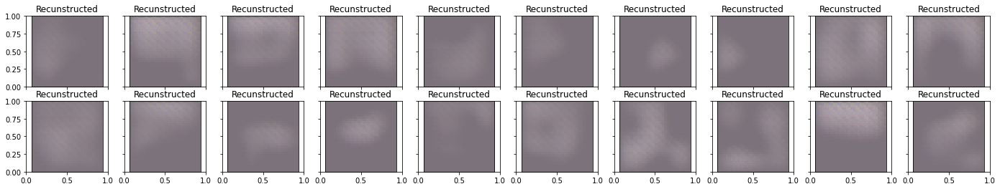


 EPOCH 5/150 	 train loss 0.6458216905593872 	 val loss 0.6565173268318176


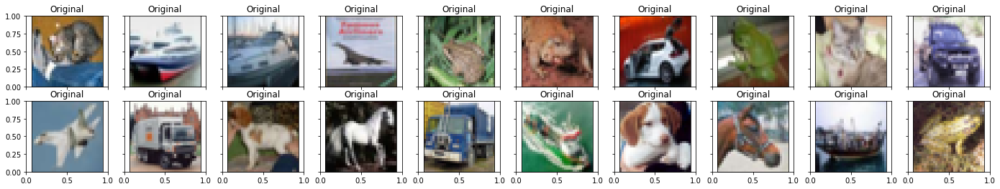

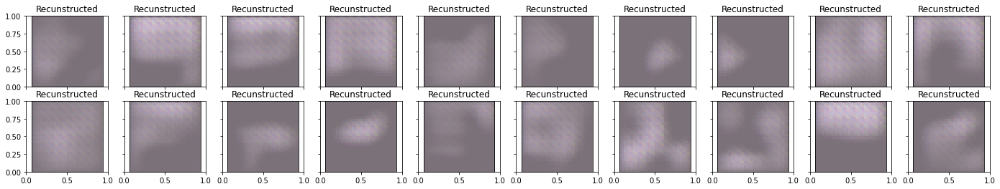


 EPOCH 6/150 	 train loss 0.6422638297080994 	 val loss 0.6496438980102539


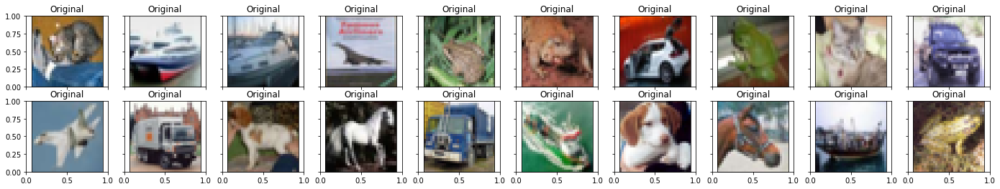

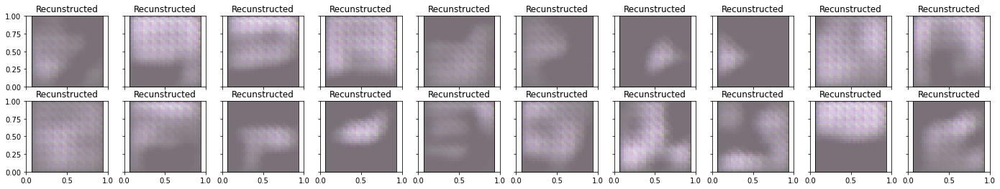


 EPOCH 7/150 	 train loss 0.6389438509941101 	 val loss 0.6437958478927612


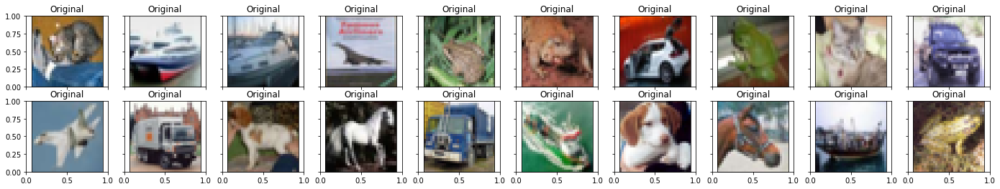

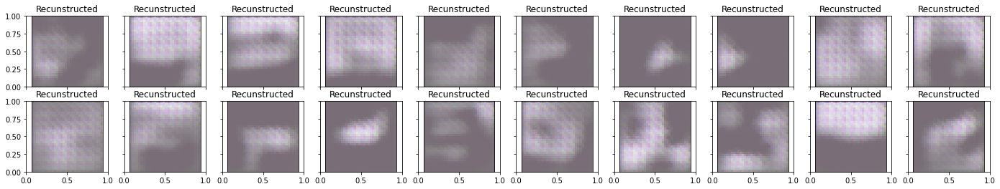


 EPOCH 8/150 	 train loss 0.6360897421836853 	 val loss 0.6368663311004639


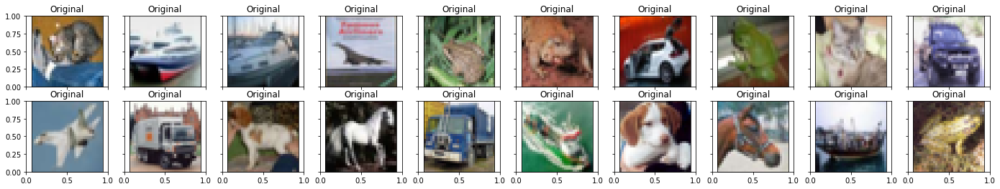

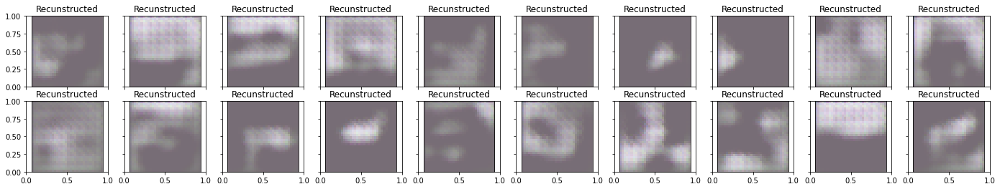


 EPOCH 9/150 	 train loss 0.6332772374153137 	 val loss 0.6355631351470947


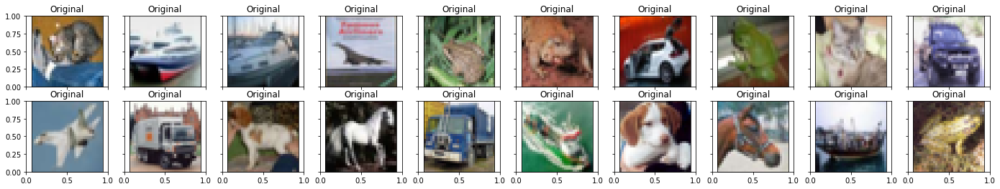

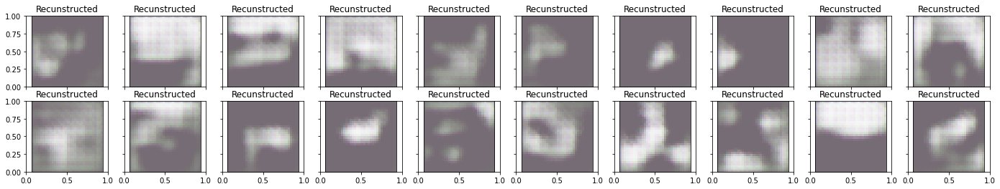


 EPOCH 10/150 	 train loss 0.6303808093070984 	 val loss 0.6369720697402954


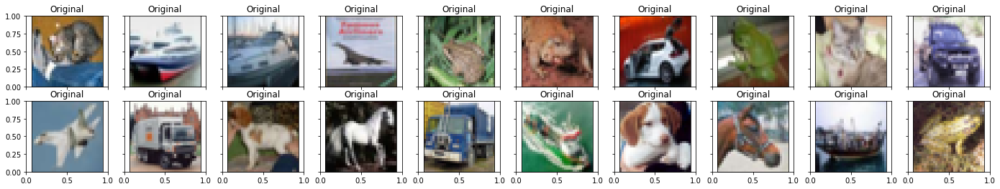

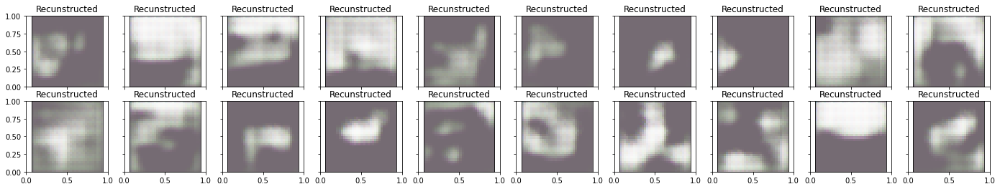


 EPOCH 11/150 	 train loss 0.6280667185783386 	 val loss 0.6277410387992859


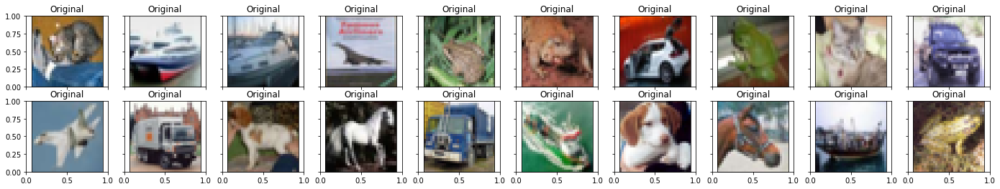

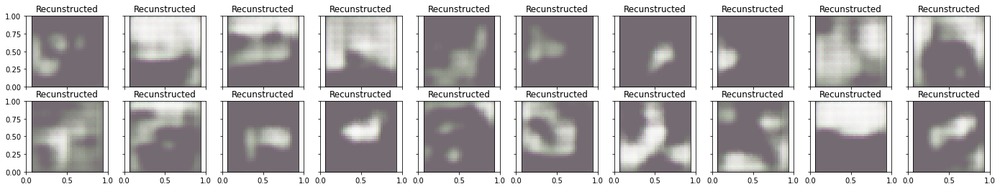


 EPOCH 12/150 	 train loss 0.6255916357040405 	 val loss 0.6245512962341309


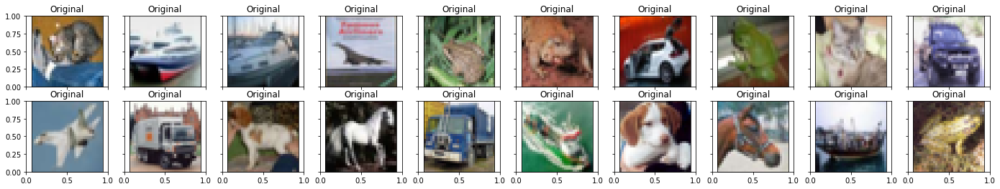

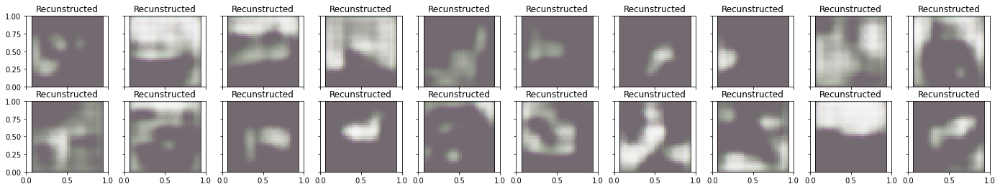


 EPOCH 13/150 	 train loss 0.6236342787742615 	 val loss 0.625037670135498


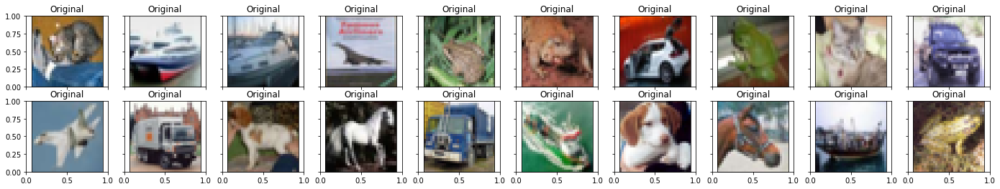

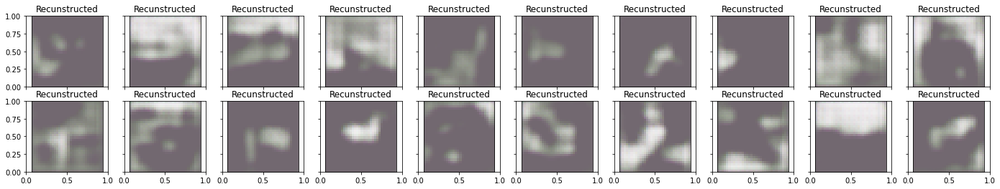


 EPOCH 14/150 	 train loss 0.6218753457069397 	 val loss 0.6261661052703857


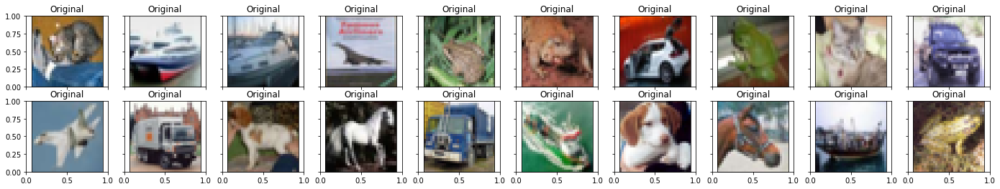

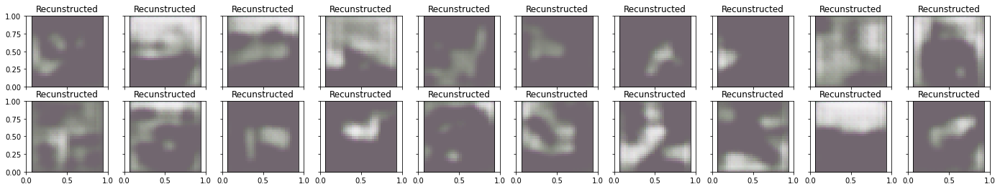


 EPOCH 15/150 	 train loss 0.6209610104560852 	 val loss 0.6271985173225403


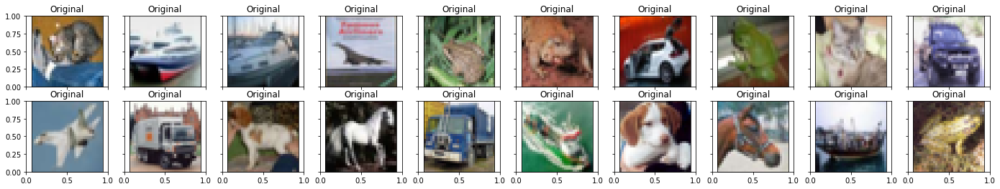

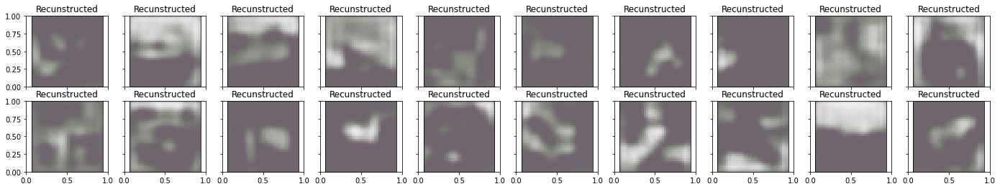


 EPOCH 16/150 	 train loss 0.6187940239906311 	 val loss 0.6208199262619019


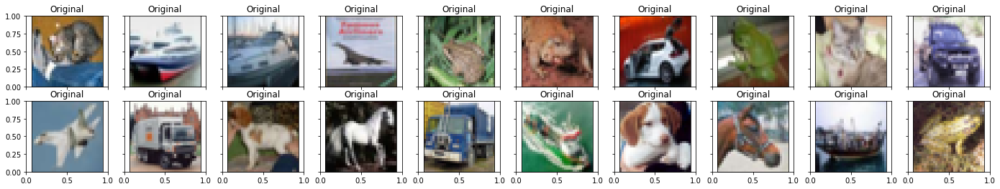

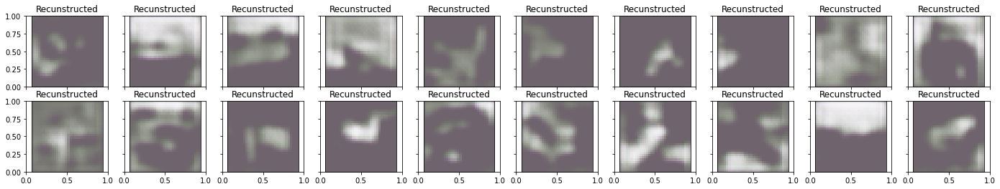


 EPOCH 17/150 	 train loss 0.6169545650482178 	 val loss 0.6171677112579346


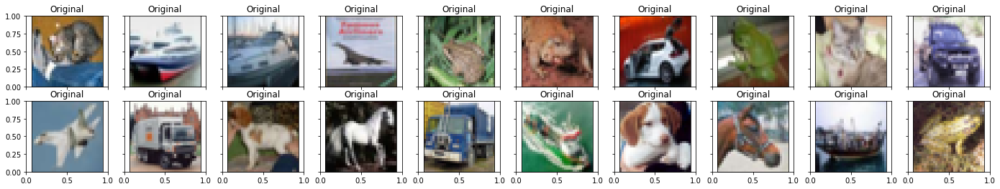

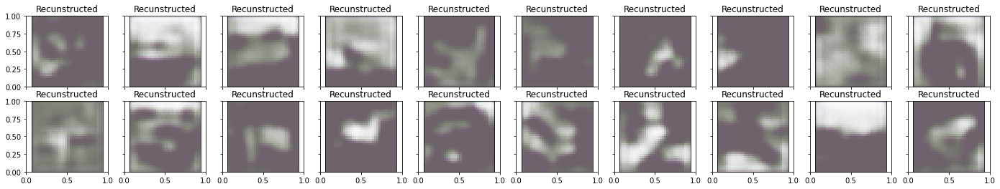


 EPOCH 18/150 	 train loss 0.6156229376792908 	 val loss 0.6177799105644226


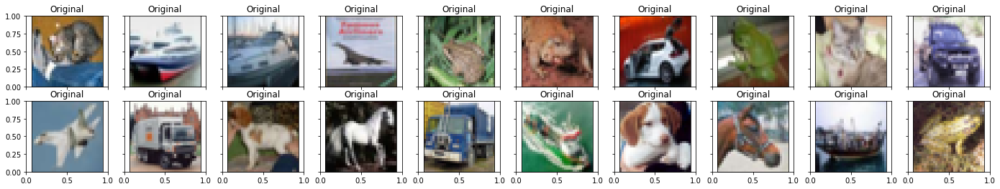

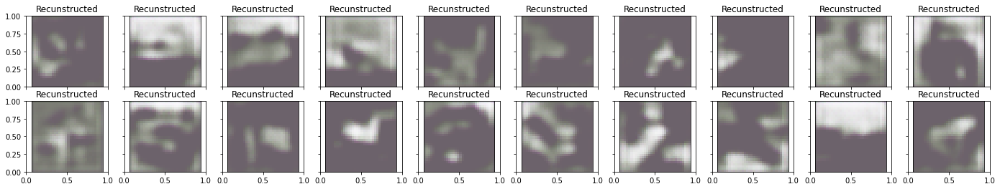


 EPOCH 19/150 	 train loss 0.6142198443412781 	 val loss 0.6174915432929993


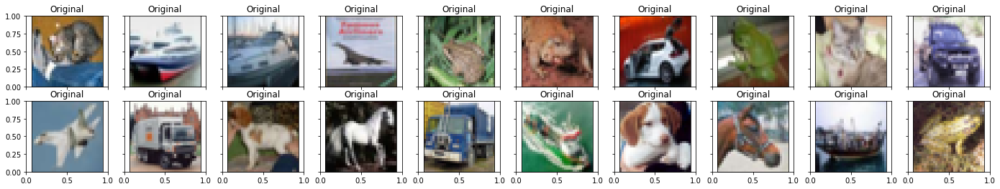

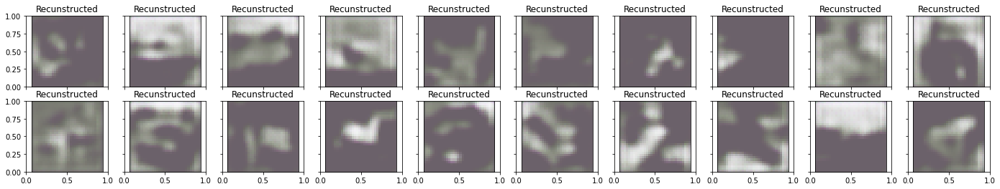


 EPOCH 20/150 	 train loss 0.6127063632011414 	 val loss 0.6149147748947144


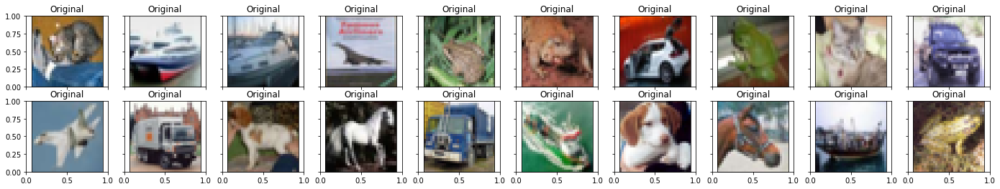

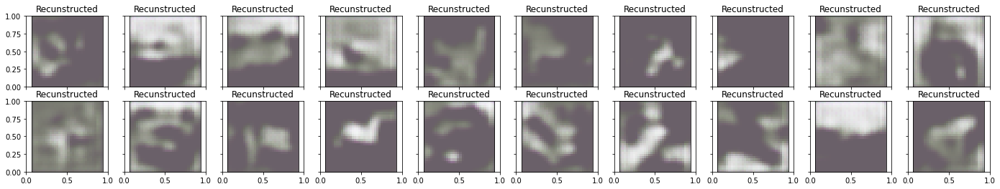


 EPOCH 21/150 	 train loss 0.6114998459815979 	 val loss 0.6128925681114197


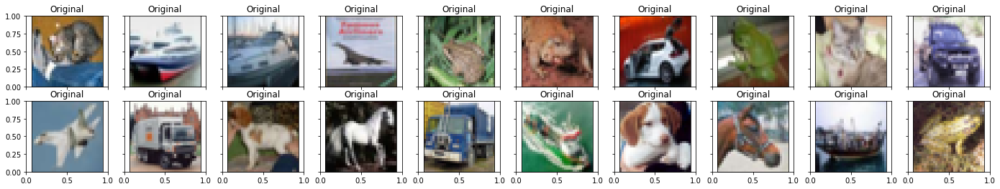

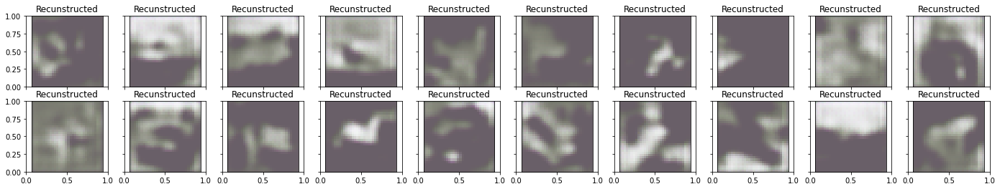


 EPOCH 22/150 	 train loss 0.6099945902824402 	 val loss 0.6103204488754272


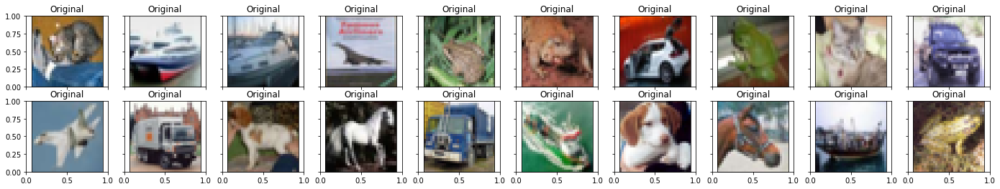

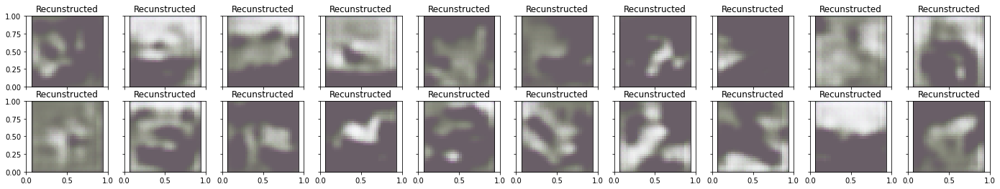


 EPOCH 23/150 	 train loss 0.6088331341743469 	 val loss 0.6090010404586792


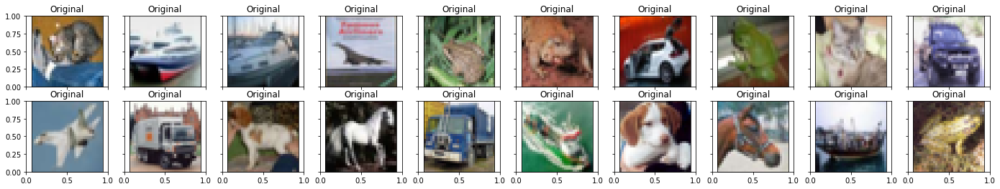

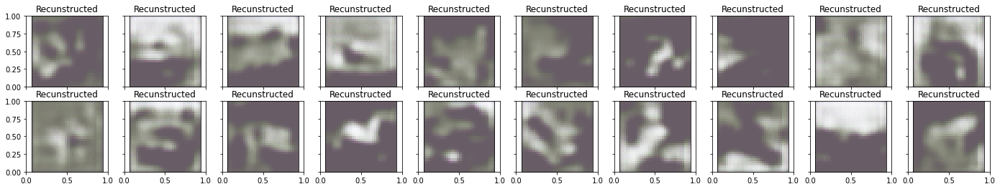


 EPOCH 24/150 	 train loss 0.608145534992218 	 val loss 0.6193490624427795


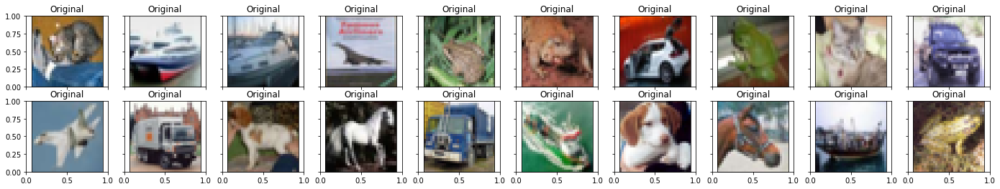

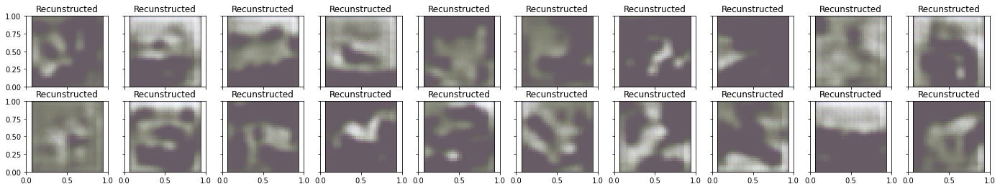


 EPOCH 25/150 	 train loss 0.6086650490760803 	 val loss 0.6126357913017273


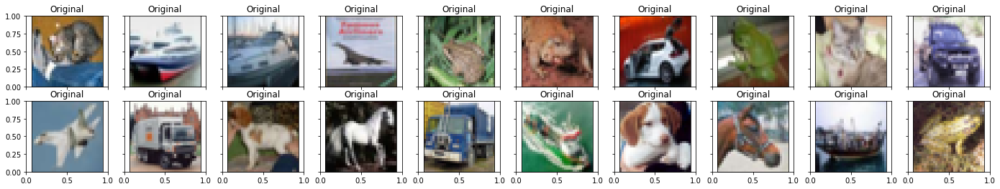

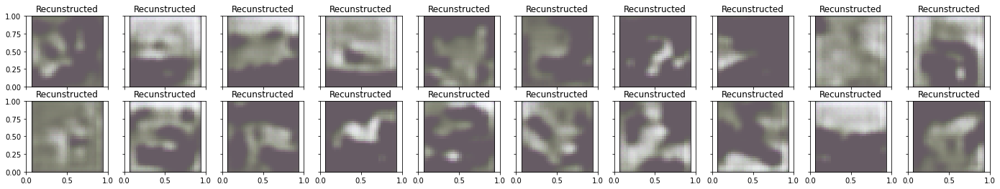


 EPOCH 26/150 	 train loss 0.6067283749580383 	 val loss 0.6077187657356262


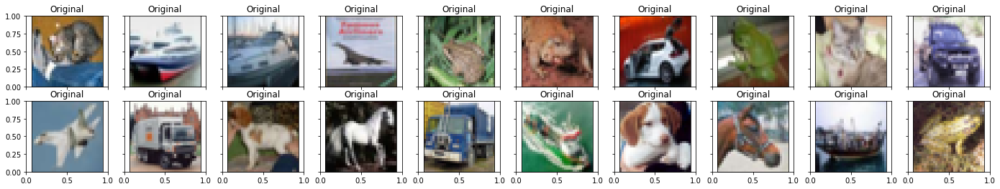

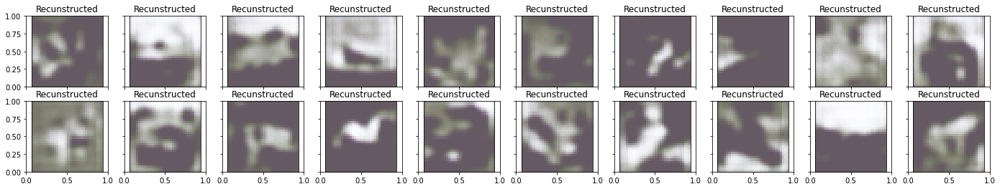


 EPOCH 27/150 	 train loss 0.6053803563117981 	 val loss 0.6058410406112671


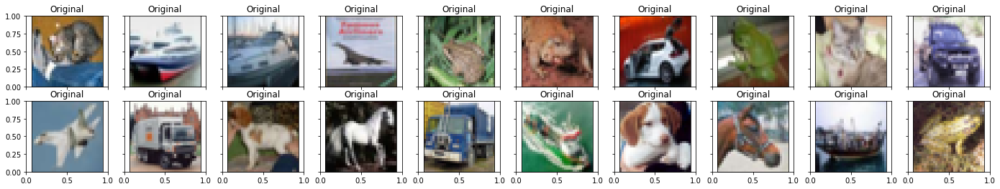

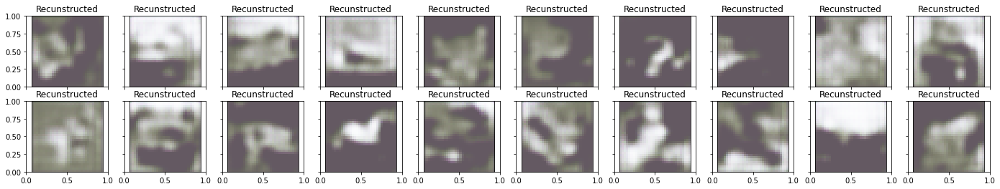


 EPOCH 28/150 	 train loss 0.6043968200683594 	 val loss 0.6079480648040771


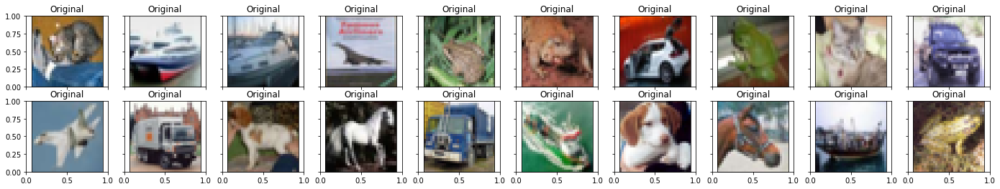

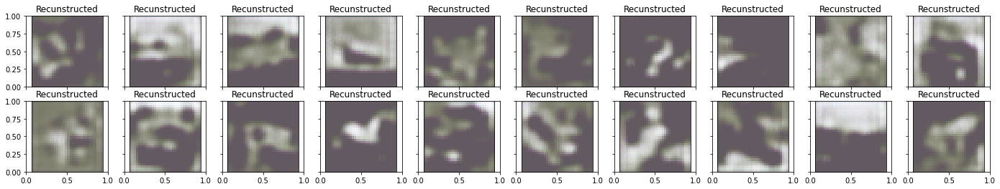


 EPOCH 29/150 	 train loss 0.6031703948974609 	 val loss 0.6032227873802185


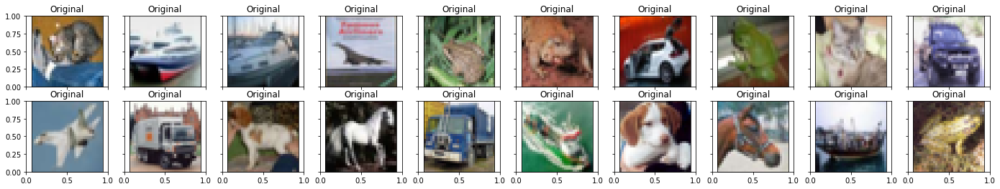

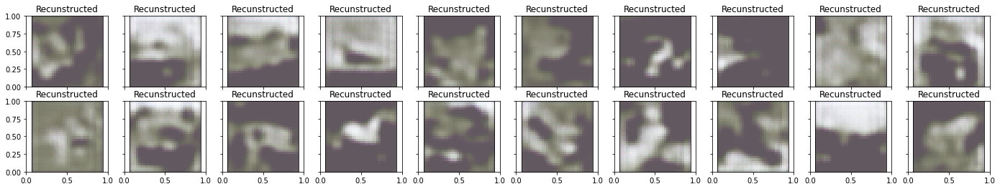


 EPOCH 30/150 	 train loss 0.6018490195274353 	 val loss 0.6033942699432373


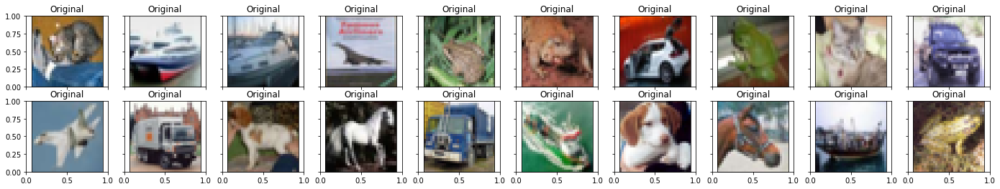

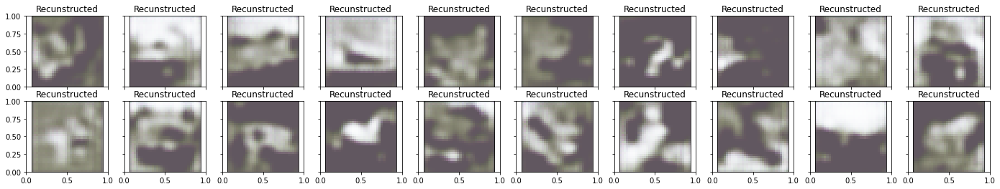


 EPOCH 31/150 	 train loss 0.6011012196540833 	 val loss 0.6002796292304993


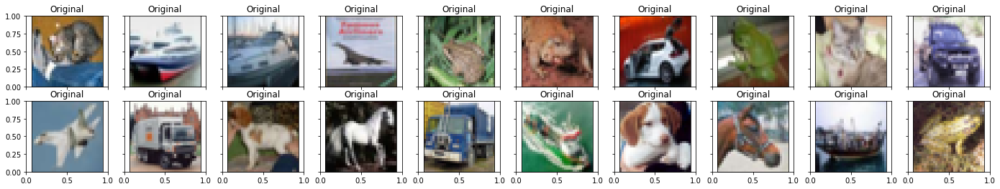

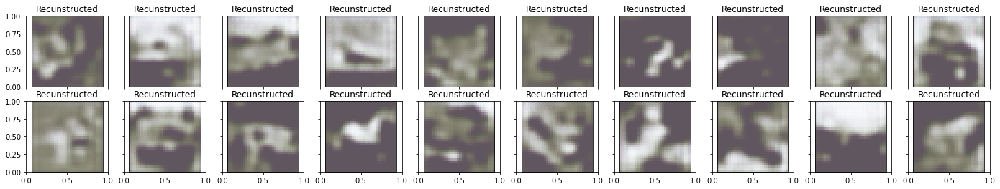


 EPOCH 32/150 	 train loss 0.6000400185585022 	 val loss 0.6008251309394836


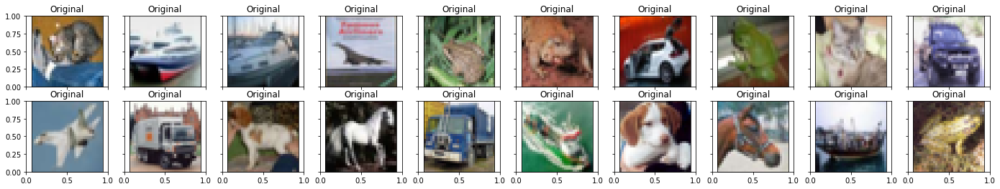

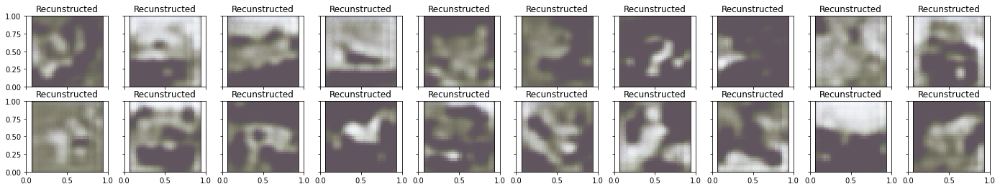


 EPOCH 33/150 	 train loss 0.5991519093513489 	 val loss 0.599885106086731


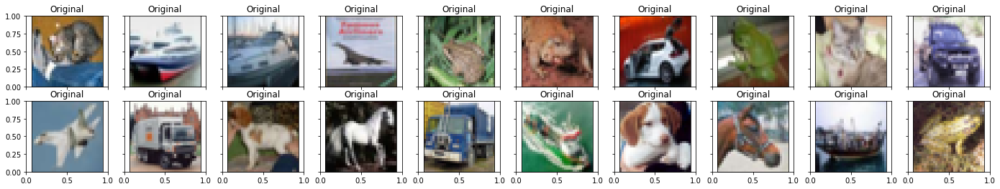

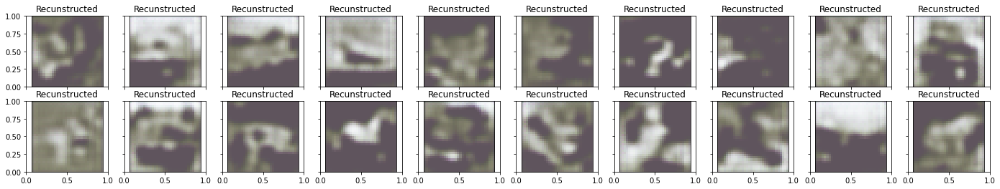


 EPOCH 34/150 	 train loss 0.5982831716537476 	 val loss 0.5975979566574097


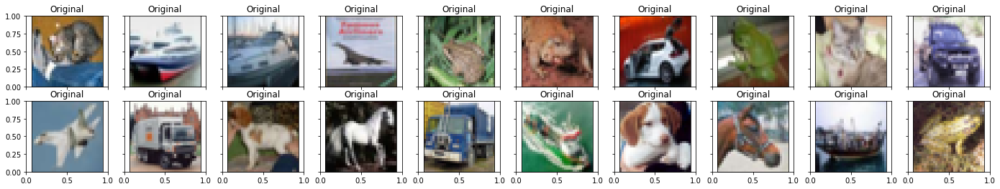

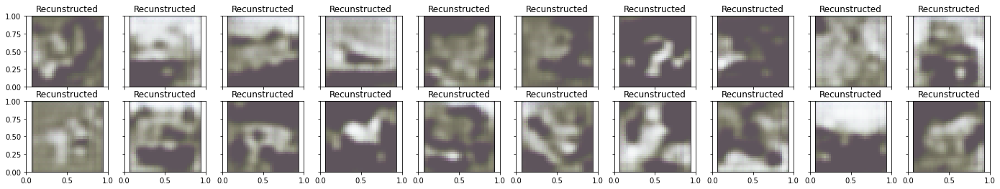


 EPOCH 35/150 	 train loss 0.5977540612220764 	 val loss 0.5974348783493042


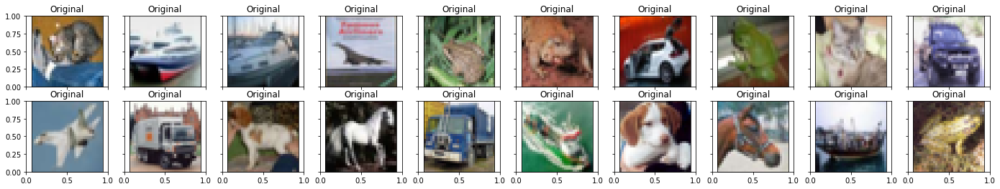

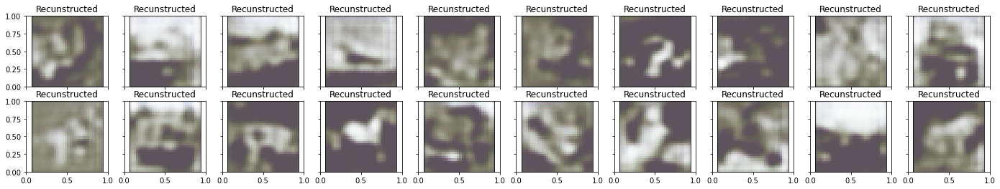


 EPOCH 36/150 	 train loss 0.5972638726234436 	 val loss 0.5974264740943909


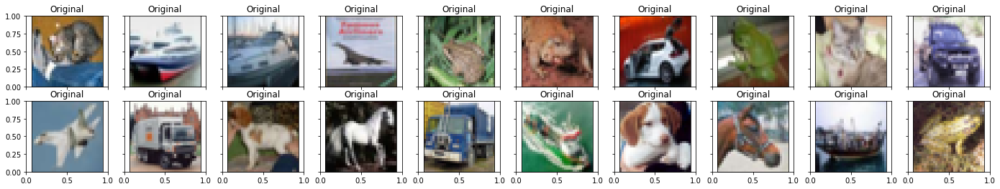

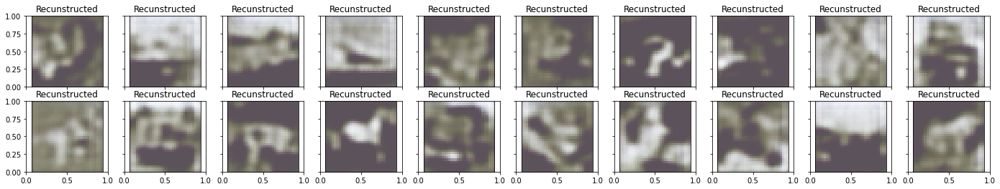


 EPOCH 37/150 	 train loss 0.5961045622825623 	 val loss 0.6034780144691467


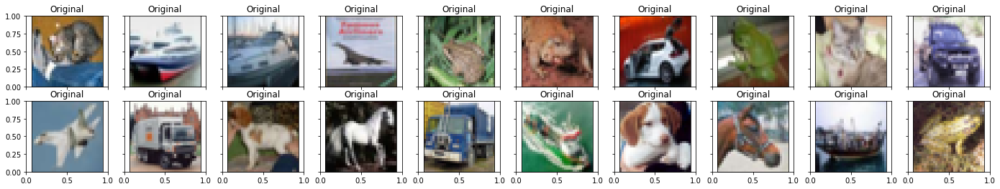

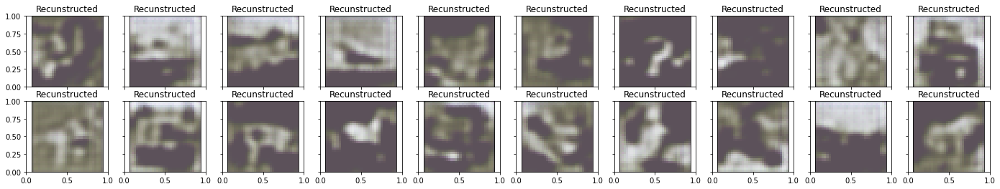


 EPOCH 38/150 	 train loss 0.5953112840652466 	 val loss 0.6009607911109924


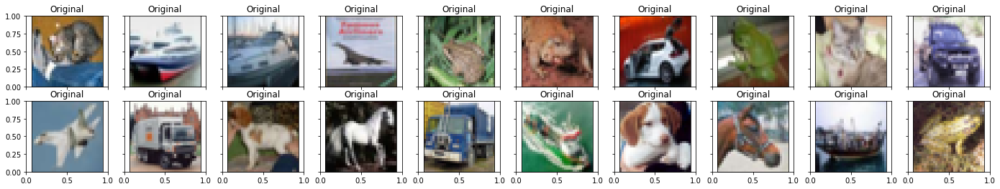

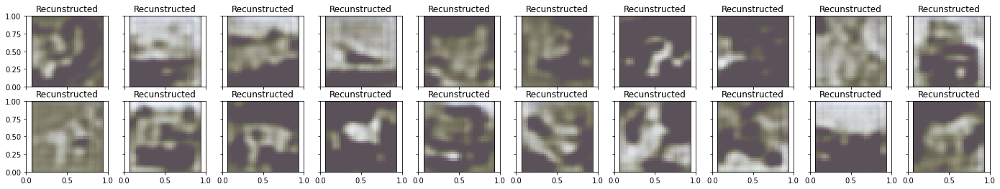


 EPOCH 39/150 	 train loss 0.5944550037384033 	 val loss 0.5946382284164429


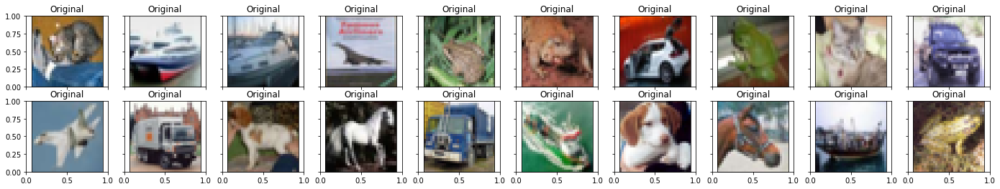

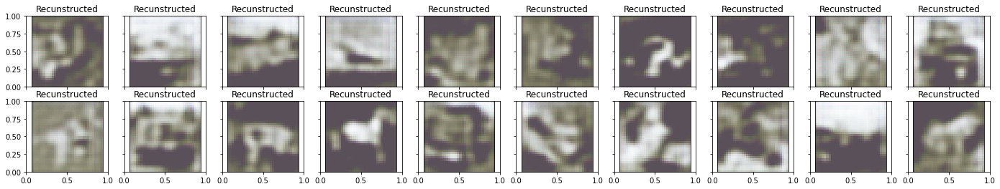


 EPOCH 40/150 	 train loss 0.5938414931297302 	 val loss 0.5940577983856201


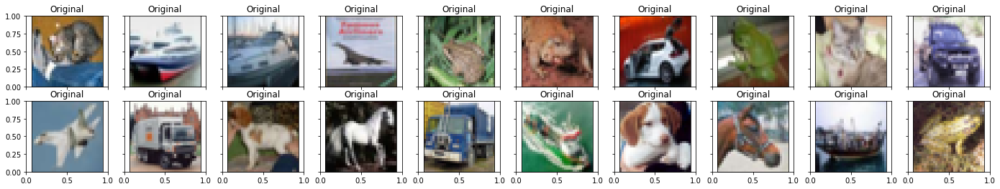

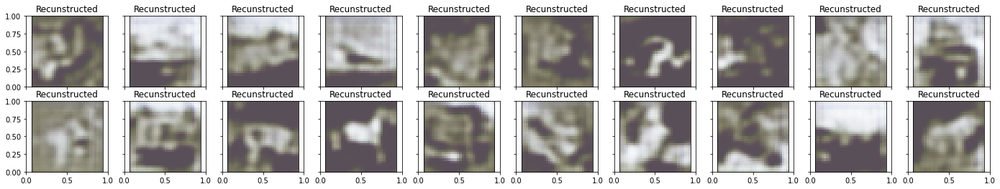


 EPOCH 41/150 	 train loss 0.5937387347221375 	 val loss 0.6006350517272949


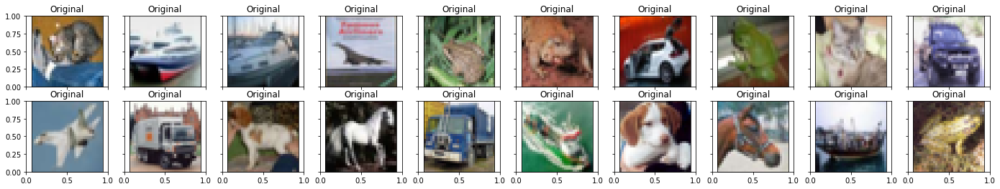

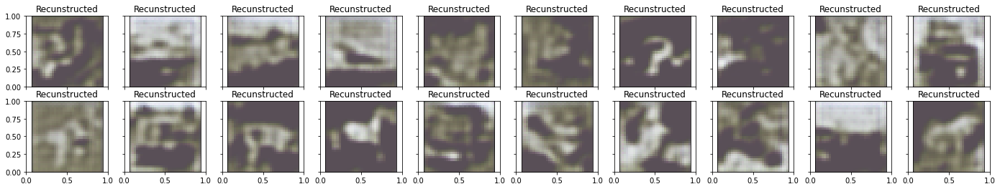


 EPOCH 42/150 	 train loss 0.5924264788627625 	 val loss 0.5965628623962402


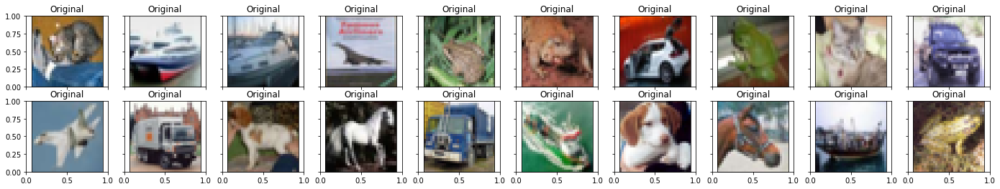

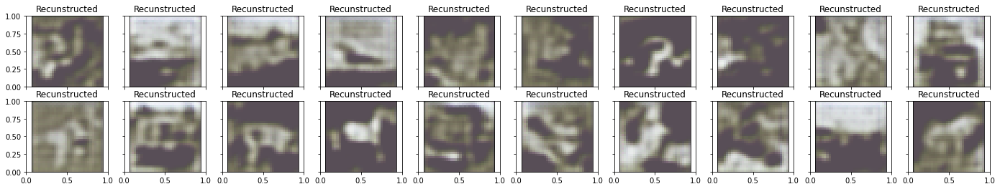


 EPOCH 43/150 	 train loss 0.5919417142868042 	 val loss 0.5913127660751343


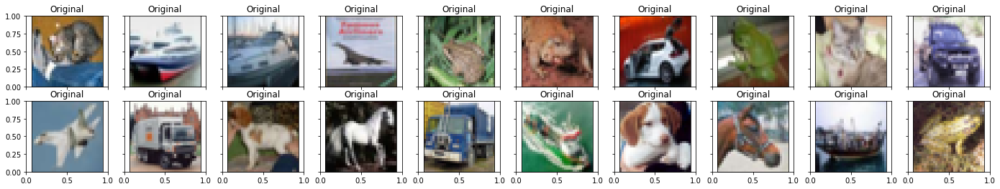

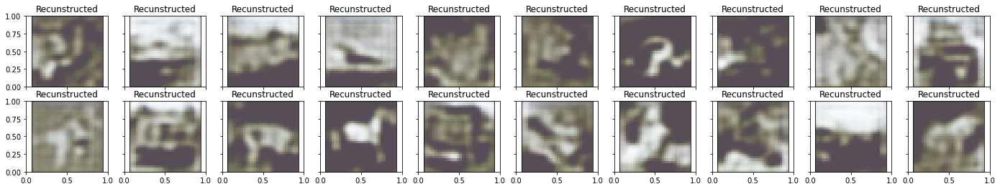


 EPOCH 44/150 	 train loss 0.5911205410957336 	 val loss 0.5912945866584778


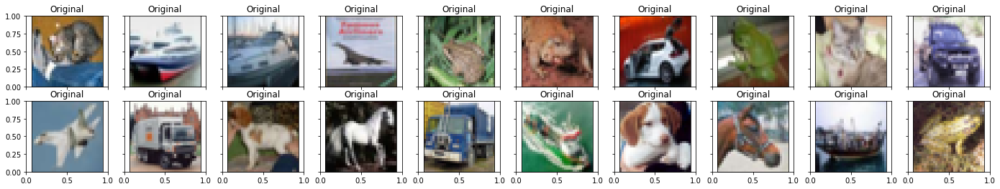

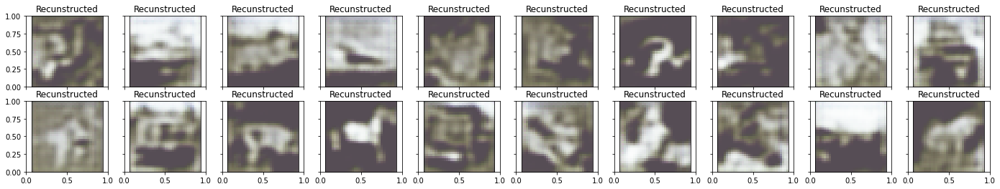


 EPOCH 45/150 	 train loss 0.5903220772743225 	 val loss 0.5902727842330933


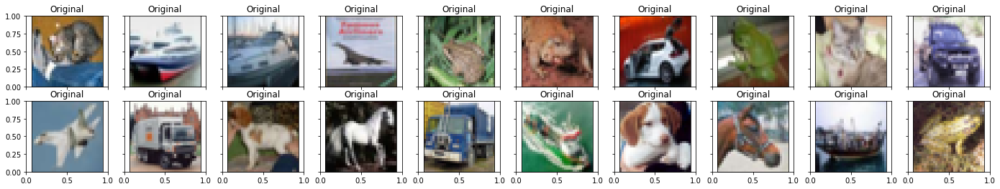

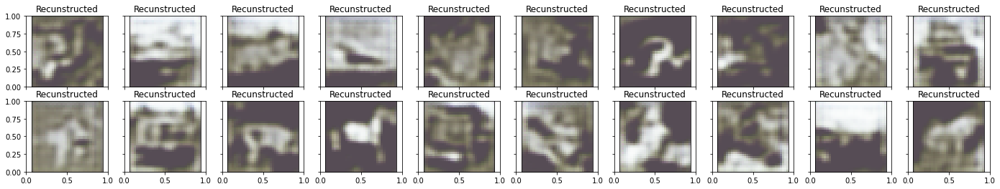


 EPOCH 46/150 	 train loss 0.5897852778434753 	 val loss 0.5917502641677856


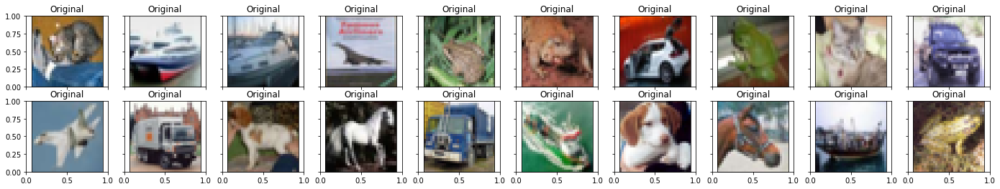

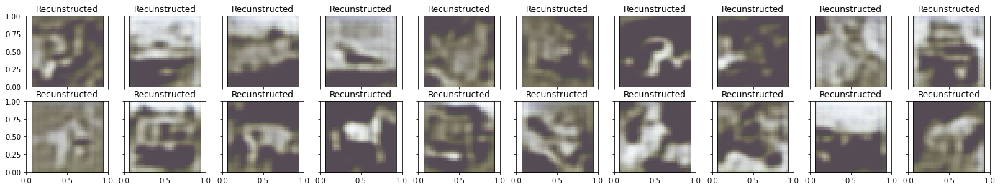


 EPOCH 47/150 	 train loss 0.5890424847602844 	 val loss 0.5951283574104309


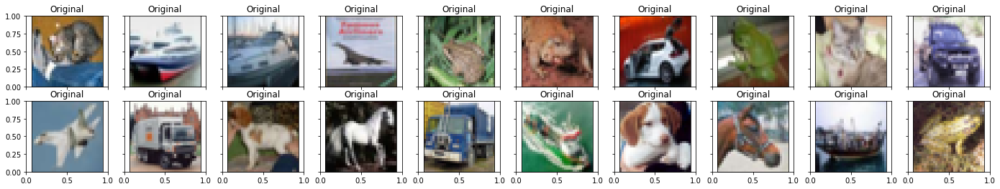

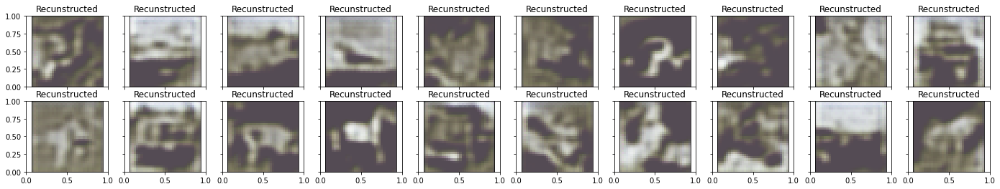


 EPOCH 48/150 	 train loss 0.5886133313179016 	 val loss 0.5954017639160156


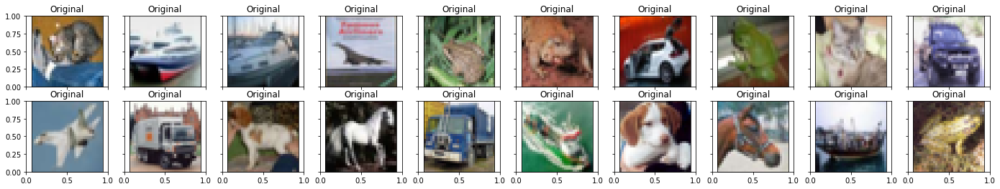

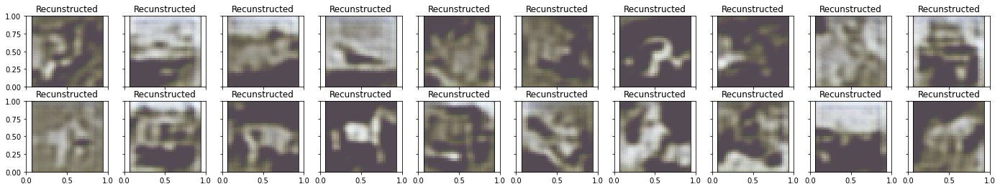


 EPOCH 49/150 	 train loss 0.5882673263549805 	 val loss 0.5912312269210815


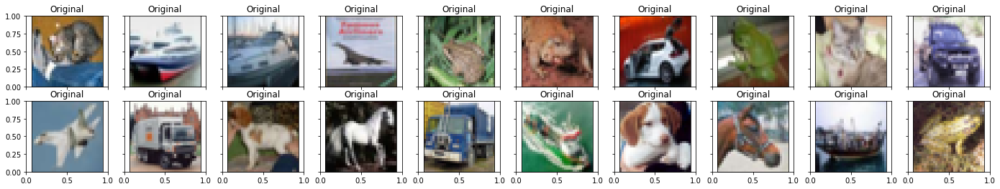

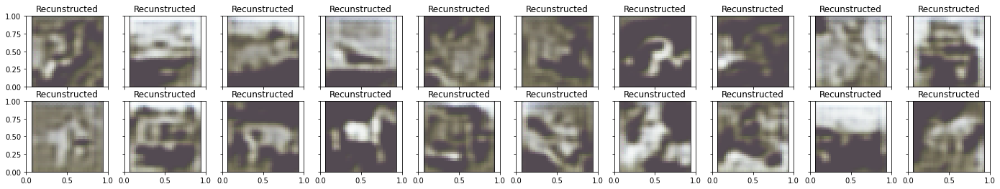


 EPOCH 50/150 	 train loss 0.588654100894928 	 val loss 0.5898041725158691


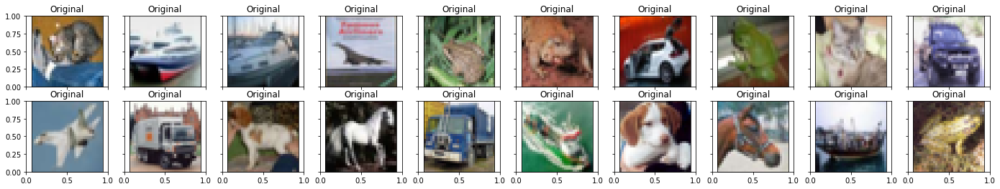

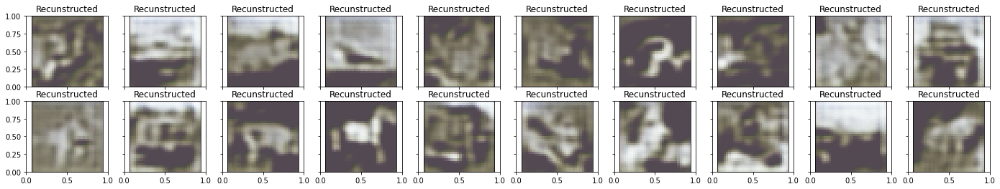


 EPOCH 51/150 	 train loss 0.5891992449760437 	 val loss 0.5941715240478516


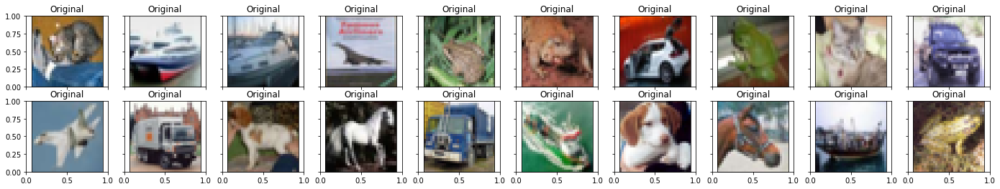

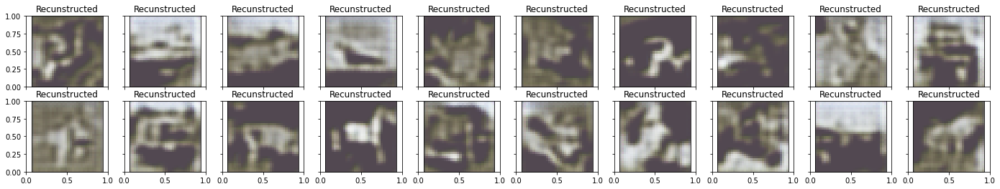


 EPOCH 52/150 	 train loss 0.588470458984375 	 val loss 0.5969794392585754


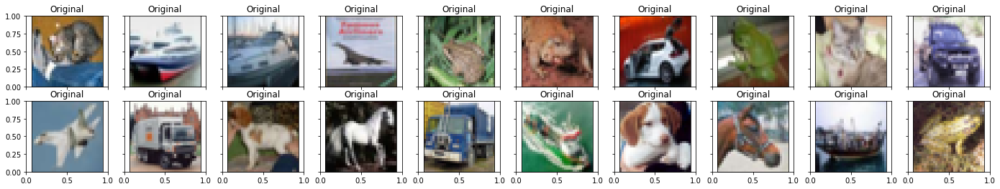

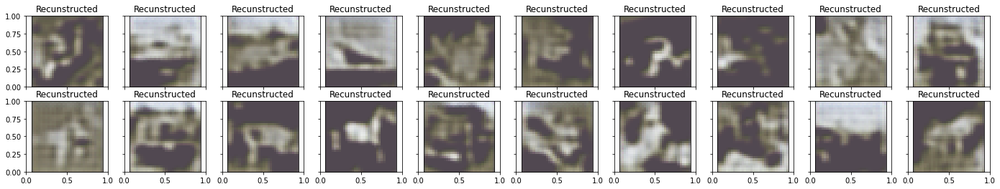


 EPOCH 53/150 	 train loss 0.5874366164207458 	 val loss 0.5960164070129395


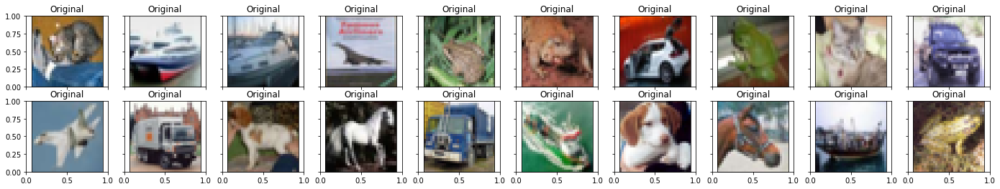

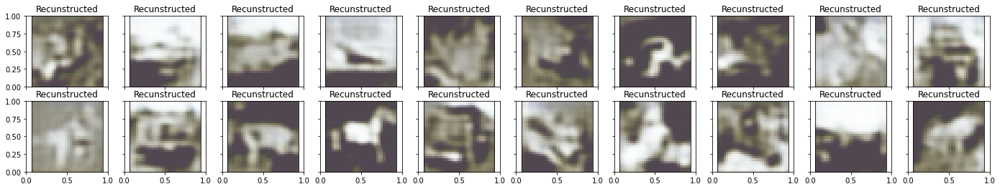


 EPOCH 54/150 	 train loss 0.5867077708244324 	 val loss 0.5871930122375488


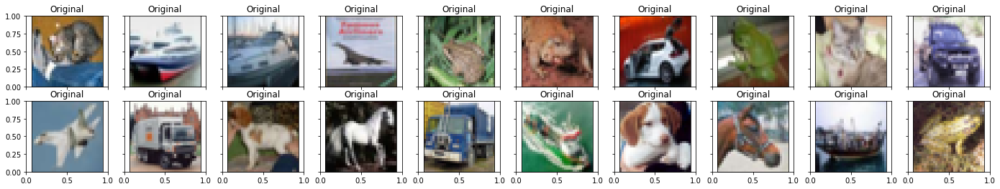

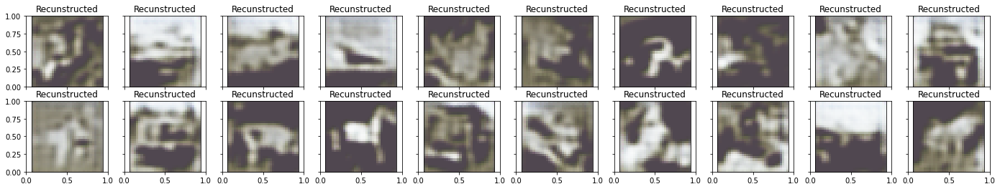


 EPOCH 55/150 	 train loss 0.5860618948936462 	 val loss 0.5866484642028809


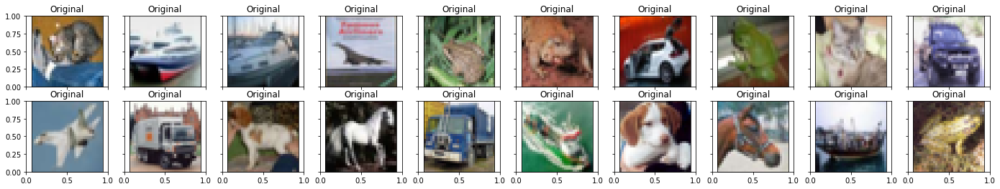

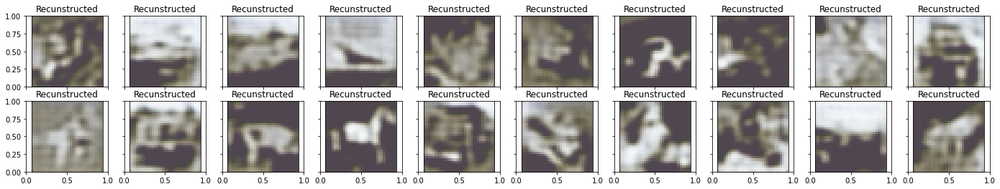


 EPOCH 56/150 	 train loss 0.5854102969169617 	 val loss 0.5924550890922546


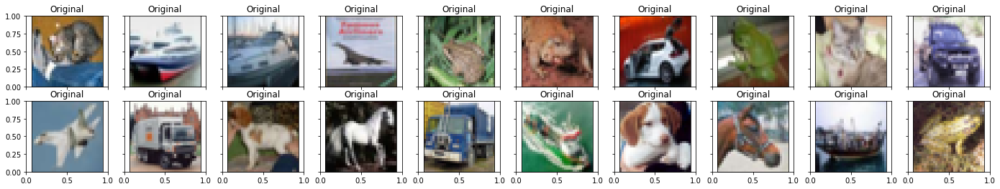

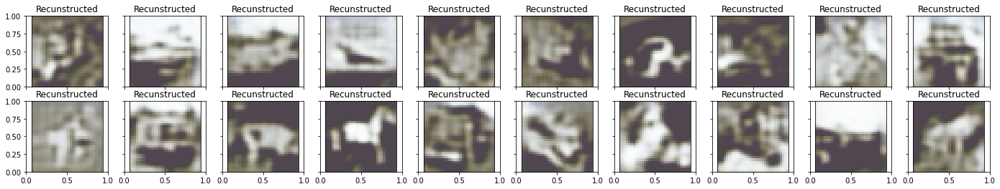


 EPOCH 57/150 	 train loss 0.5850202441215515 	 val loss 0.5854477286338806


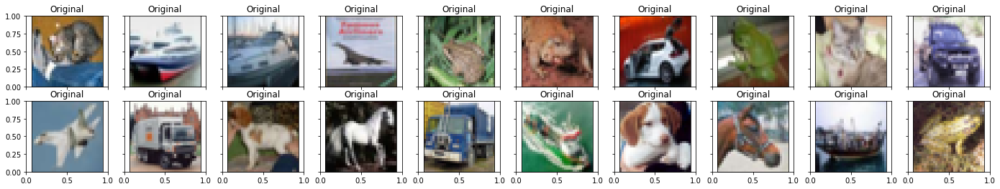

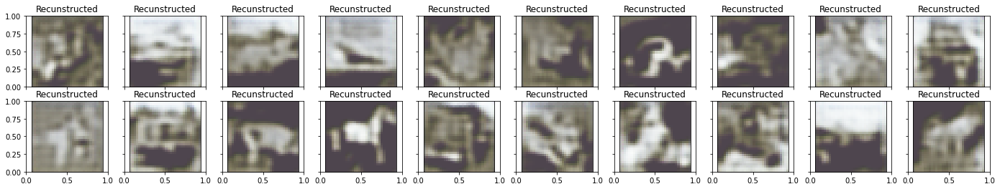


 EPOCH 58/150 	 train loss 0.5846367478370667 	 val loss 0.5847358703613281


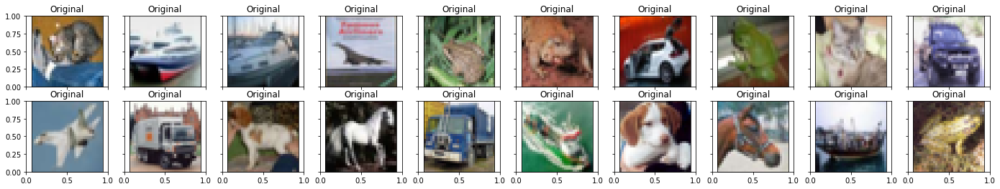

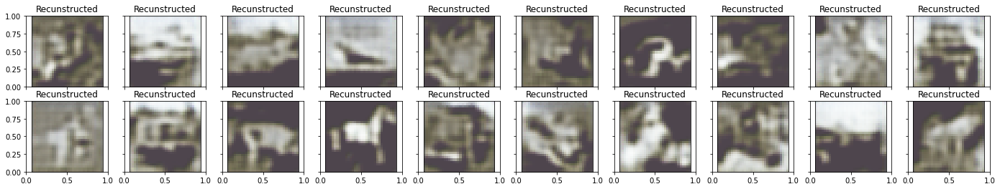


 EPOCH 59/150 	 train loss 0.584078311920166 	 val loss 0.5863036513328552


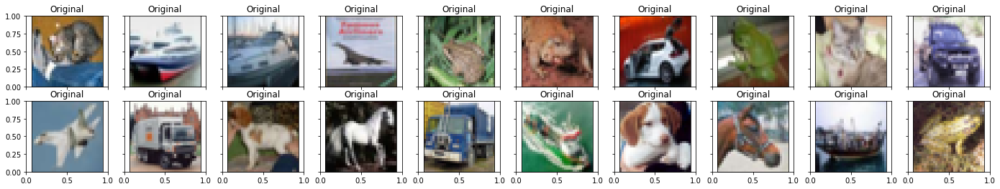

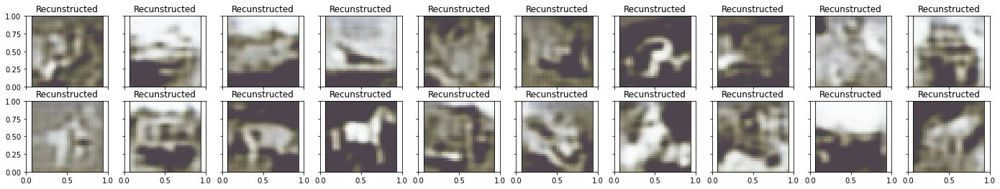


 EPOCH 60/150 	 train loss 0.5835974812507629 	 val loss 0.5844430923461914


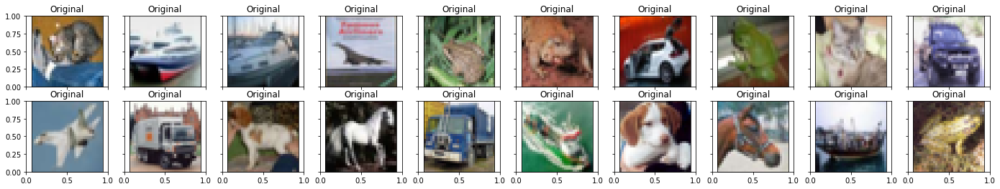

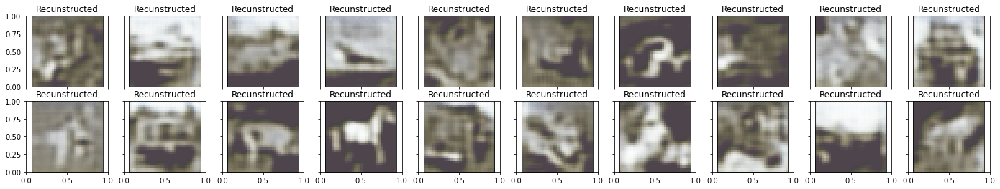


 EPOCH 61/150 	 train loss 0.5832452774047852 	 val loss 0.584343671798706


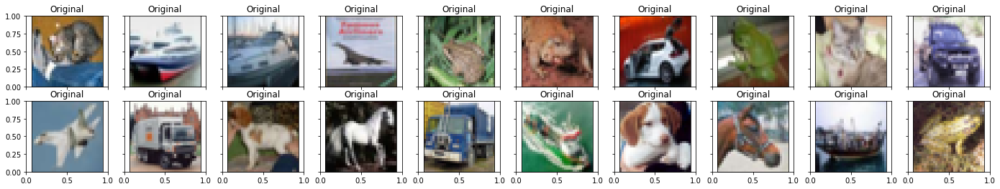

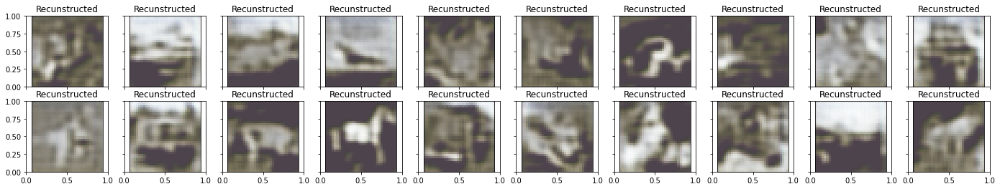


 EPOCH 62/150 	 train loss 0.5830830931663513 	 val loss 0.5845165252685547


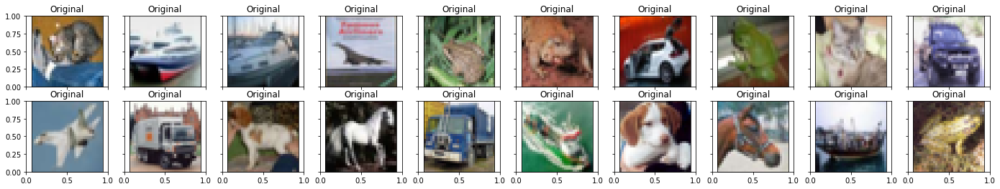

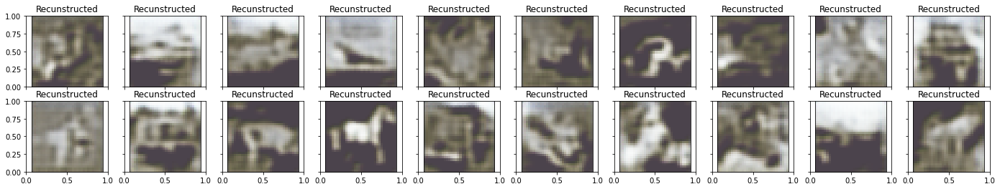


 EPOCH 63/150 	 train loss 0.5833754539489746 	 val loss 0.5837105512619019


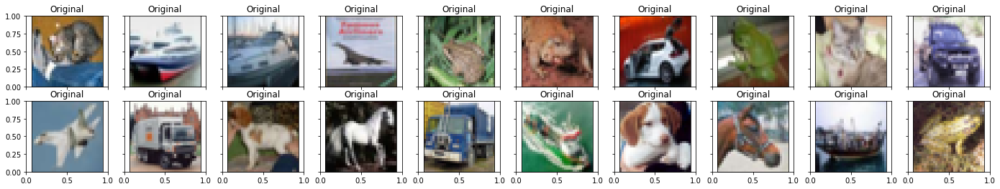

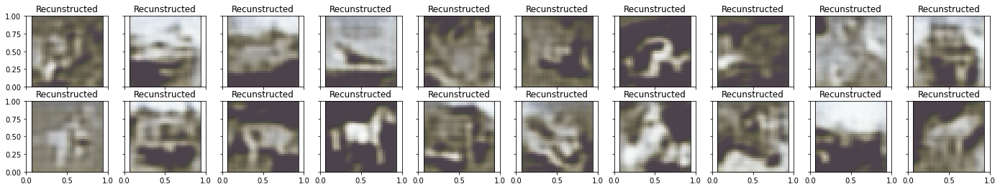


 EPOCH 64/150 	 train loss 0.5825545191764832 	 val loss 0.5842900276184082


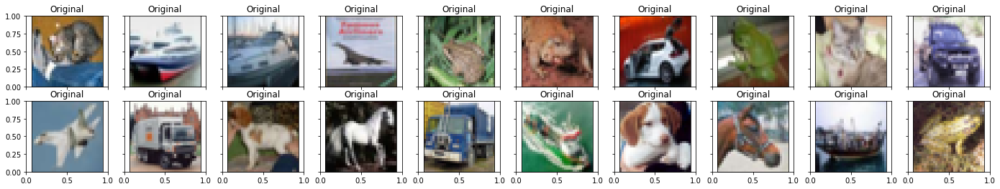

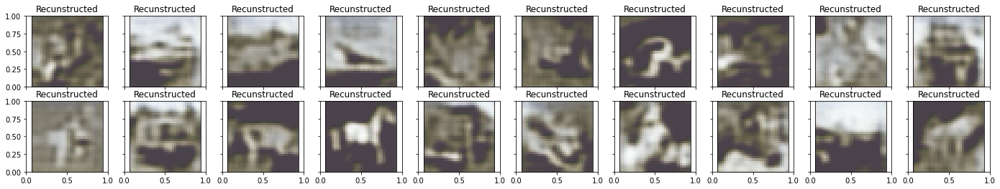


 EPOCH 65/150 	 train loss 0.5823197960853577 	 val loss 0.5847058296203613


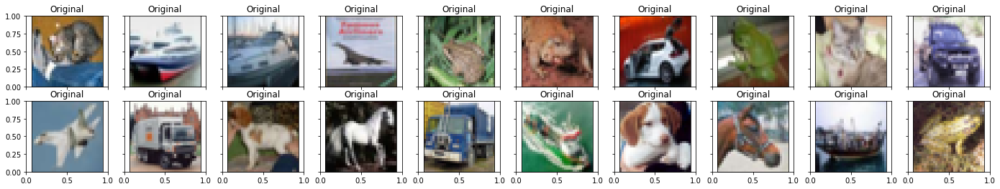

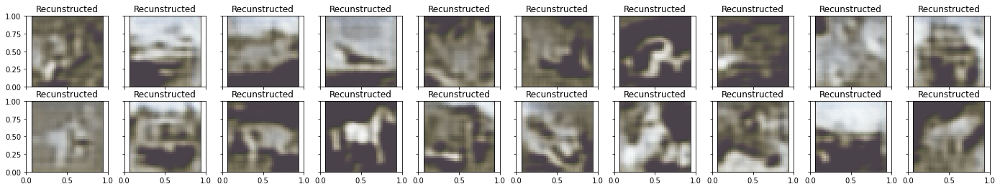


 EPOCH 66/150 	 train loss 0.5817642211914062 	 val loss 0.5838121175765991


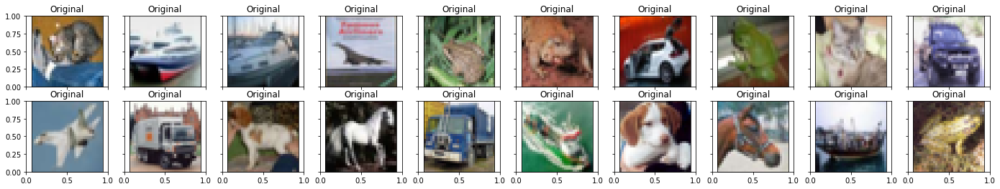

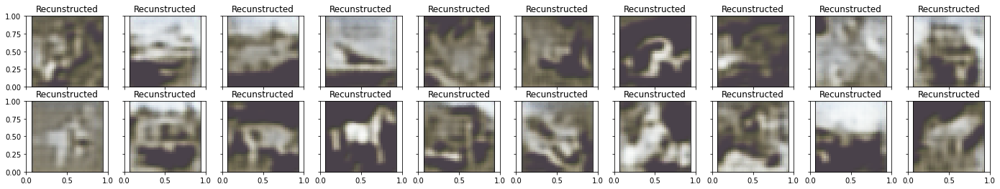


 EPOCH 67/150 	 train loss 0.5815626978874207 	 val loss 0.5843292474746704


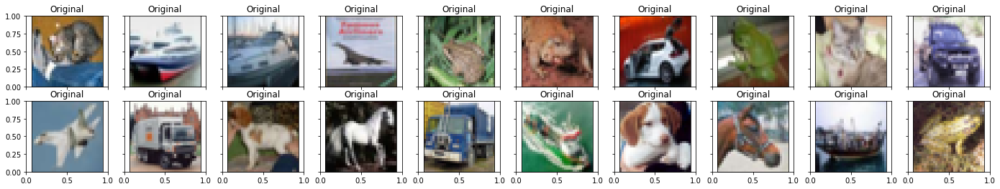

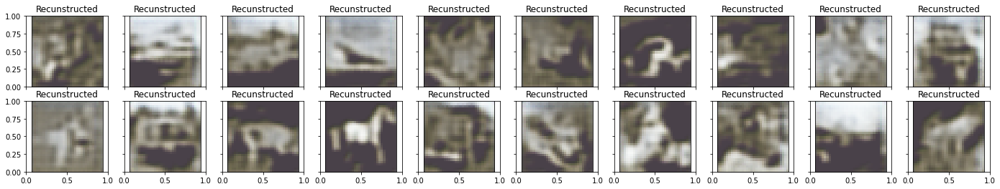


 EPOCH 68/150 	 train loss 0.5809471011161804 	 val loss 0.5842825770378113


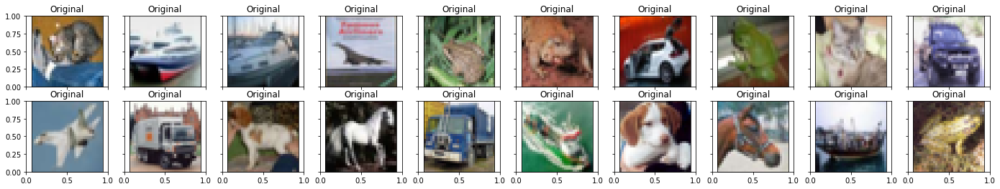

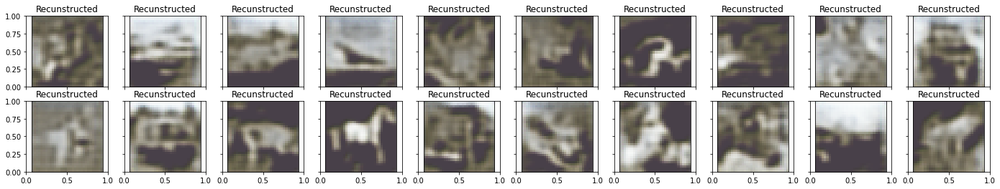


 EPOCH 69/150 	 train loss 0.5808748006820679 	 val loss 0.5880259275436401


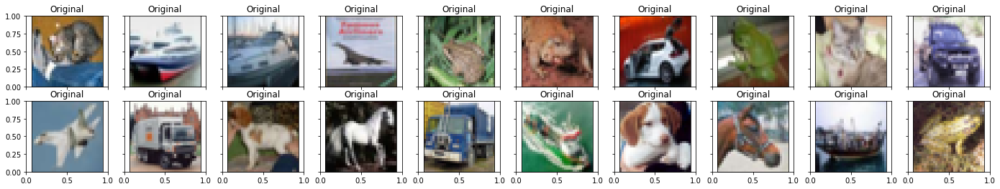

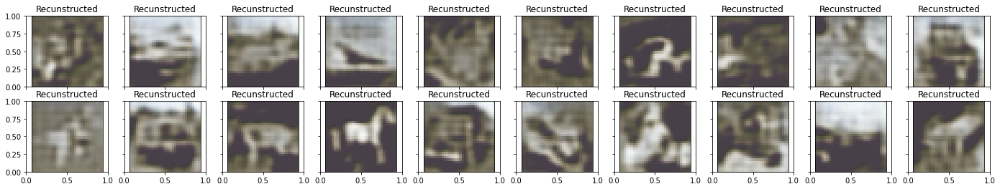


 EPOCH 70/150 	 train loss 0.5818344950675964 	 val loss 0.5833528637886047


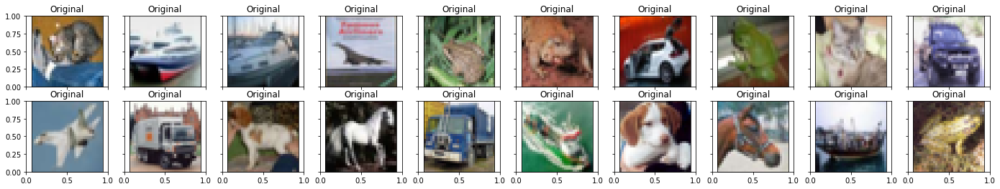

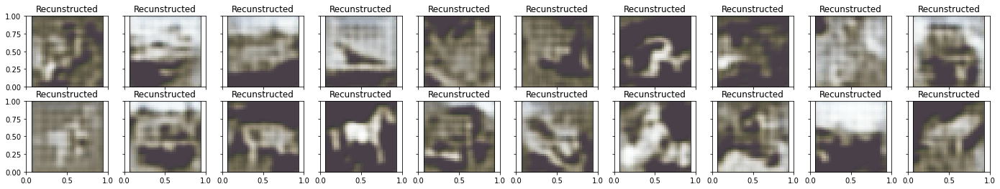


 EPOCH 71/150 	 train loss 0.5810139775276184 	 val loss 0.581528902053833


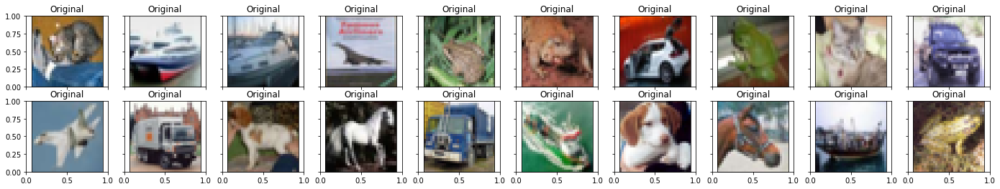

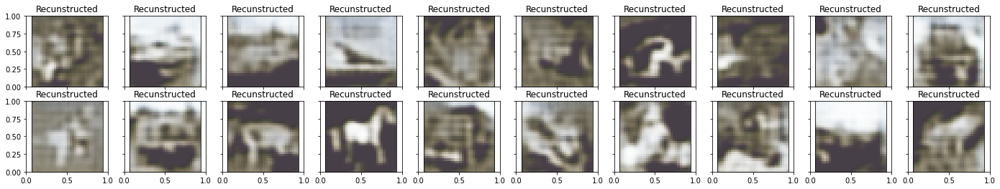


 EPOCH 72/150 	 train loss 0.5809665322303772 	 val loss 0.5812281966209412


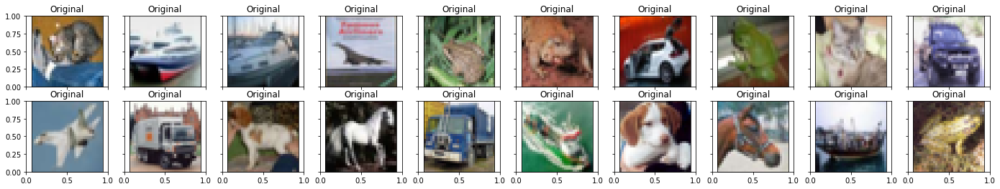

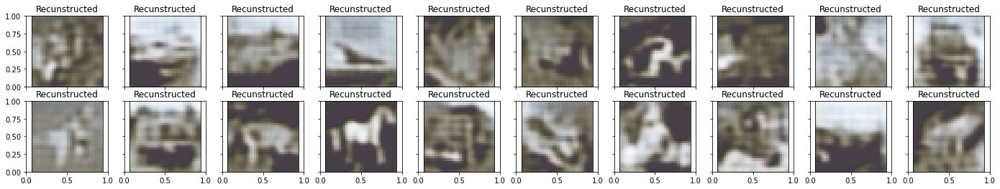


 EPOCH 73/150 	 train loss 0.5804957747459412 	 val loss 0.5903899669647217


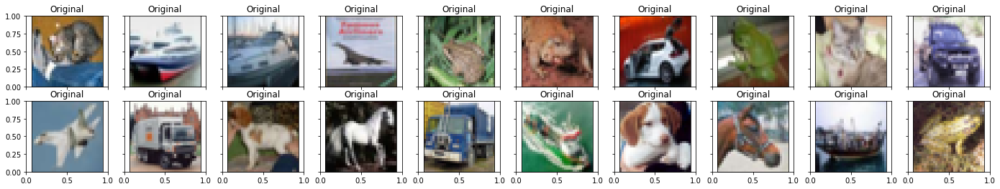

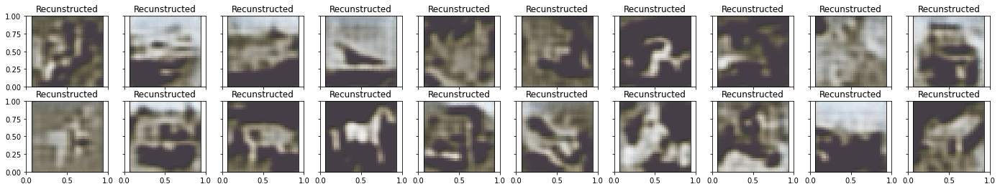


 EPOCH 74/150 	 train loss 0.5798344612121582 	 val loss 0.5854676365852356


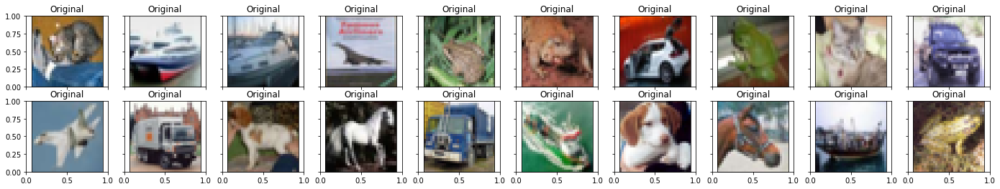

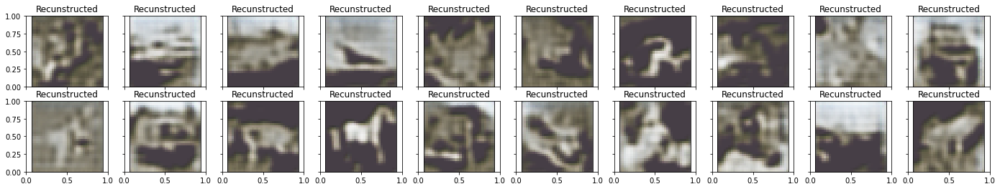


 EPOCH 75/150 	 train loss 0.5794025659561157 	 val loss 0.5803083181381226


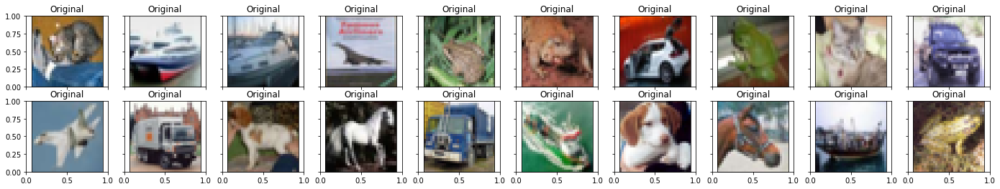

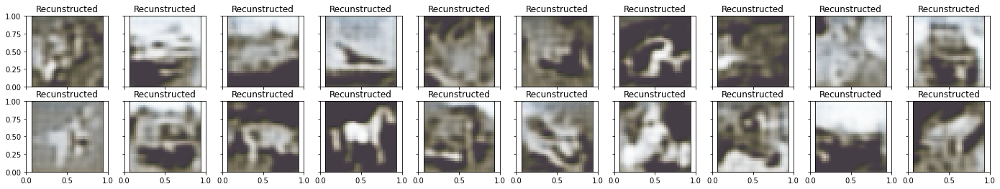


 EPOCH 76/150 	 train loss 0.5789381861686707 	 val loss 0.584494411945343


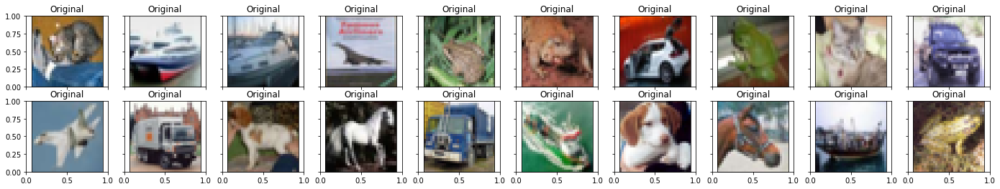

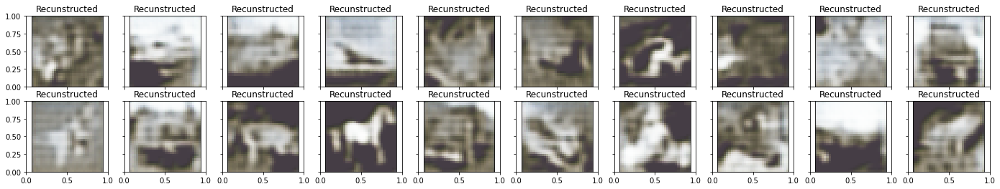


 EPOCH 77/150 	 train loss 0.5784700512886047 	 val loss 0.581373393535614


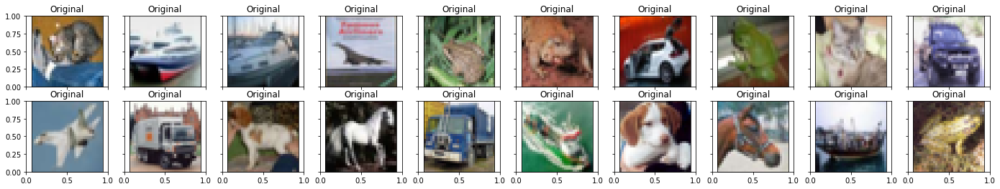

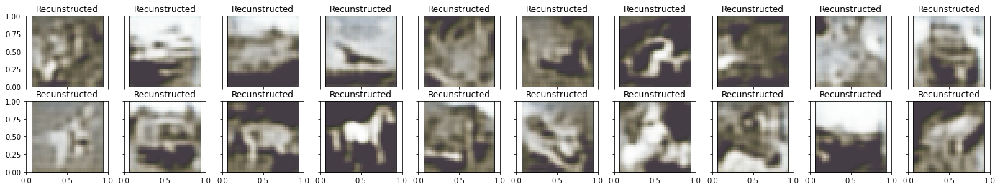


 EPOCH 78/150 	 train loss 0.5786179900169373 	 val loss 0.5791367292404175


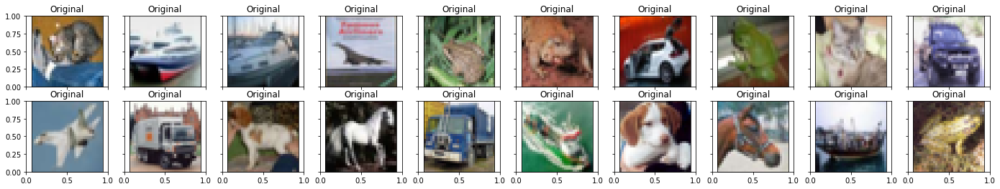

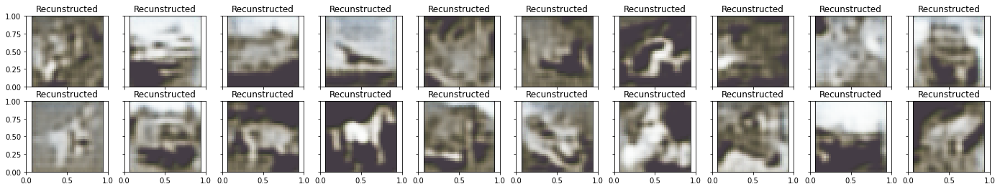


 EPOCH 79/150 	 train loss 0.5780255198478699 	 val loss 0.5789687037467957


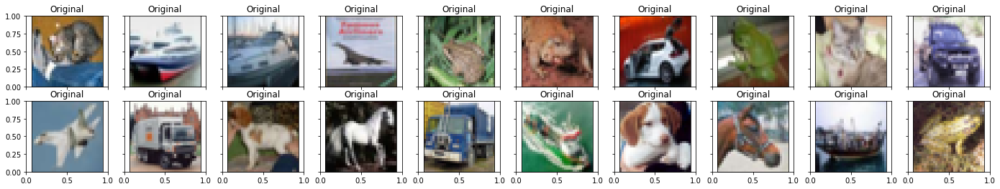

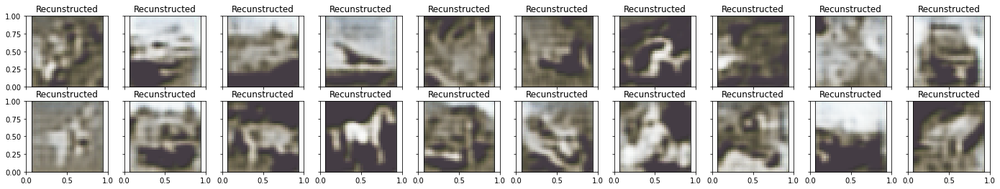


 EPOCH 80/150 	 train loss 0.5777077078819275 	 val loss 0.5798764228820801


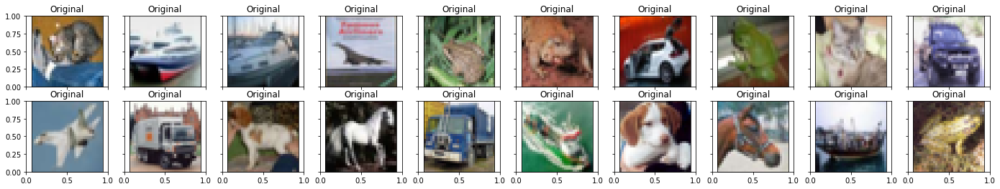

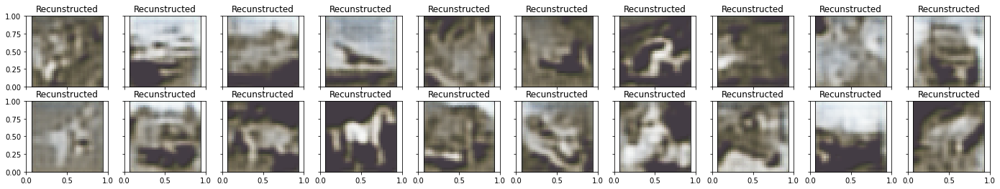


 EPOCH 81/150 	 train loss 0.577462375164032 	 val loss 0.5792524814605713


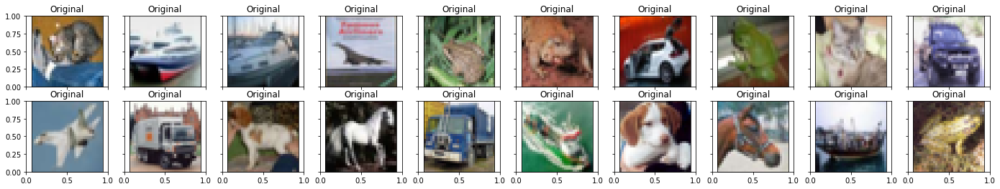

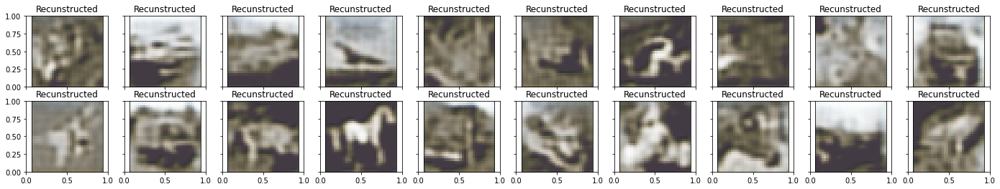


 EPOCH 82/150 	 train loss 0.5789105296134949 	 val loss 0.5788199305534363


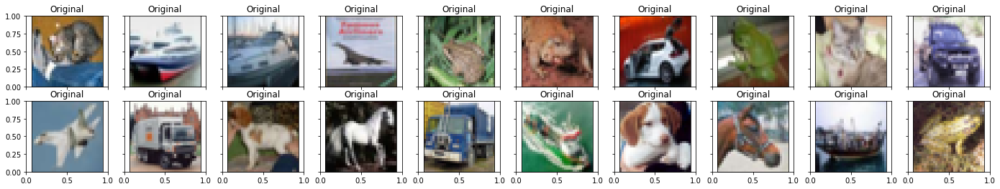

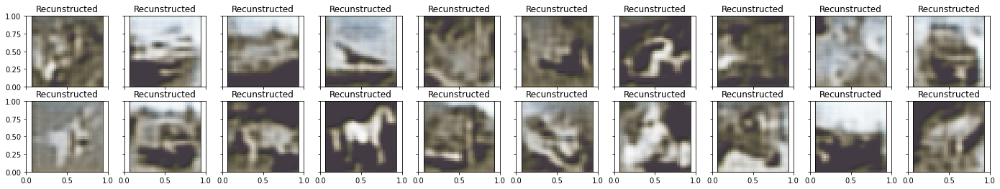


 EPOCH 83/150 	 train loss 0.5781686902046204 	 val loss 0.5819181203842163


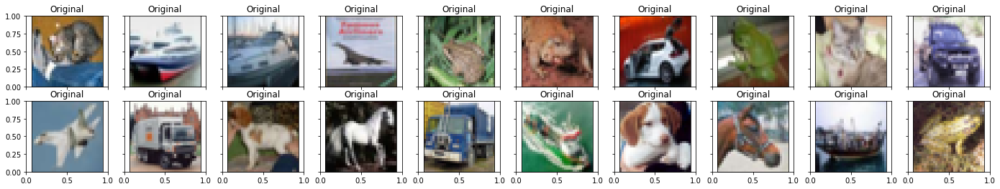

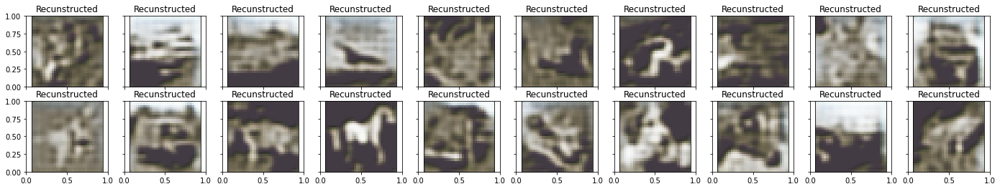


 EPOCH 84/150 	 train loss 0.5781962871551514 	 val loss 0.5804156064987183


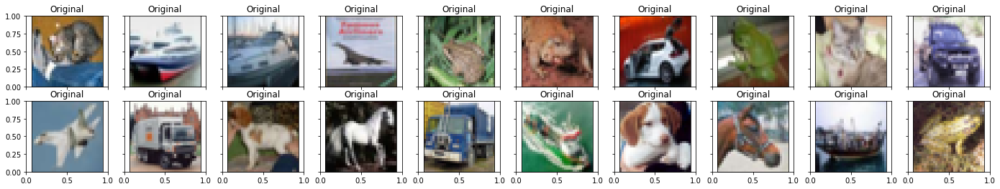

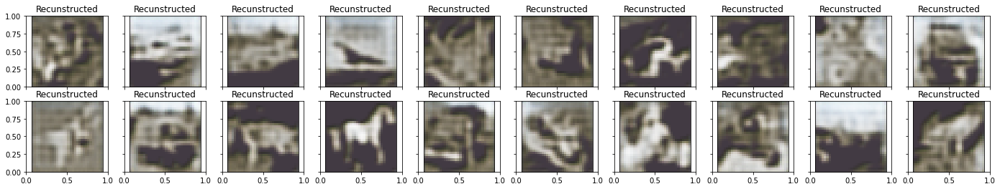


 EPOCH 85/150 	 train loss 0.5776720643043518 	 val loss 0.5803398489952087


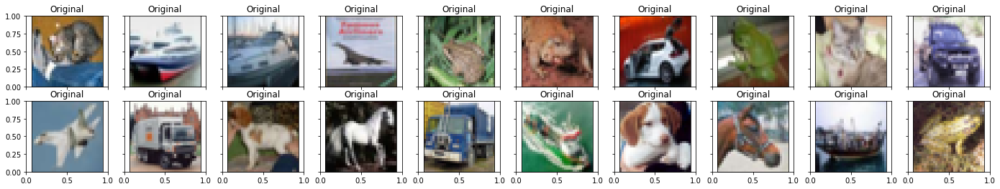

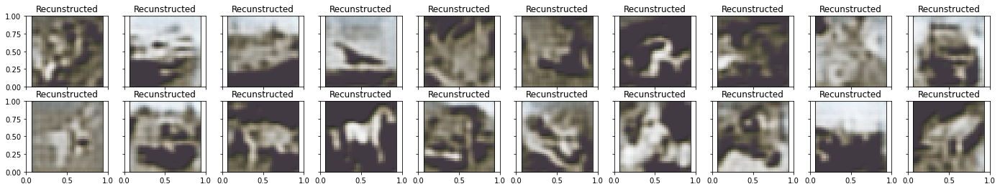


 EPOCH 86/150 	 train loss 0.5769959092140198 	 val loss 0.5782718658447266


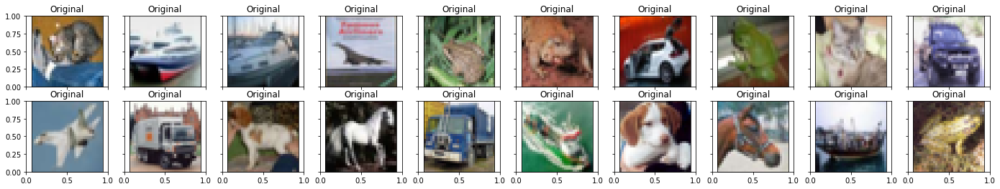

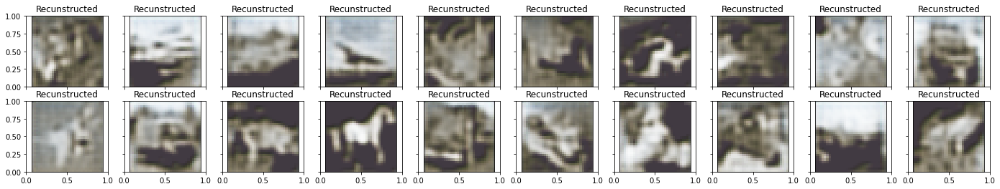


 EPOCH 87/150 	 train loss 0.5766420960426331 	 val loss 0.579067587852478


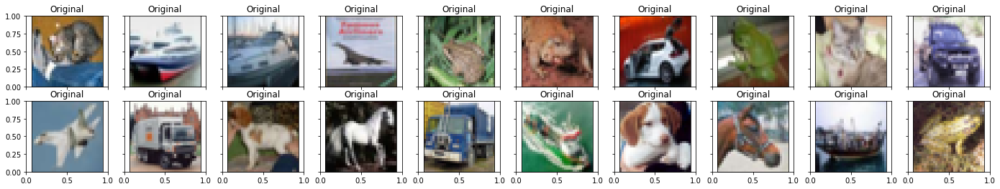

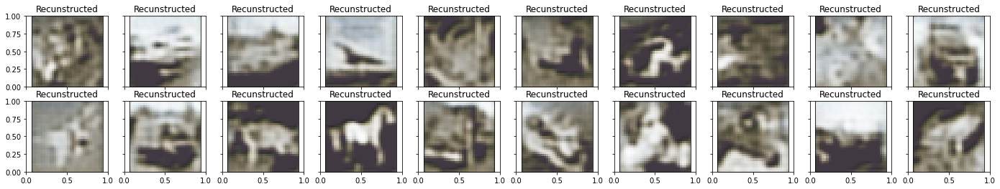


 EPOCH 88/150 	 train loss 0.5763548612594604 	 val loss 0.5772005915641785


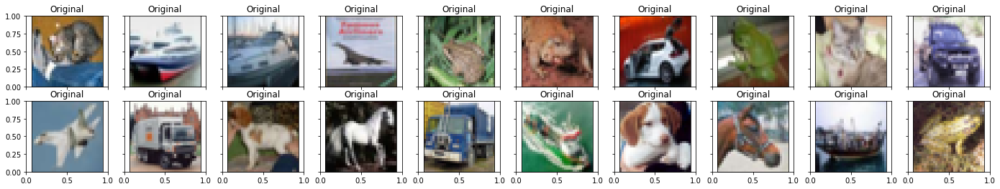

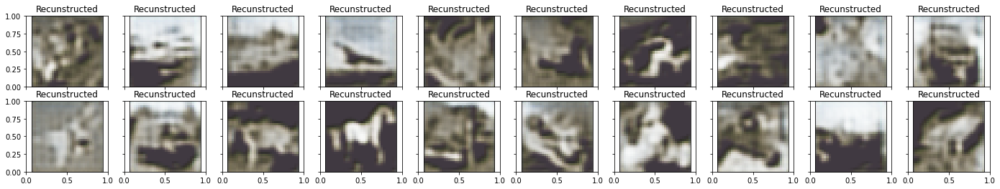


 EPOCH 89/150 	 train loss 0.5761705040931702 	 val loss 0.5771632790565491


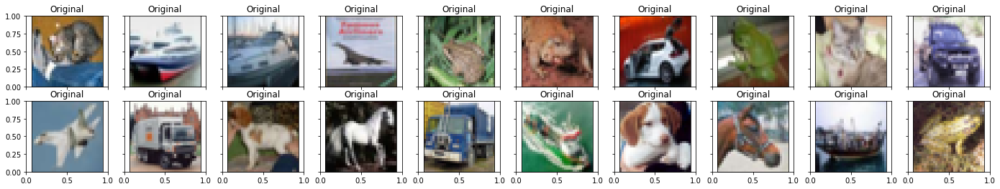

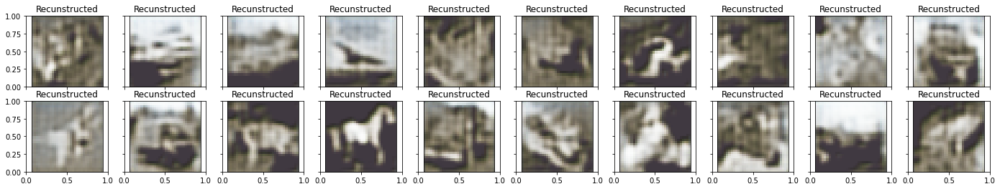


 EPOCH 90/150 	 train loss 0.5756703019142151 	 val loss 0.577092170715332


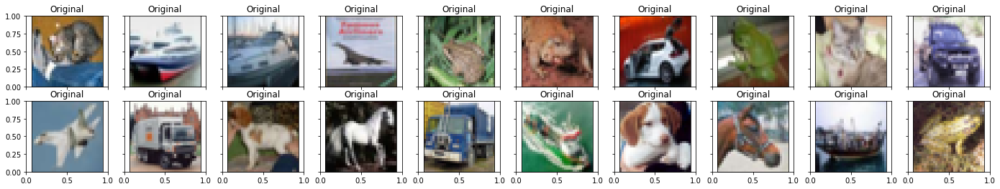

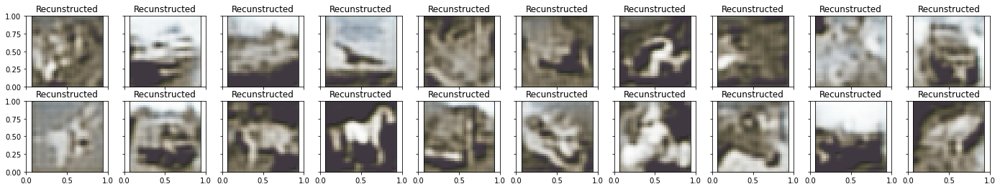


 EPOCH 91/150 	 train loss 0.5754726529121399 	 val loss 0.5757541656494141


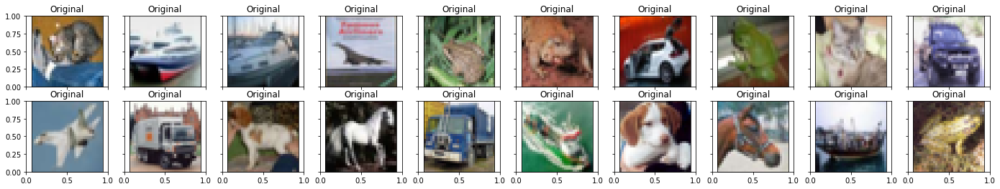

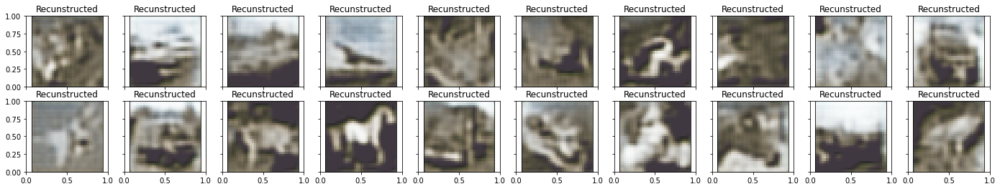


 EPOCH 92/150 	 train loss 0.5753061771392822 	 val loss 0.5766028761863708


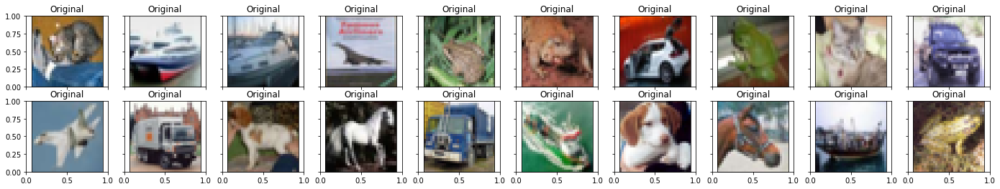

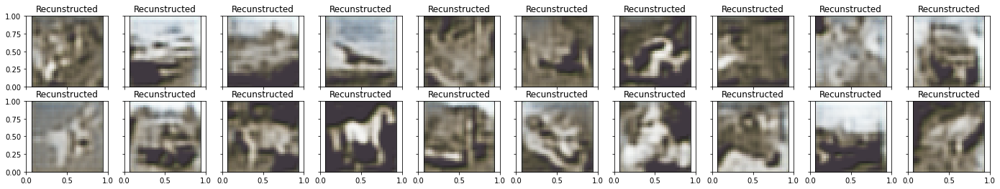


 EPOCH 93/150 	 train loss 0.5750770568847656 	 val loss 0.5761574506759644


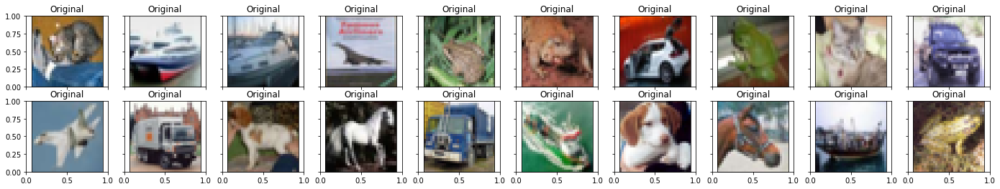

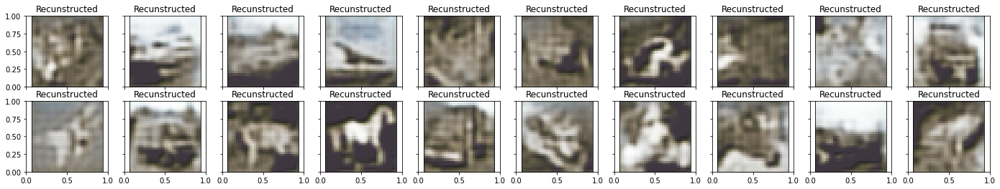


 EPOCH 94/150 	 train loss 0.5751363635063171 	 val loss 0.5779819488525391


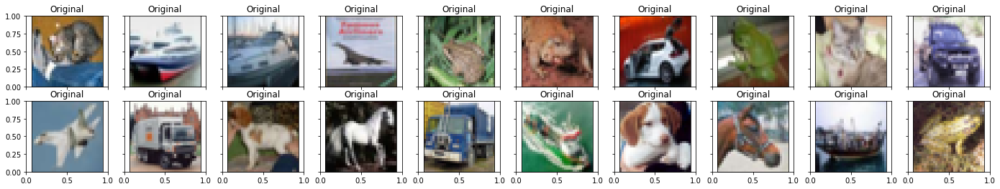

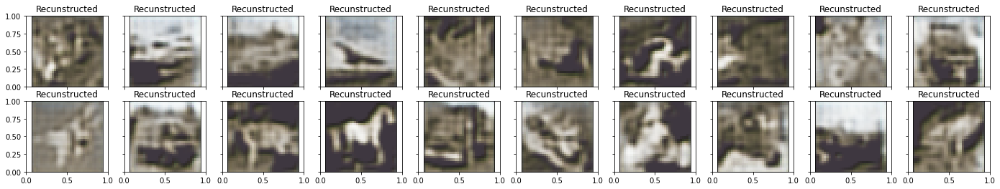


 EPOCH 95/150 	 train loss 0.5744142532348633 	 val loss 0.5751717686653137


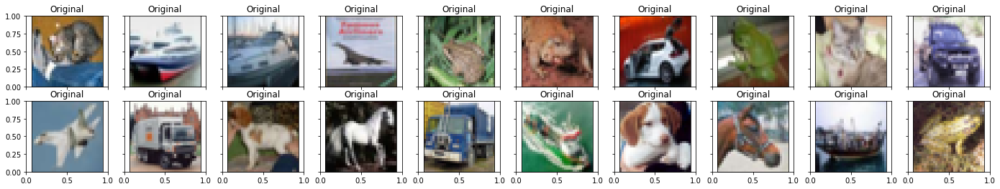

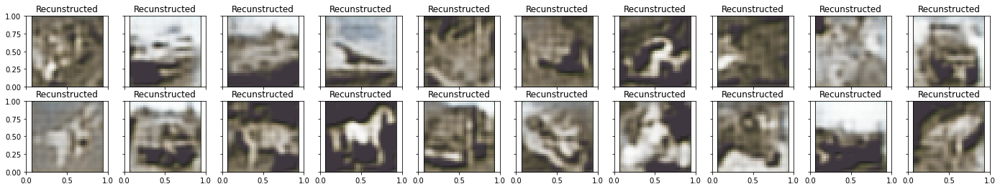


 EPOCH 96/150 	 train loss 0.5741819739341736 	 val loss 0.5752403736114502


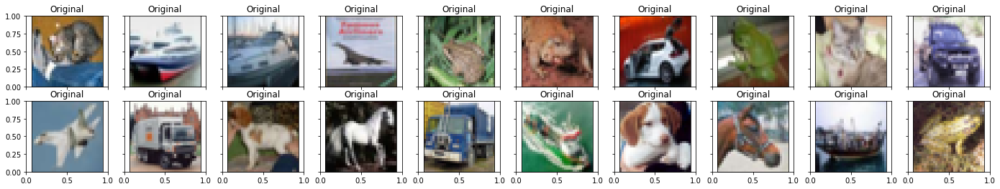

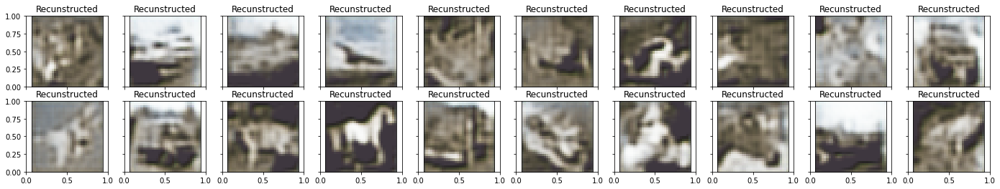


 EPOCH 97/150 	 train loss 0.573899507522583 	 val loss 0.5755640268325806


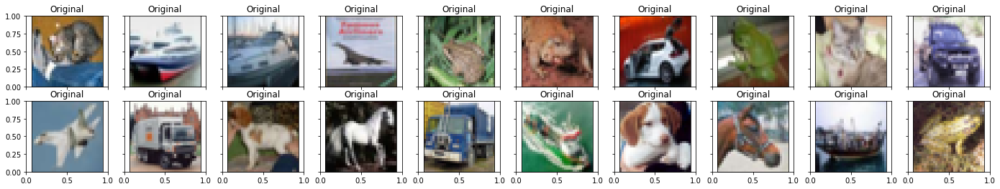

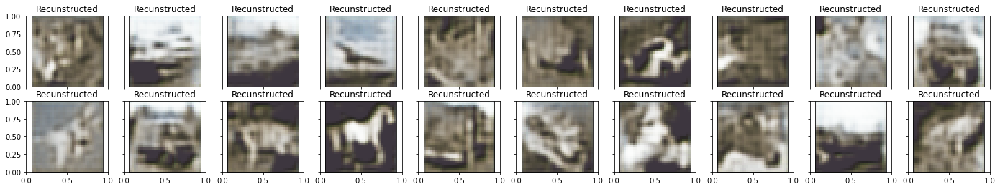


 EPOCH 98/150 	 train loss 0.5735994577407837 	 val loss 0.5748013854026794


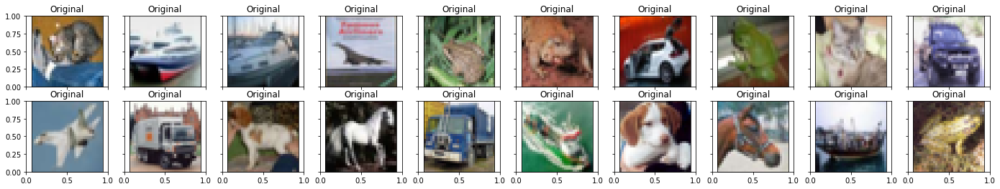

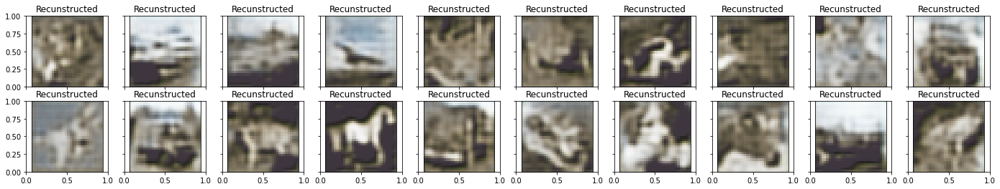


 EPOCH 99/150 	 train loss 0.573047935962677 	 val loss 0.5970334410667419


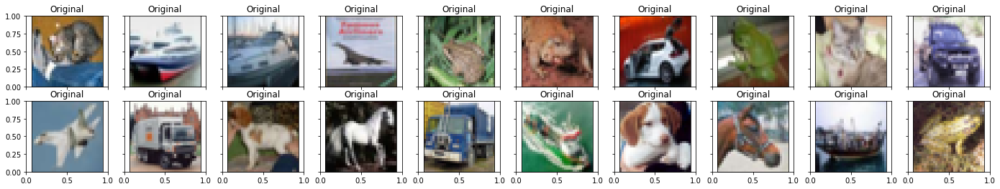

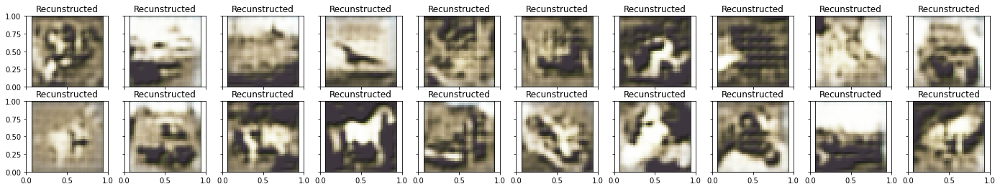


 EPOCH 100/150 	 train loss 0.5731170177459717 	 val loss 0.5940385460853577


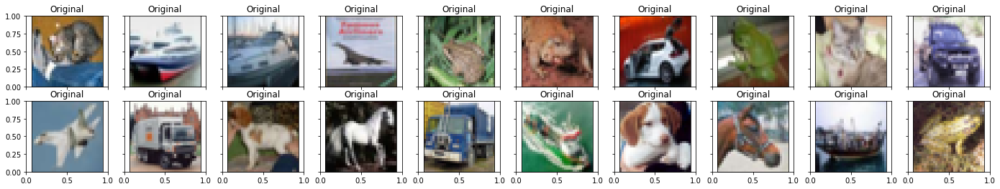

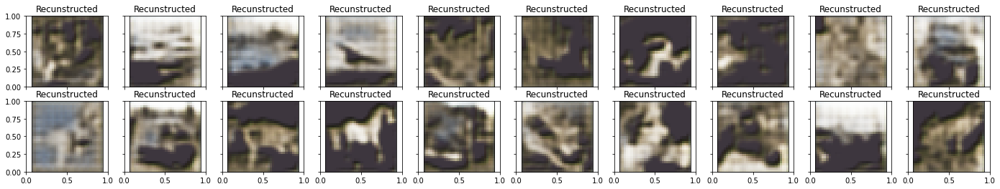


 EPOCH 101/150 	 train loss 0.5808116793632507 	 val loss 0.8452936410903931


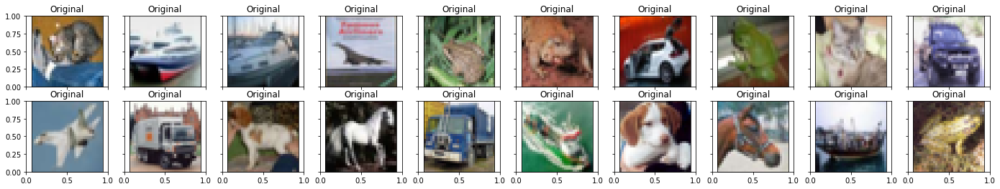

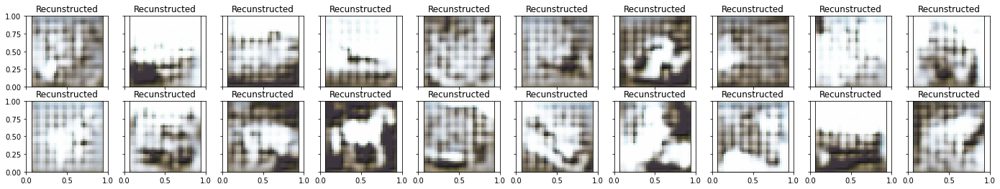


 EPOCH 102/150 	 train loss 0.5784426331520081 	 val loss 0.604267418384552


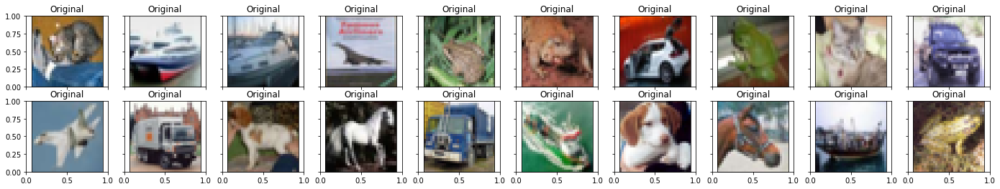

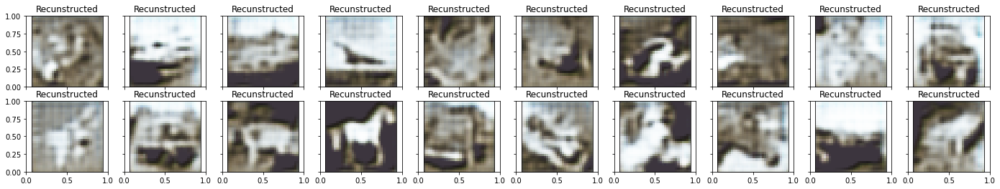


 EPOCH 103/150 	 train loss 0.5777311325073242 	 val loss 0.6510891914367676


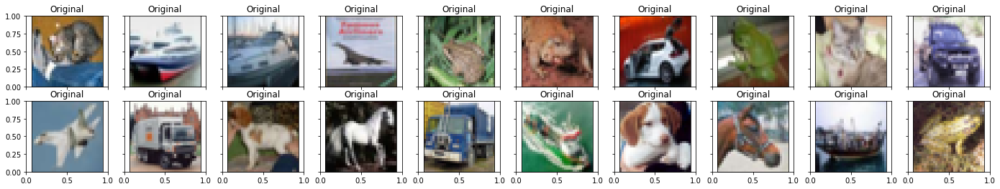

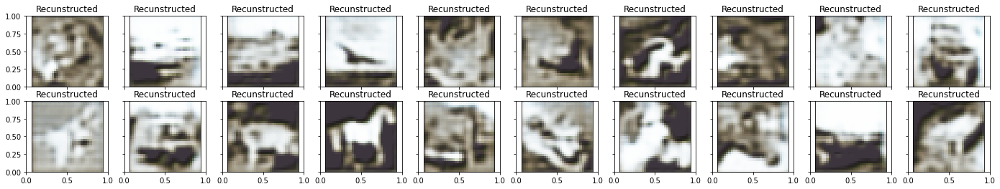


 EPOCH 104/150 	 train loss 0.5763094425201416 	 val loss 0.6758636236190796


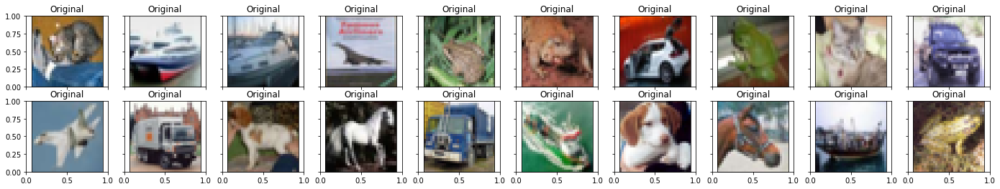

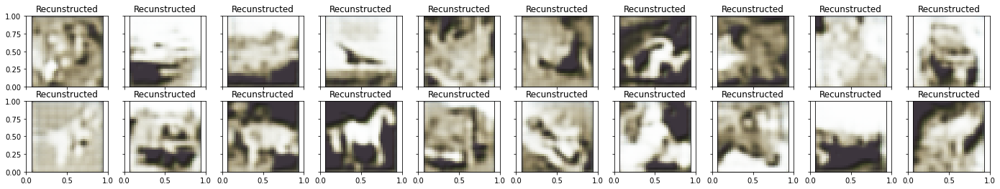


 EPOCH 105/150 	 train loss 0.5757043361663818 	 val loss 0.7085046172142029


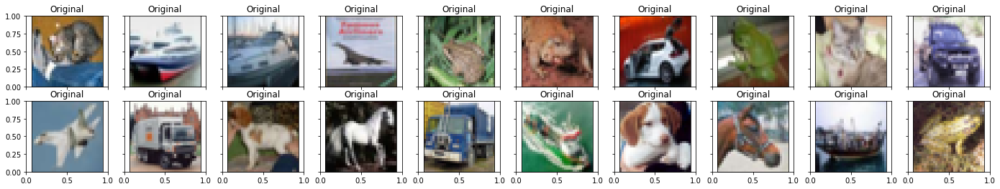

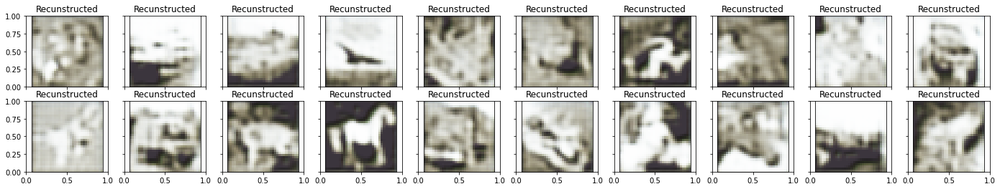


 EPOCH 106/150 	 train loss 0.5749452114105225 	 val loss 0.7473974823951721


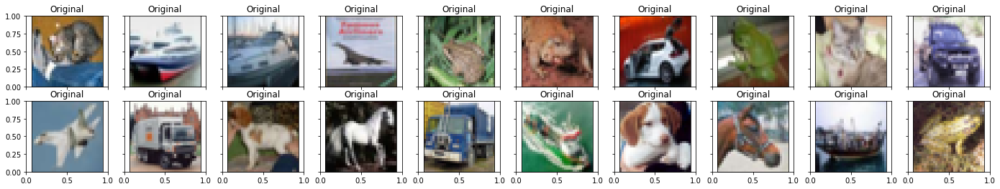

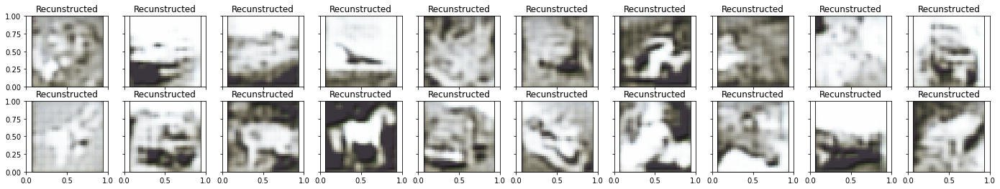


 EPOCH 107/150 	 train loss 0.5742591023445129 	 val loss 0.7212971448898315


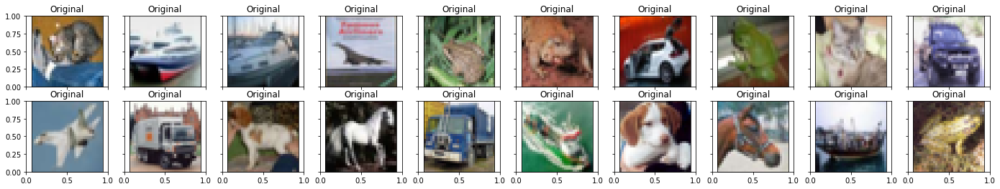

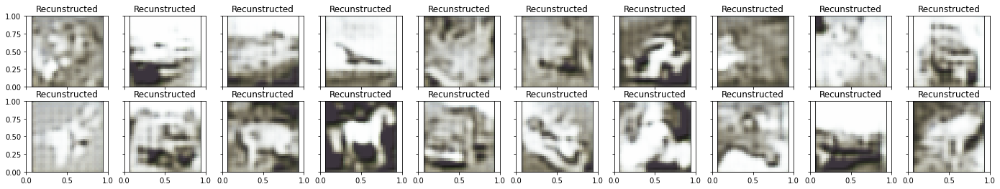


 EPOCH 108/150 	 train loss 0.5741237998008728 	 val loss 0.6747488379478455


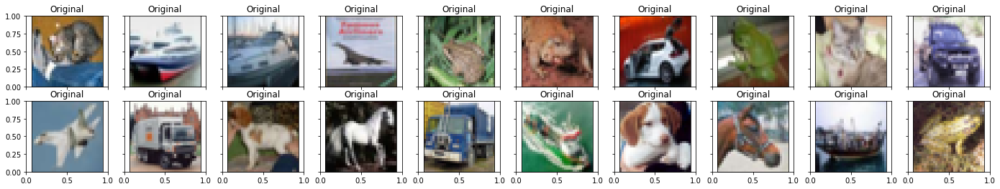

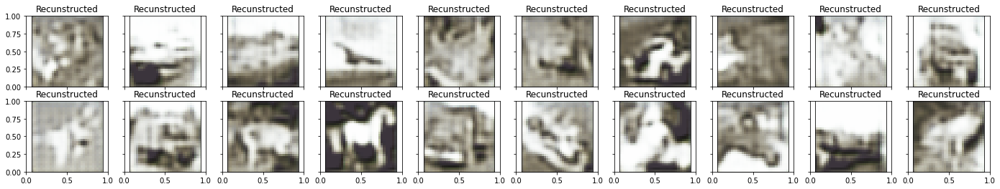


 EPOCH 109/150 	 train loss 0.5744225382804871 	 val loss 0.7419358491897583


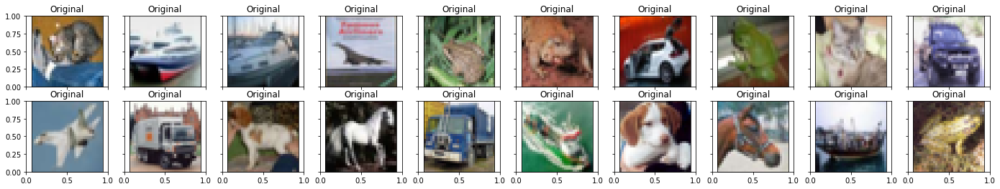

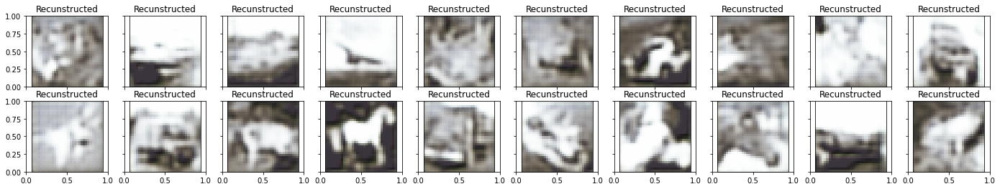


 EPOCH 110/150 	 train loss 0.5736523270606995 	 val loss 0.6811462044715881


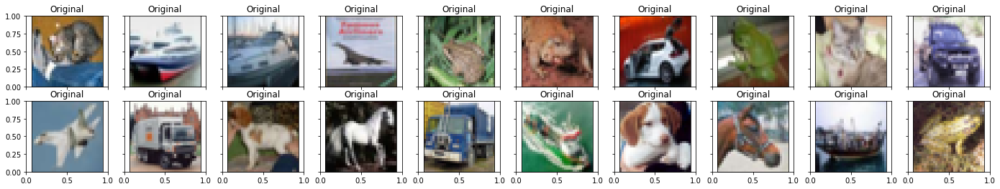

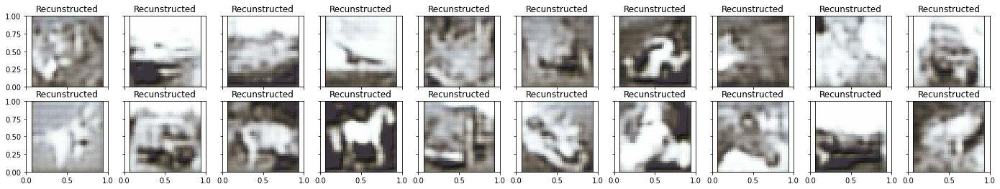


 EPOCH 111/150 	 train loss 0.5731878280639648 	 val loss 0.6563056111335754


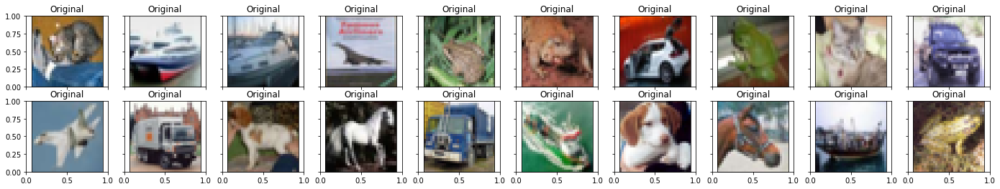

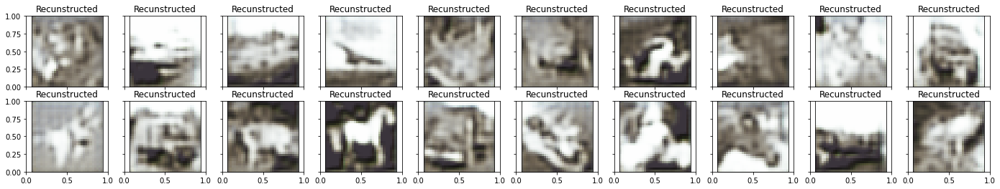


 EPOCH 112/150 	 train loss 0.5727625489234924 	 val loss 0.6281535625457764


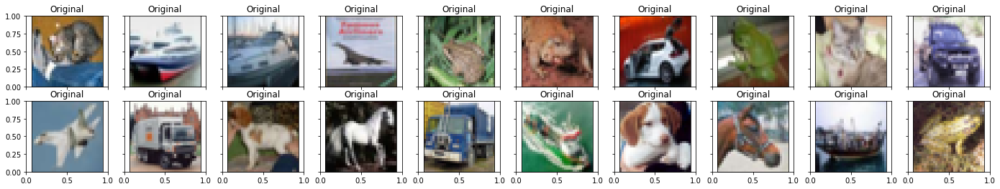

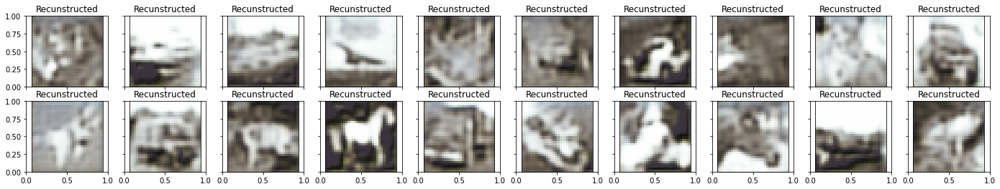


 EPOCH 113/150 	 train loss 0.5721864700317383 	 val loss 0.6208372116088867


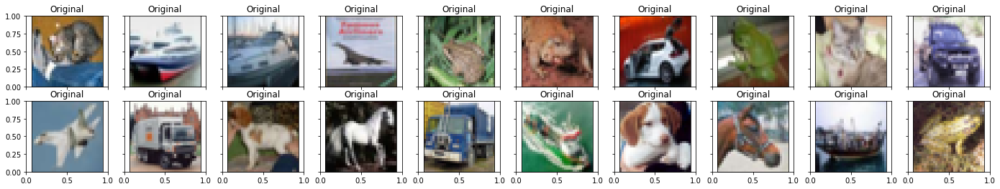

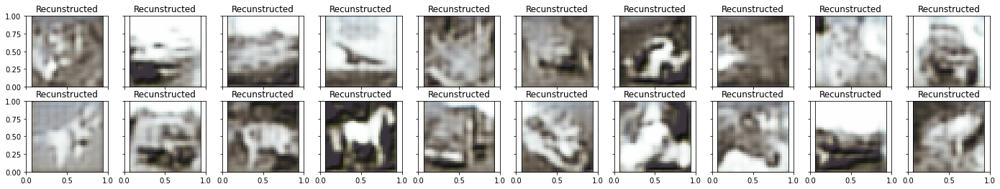


 EPOCH 114/150 	 train loss 0.5715565085411072 	 val loss 0.6036434769630432


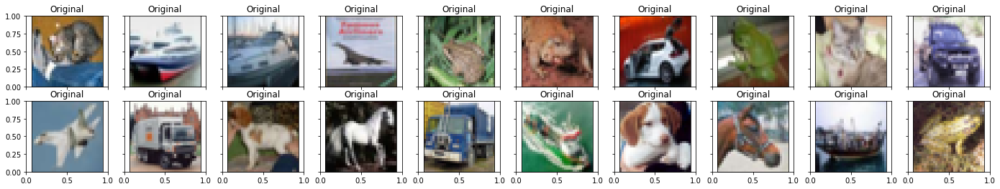

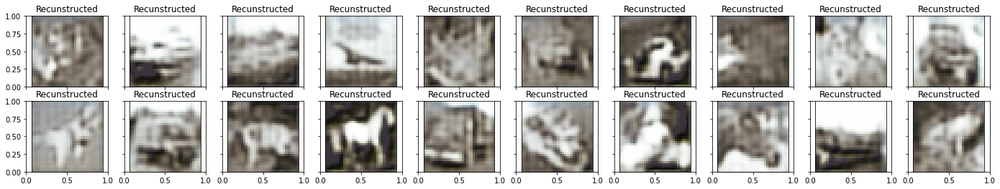


 EPOCH 115/150 	 train loss 0.5710461735725403 	 val loss 0.6143028140068054


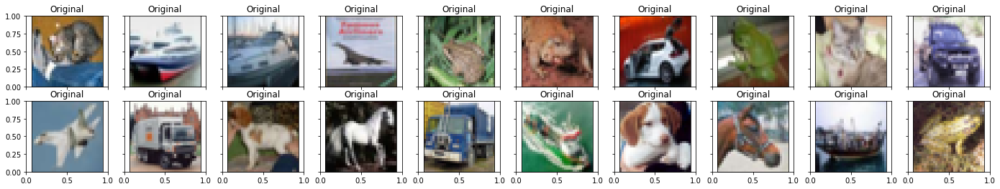

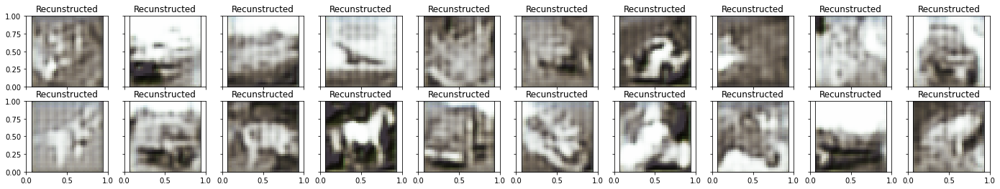


 EPOCH 116/150 	 train loss 0.5705041885375977 	 val loss 0.5868006348609924


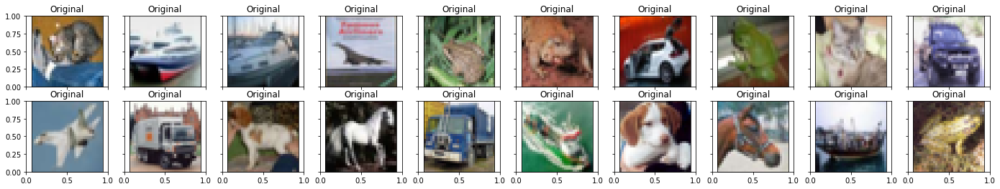

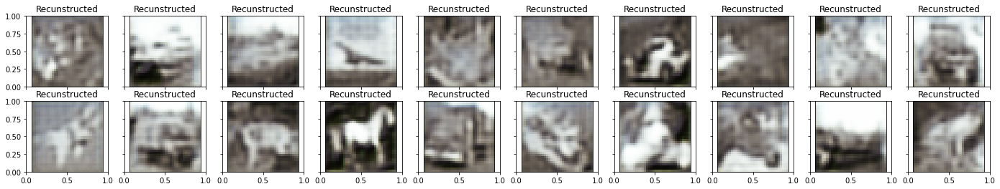


 EPOCH 117/150 	 train loss 0.5723319053649902 	 val loss 0.5779346823692322


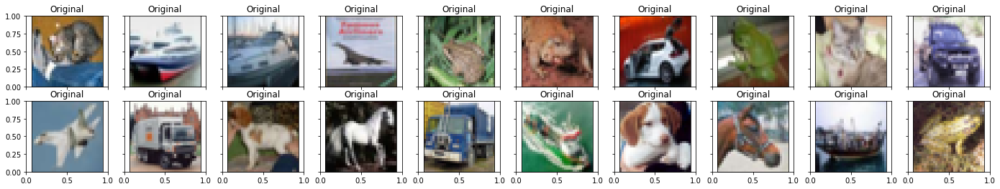

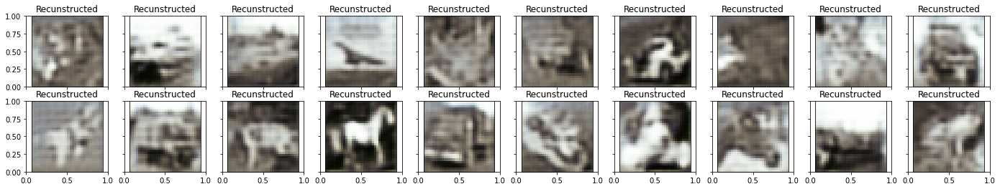


 EPOCH 118/150 	 train loss 0.5713545680046082 	 val loss 0.5726588368415833


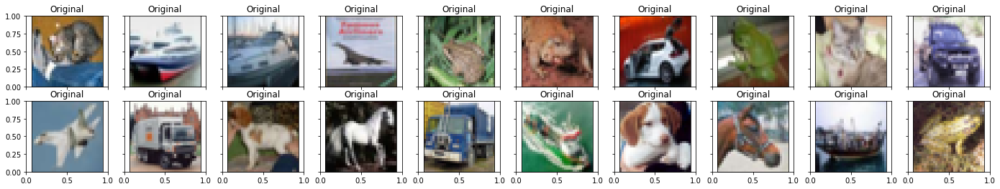

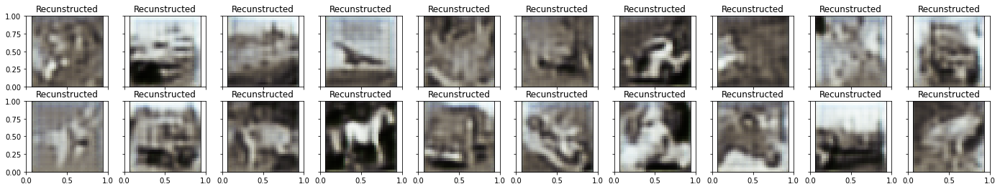


 EPOCH 119/150 	 train loss 0.571651041507721 	 val loss 0.5804771780967712


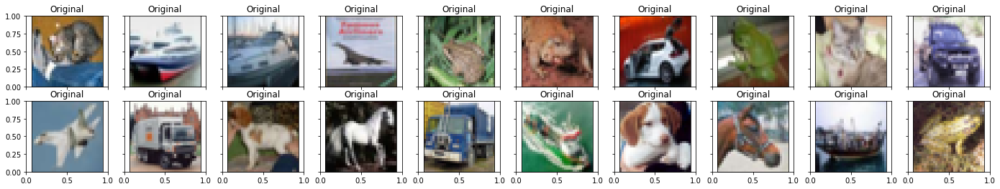

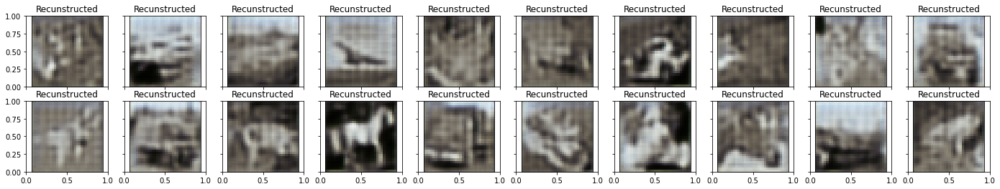


 EPOCH 120/150 	 train loss 0.5711463689804077 	 val loss 0.5910314917564392


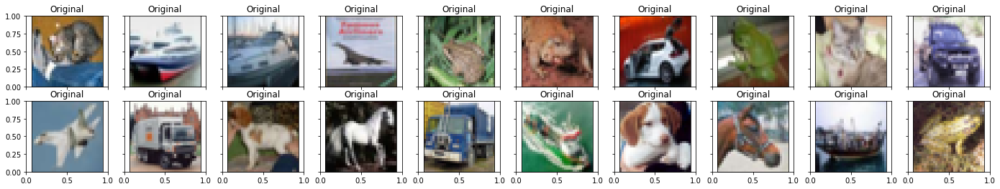

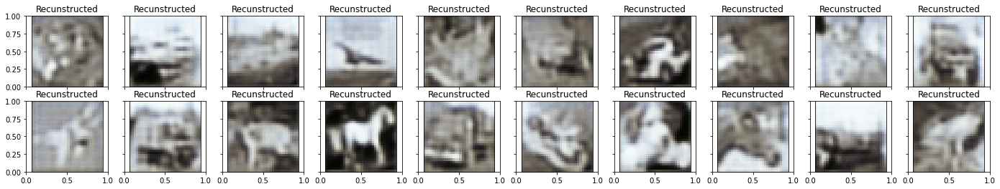


 EPOCH 121/150 	 train loss 0.5697978138923645 	 val loss 0.6071112155914307


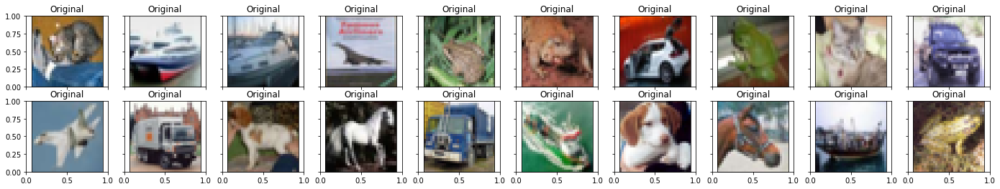

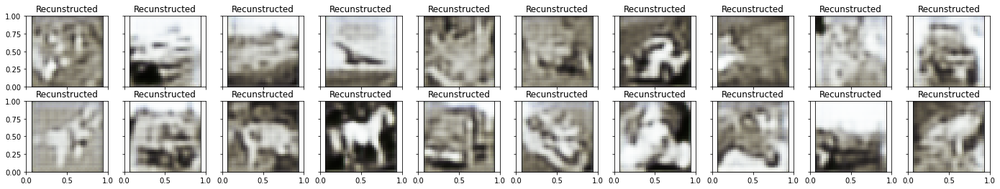


 EPOCH 122/150 	 train loss 0.5692567825317383 	 val loss 0.5784660577774048


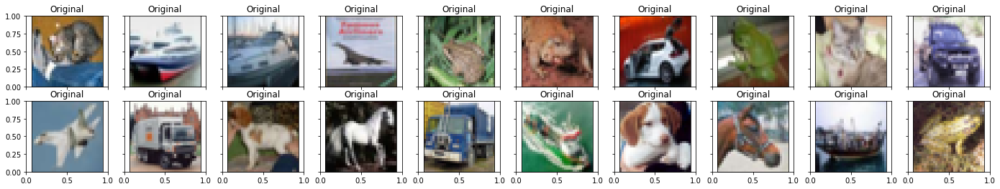

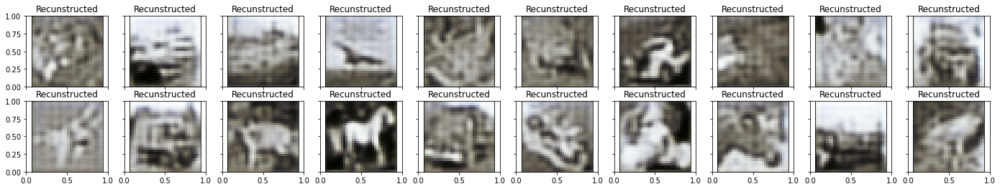


 EPOCH 123/150 	 train loss 0.5687409043312073 	 val loss 0.6014294028282166


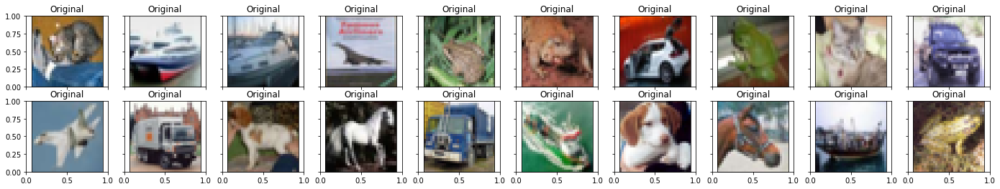

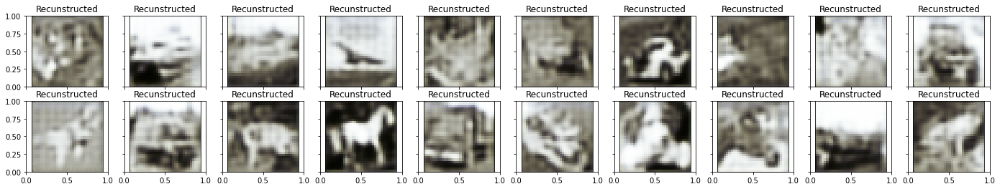


 EPOCH 124/150 	 train loss 0.5686710476875305 	 val loss 0.5881399512290955


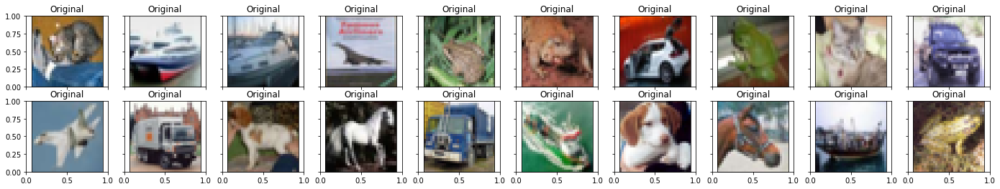

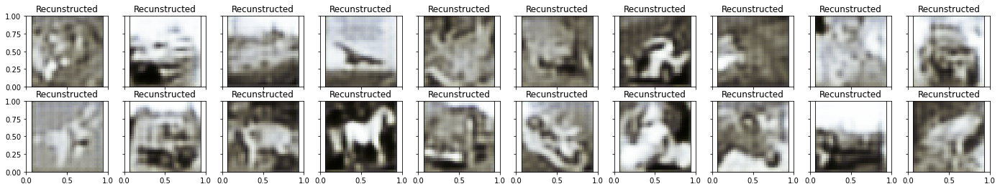


 EPOCH 125/150 	 train loss 0.5680844187736511 	 val loss 0.5905582308769226


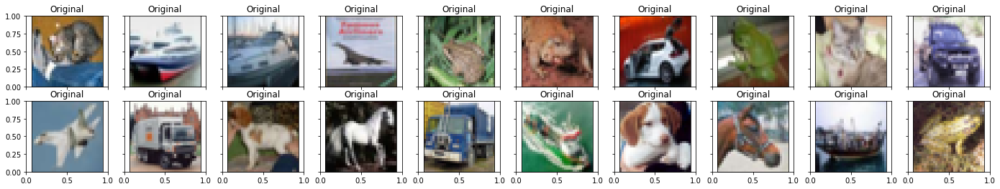

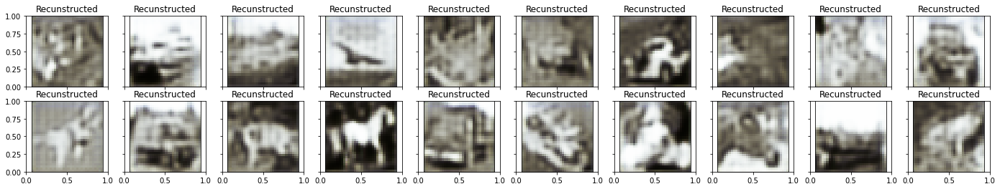


 EPOCH 126/150 	 train loss 0.5678923726081848 	 val loss 0.5914131999015808


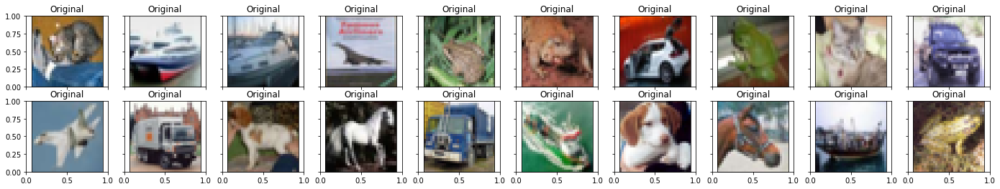

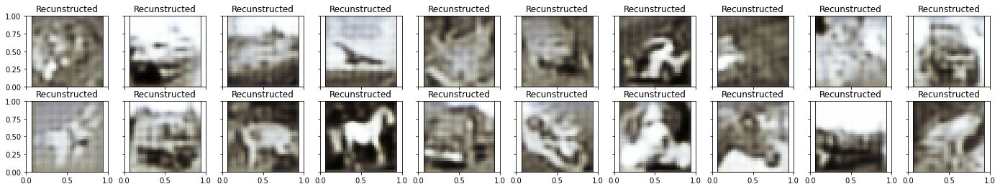


 EPOCH 127/150 	 train loss 0.5678777098655701 	 val loss 0.5761970281600952


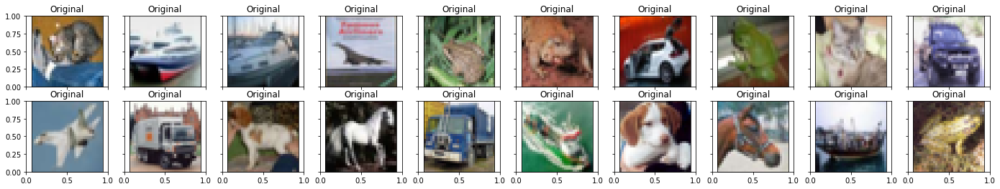

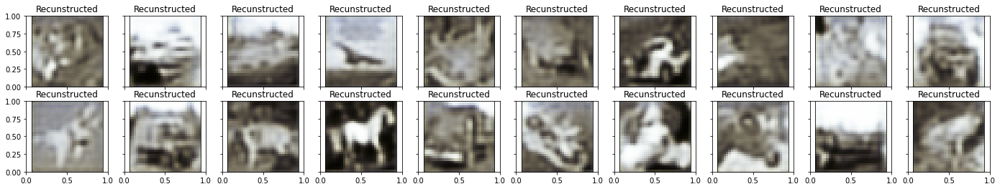


 EPOCH 128/150 	 train loss 0.5674698948860168 	 val loss 0.5710136890411377


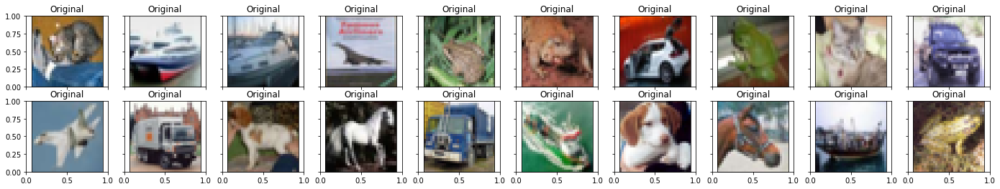

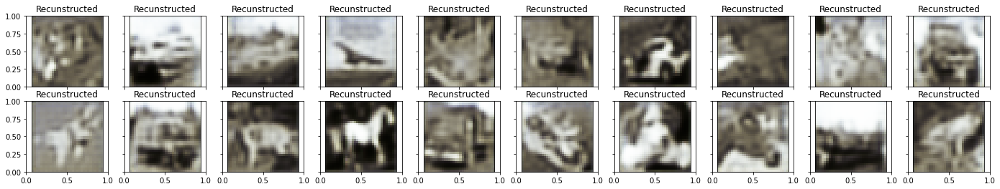


 EPOCH 129/150 	 train loss 0.5673202872276306 	 val loss 0.5683335661888123


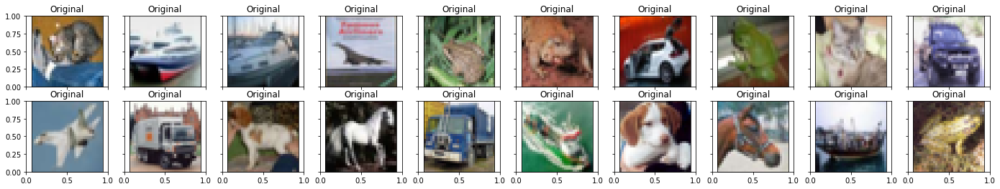

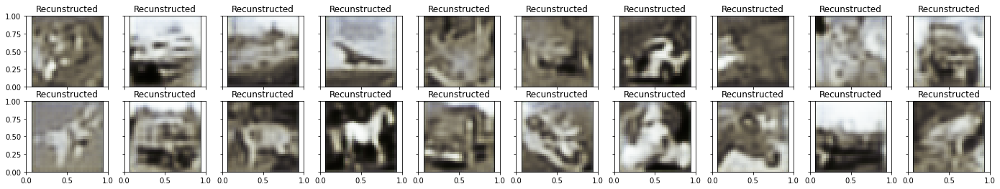


 EPOCH 130/150 	 train loss 0.5674758553504944 	 val loss 0.5698328614234924


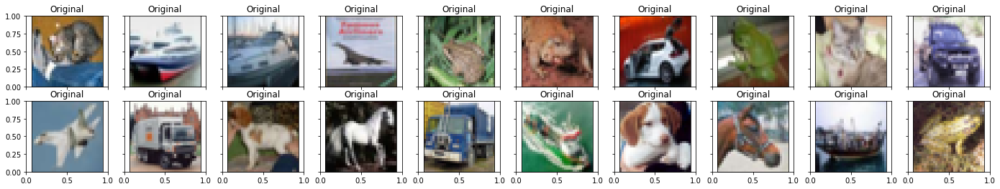

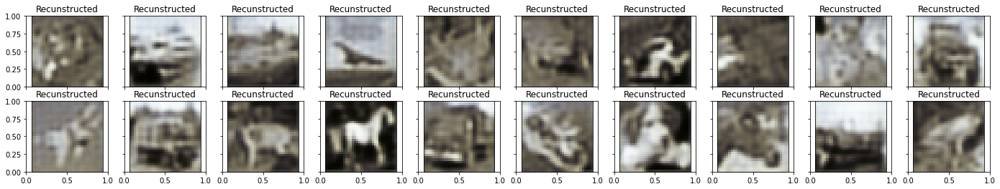


 EPOCH 131/150 	 train loss 0.566978394985199 	 val loss 0.5686429738998413


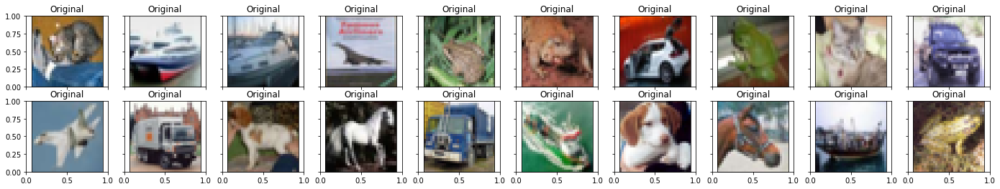

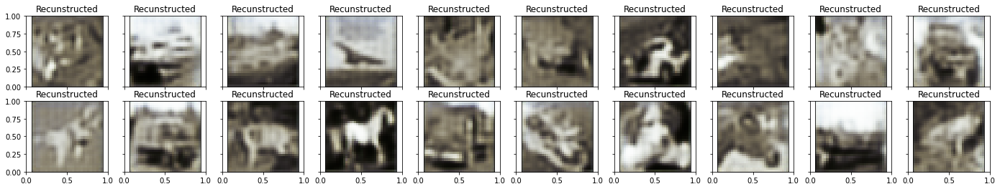


 EPOCH 132/150 	 train loss 0.5670838952064514 	 val loss 0.5694354772567749


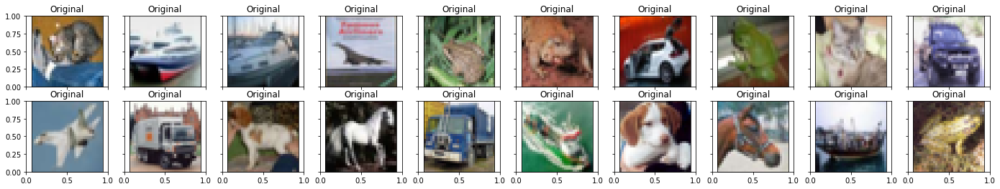

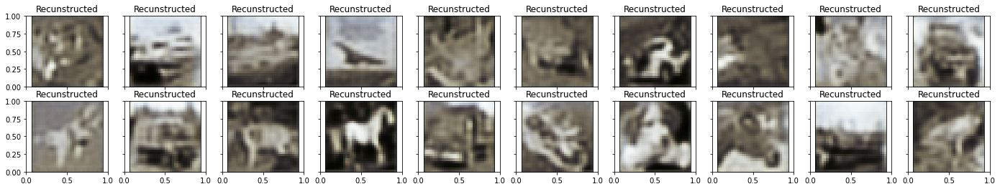


 EPOCH 133/150 	 train loss 0.567073404788971 	 val loss 0.568945586681366


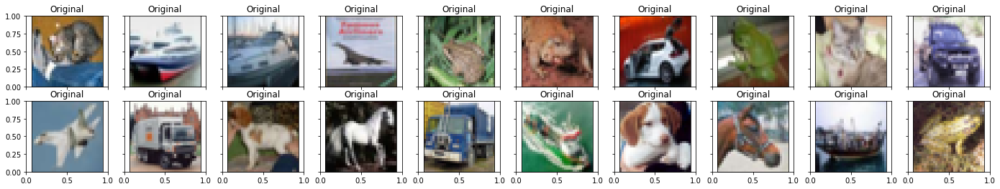

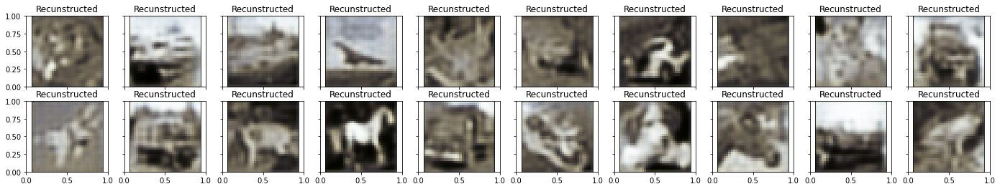


 EPOCH 134/150 	 train loss 0.5669457316398621 	 val loss 0.5684704184532166


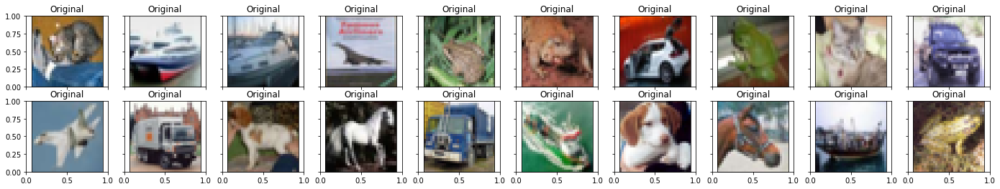

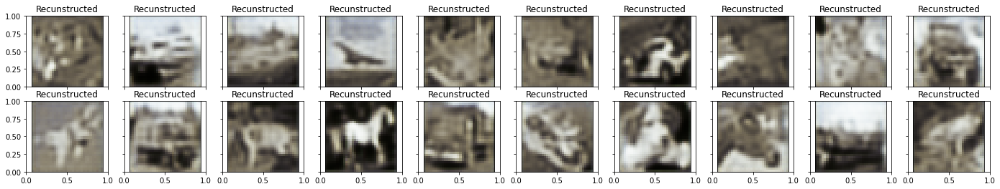


 EPOCH 135/150 	 train loss 0.5670714974403381 	 val loss 0.5712291598320007


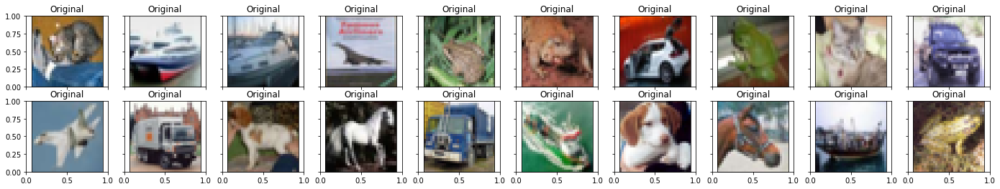

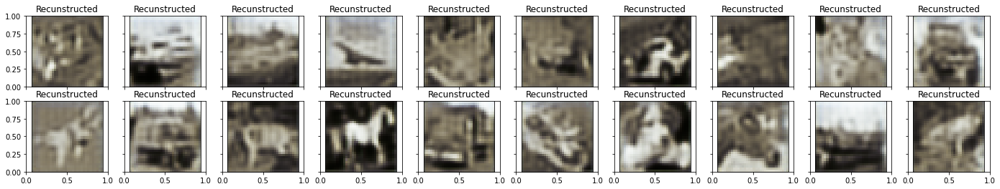


 EPOCH 136/150 	 train loss 0.5676477551460266 	 val loss 0.5693960785865784


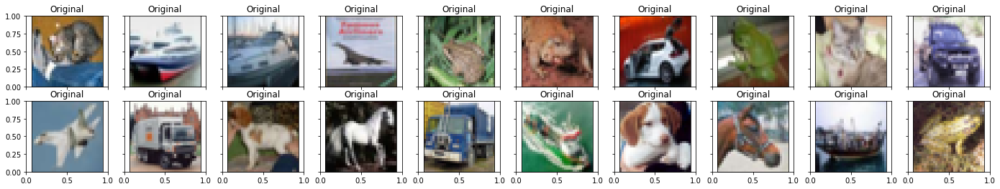

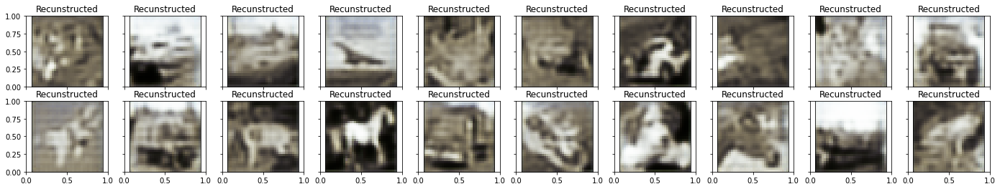


 EPOCH 137/150 	 train loss 0.5671188235282898 	 val loss 0.5696828961372375


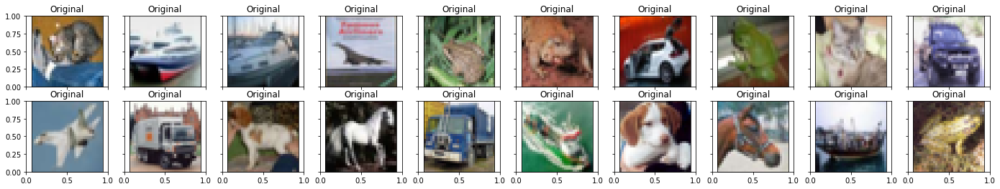

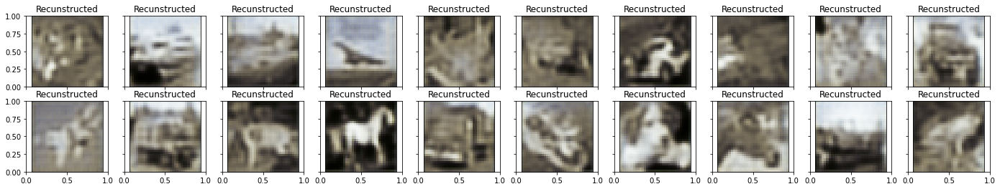


 EPOCH 138/150 	 train loss 0.5666818618774414 	 val loss 0.568672776222229


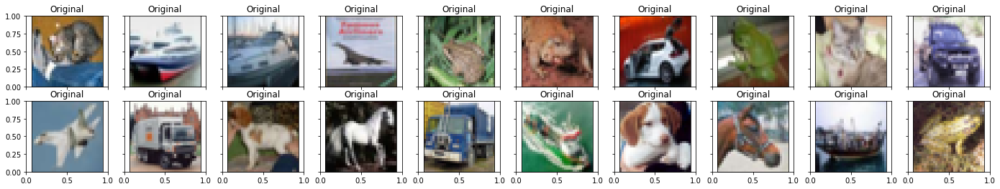

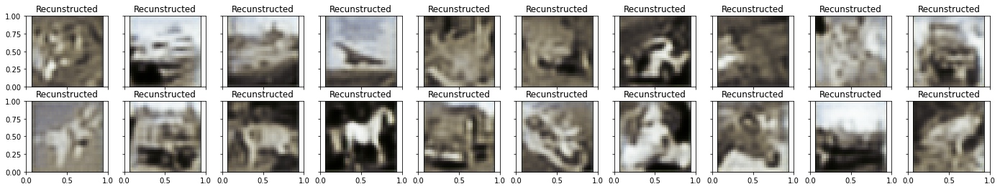


 EPOCH 139/150 	 train loss 0.567014217376709 	 val loss 0.5710296034812927


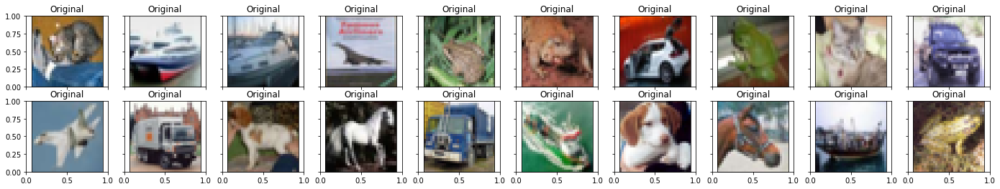

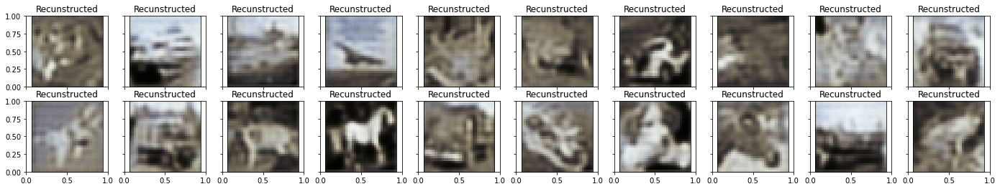


 EPOCH 140/150 	 train loss 0.5672642588615417 	 val loss 0.5703877806663513


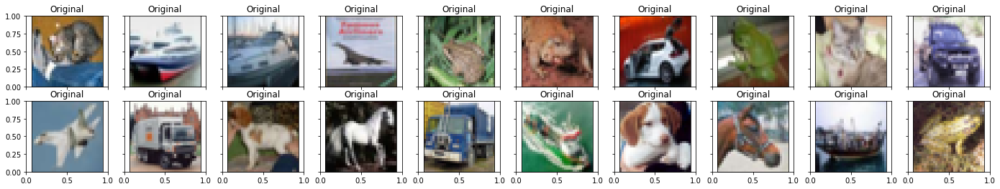

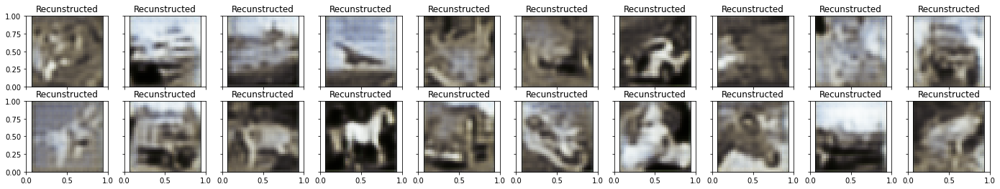


 EPOCH 141/150 	 train loss 0.5671215057373047 	 val loss 0.5694242119789124


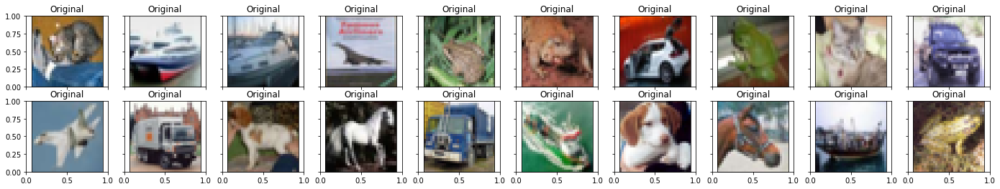

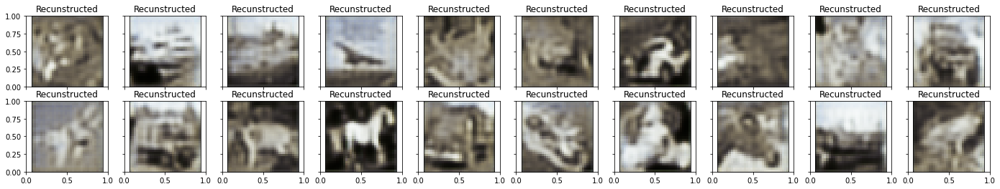


 EPOCH 142/150 	 train loss 0.5669381022453308 	 val loss 0.5685855746269226


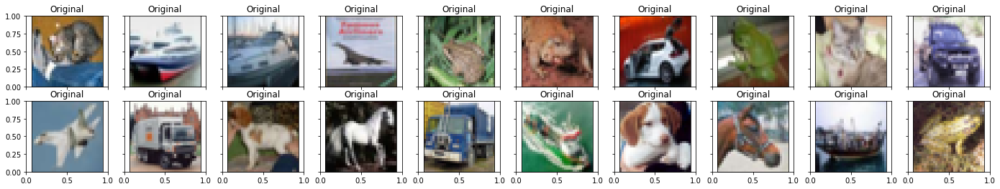

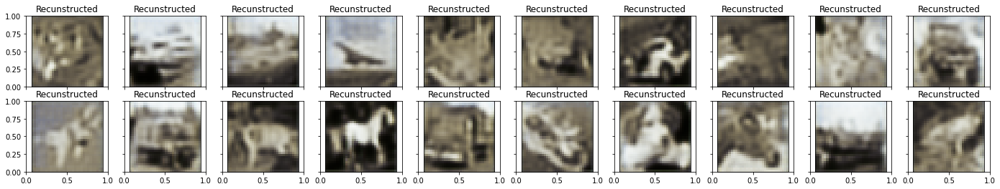


 EPOCH 143/150 	 train loss 0.5666930079460144 	 val loss 0.5690718293190002


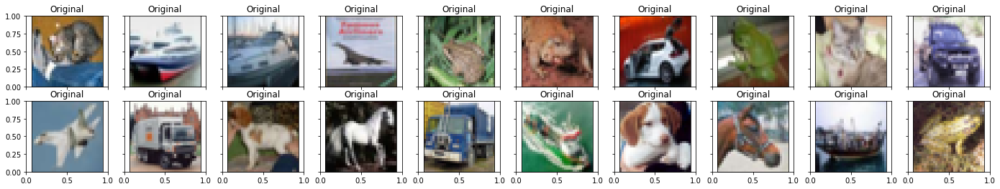

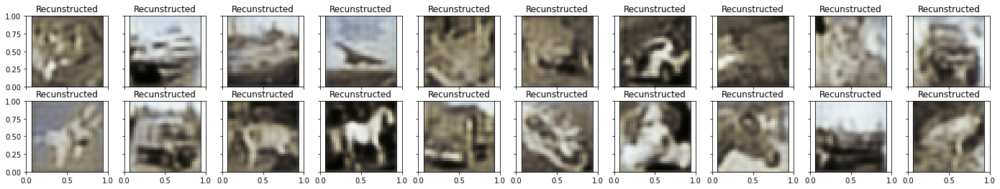


 EPOCH 144/150 	 train loss 0.5673359036445618 	 val loss 0.5752853155136108


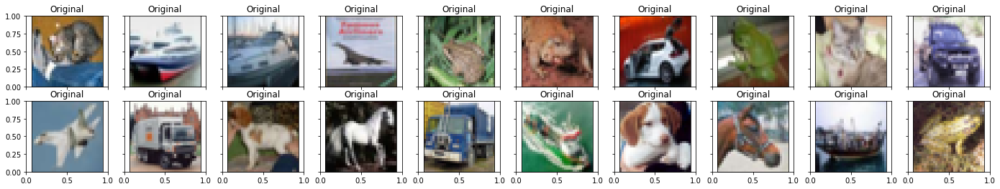

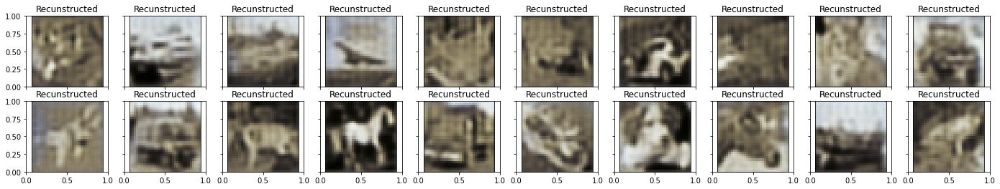


 EPOCH 145/150 	 train loss 0.5681437849998474 	 val loss 0.572178304195404


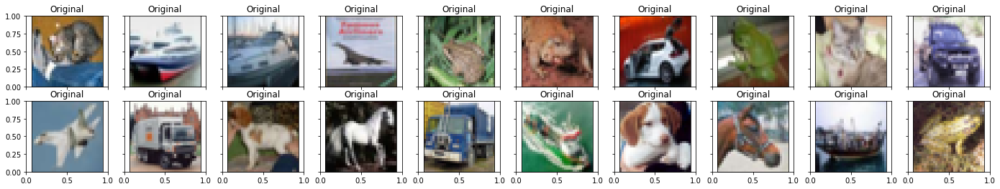

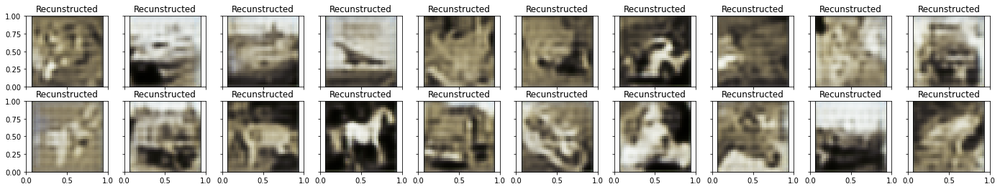


 EPOCH 146/150 	 train loss 0.5682604908943176 	 val loss 0.5807228088378906


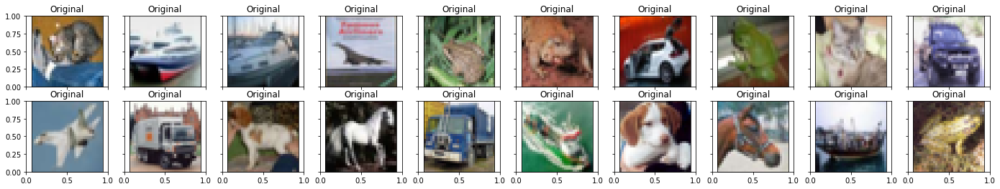

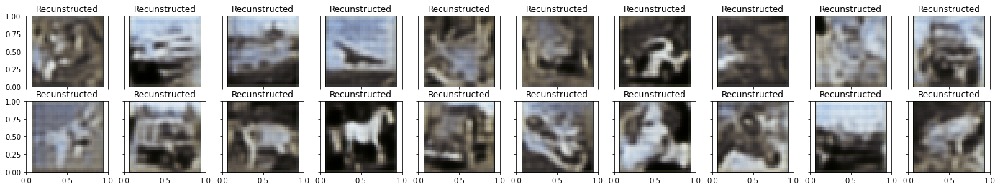


 EPOCH 147/150 	 train loss 0.5673906803131104 	 val loss 0.5693126320838928


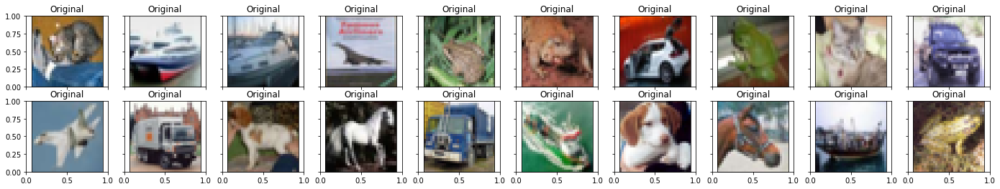

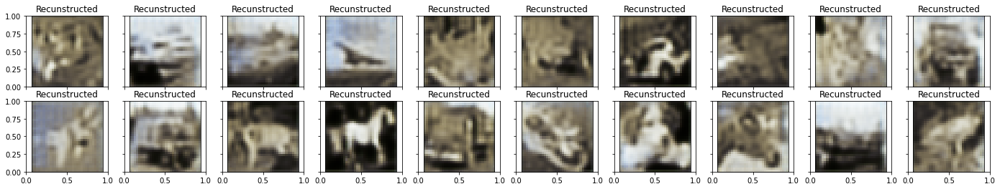


 EPOCH 148/150 	 train loss 0.5667891502380371 	 val loss 0.5694955587387085


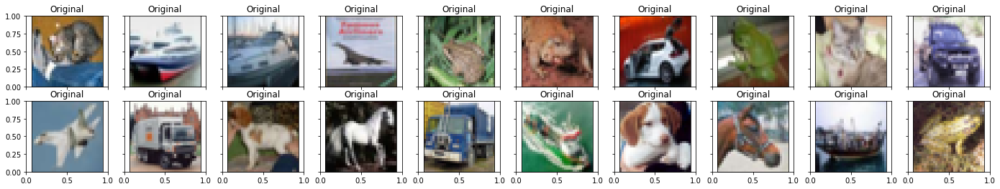

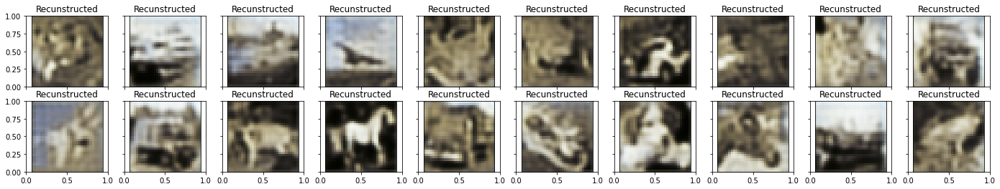


 EPOCH 149/150 	 train loss 0.5664923191070557 	 val loss 0.569373607635498


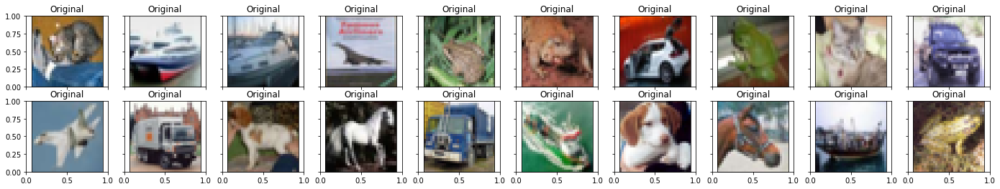

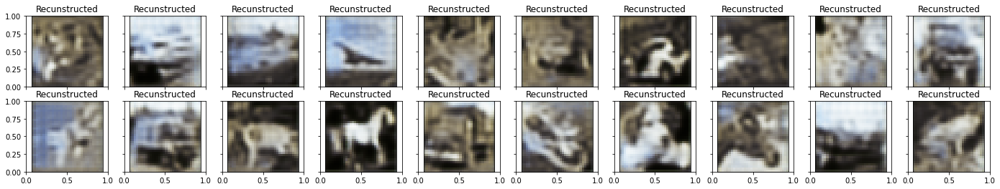


 EPOCH 150/150 	 train loss 0.5658870339393616 	 val loss 0.5704706311225891


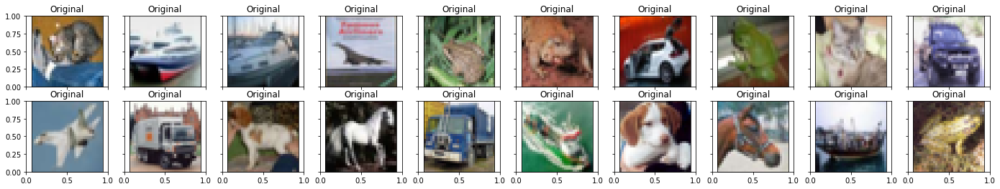

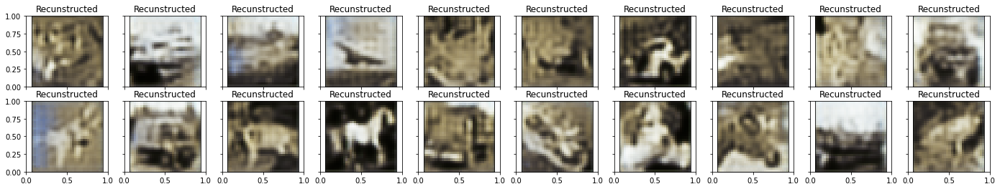

In [ ]:
num_epochs = 150
diz_loss = {'train_loss':[],'val_loss':[]}
for epoch in range(num_epochs):
   train_loss =train_epoch(encoder,decoder,device,train_loader,loss_fn,optimizer)
   val_loss = test_epoch(encoder,decoder,device,test_loader,loss_fn)
   print('\n EPOCH {}/{} \t train loss {} \t val loss {}'.format(epoch + 1, num_epochs,train_loss,val_loss))
   diz_loss['train_loss'].append(train_loss)
   diz_loss['val_loss'].append(val_loss)
   plot_ae_outputs(encoder,decoder, n=20)


 EPOCH 1/30 	 train loss 0.5570944547653198 	 val loss 0.5591029524803162


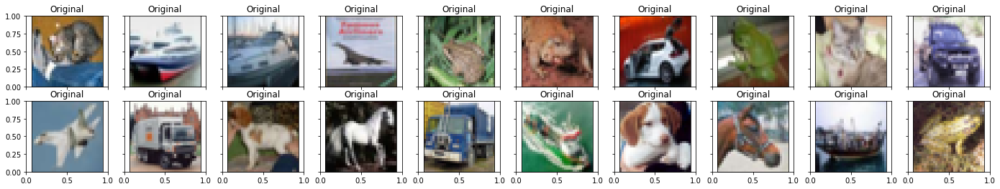

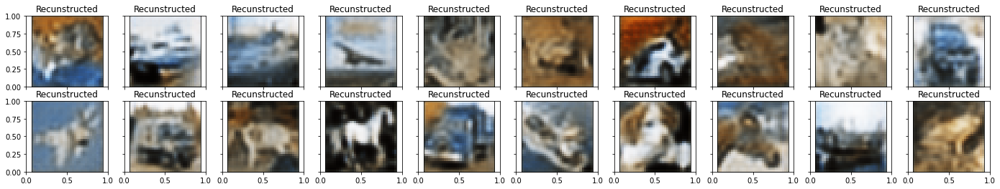


 EPOCH 2/30 	 train loss 0.556858479976654 	 val loss 0.5592405796051025


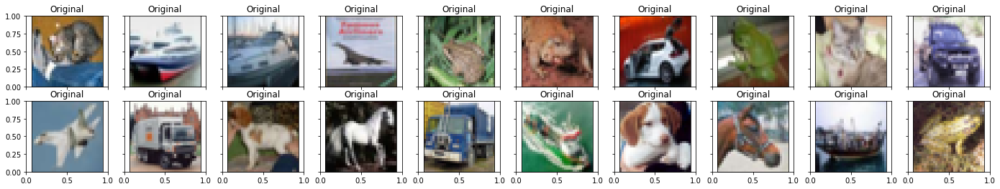

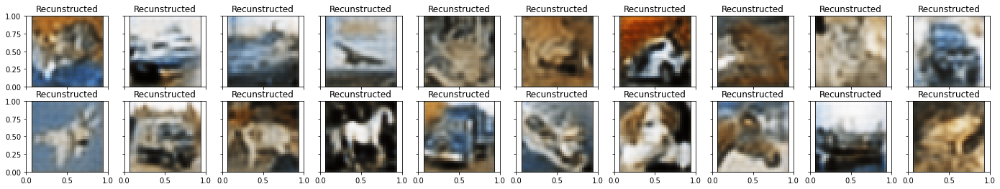


 EPOCH 3/30 	 train loss 0.556633472442627 	 val loss 0.5579853057861328


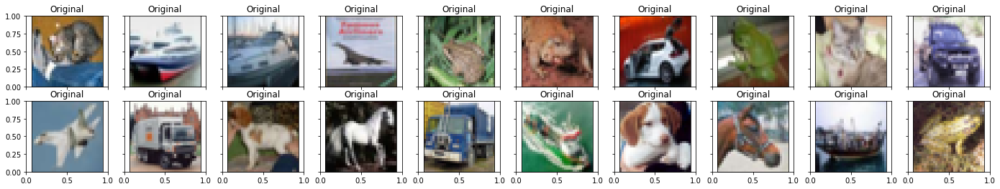

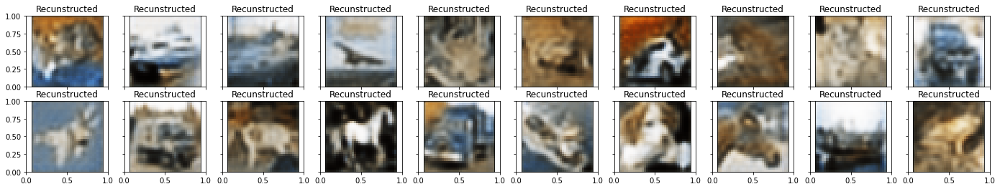


 EPOCH 4/30 	 train loss 0.5566411018371582 	 val loss 0.5591299533843994


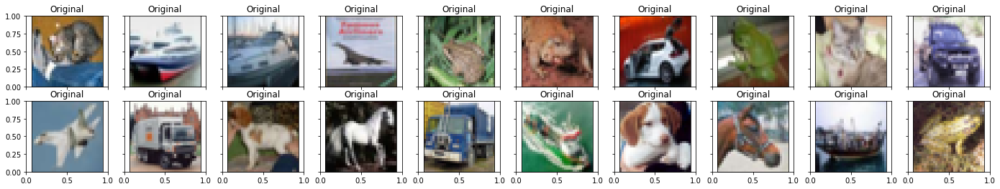

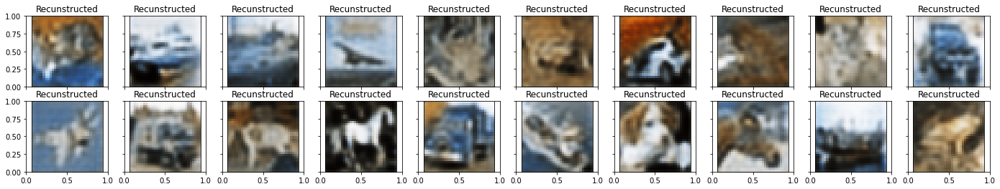


 EPOCH 5/30 	 train loss 0.5568199753761292 	 val loss 0.5591110587120056


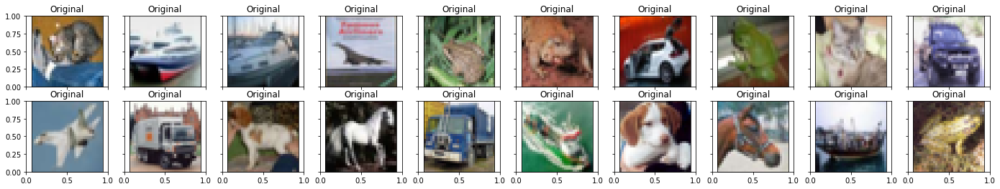

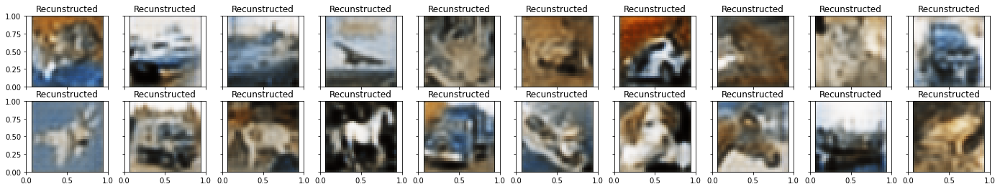


 EPOCH 6/30 	 train loss 0.5566034317016602 	 val loss 0.5603965520858765


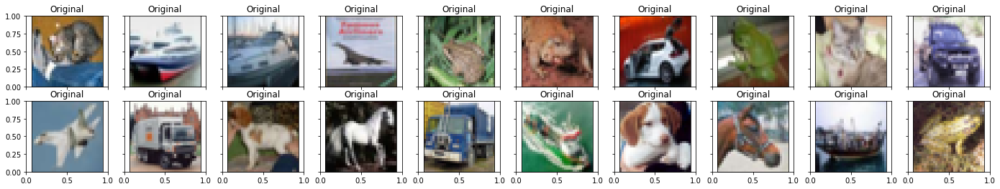

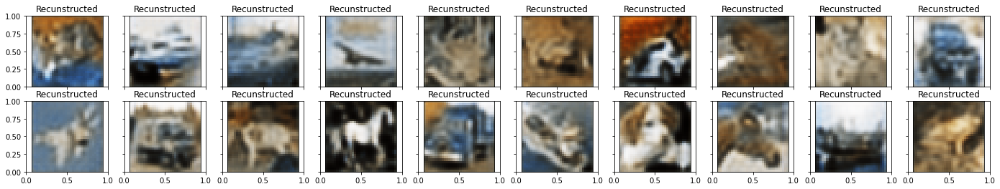


 EPOCH 7/30 	 train loss 0.5566133856773376 	 val loss 0.5636650919914246


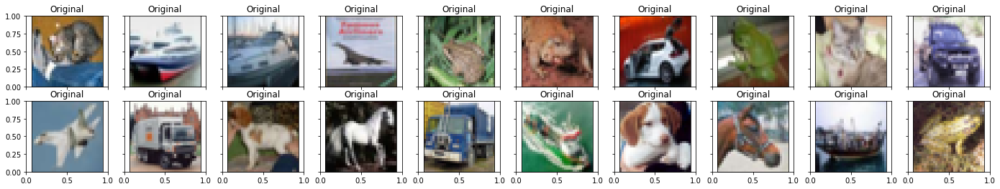

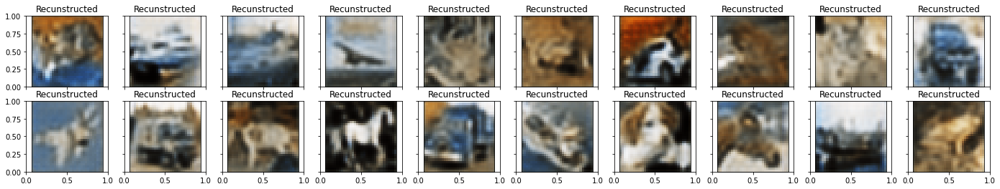


 EPOCH 8/30 	 train loss 0.5563344359397888 	 val loss 0.561449408531189


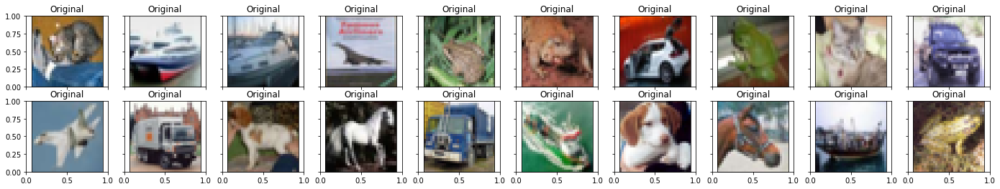

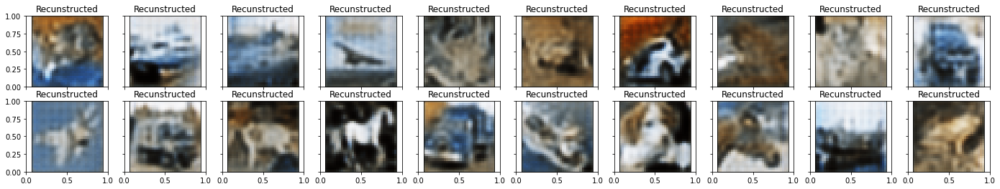


 EPOCH 9/30 	 train loss 0.5565332174301147 	 val loss 0.5620785355567932


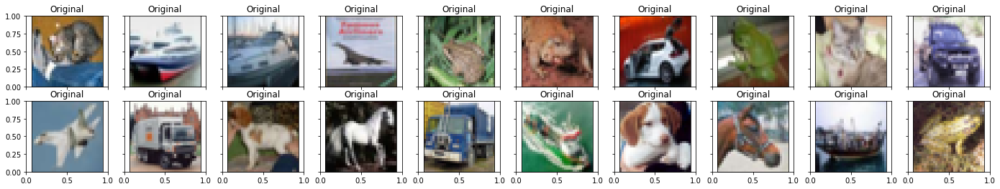

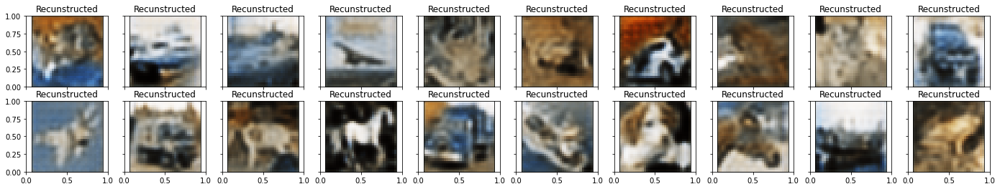


 EPOCH 10/30 	 train loss 0.55666184425354 	 val loss 0.5598406195640564


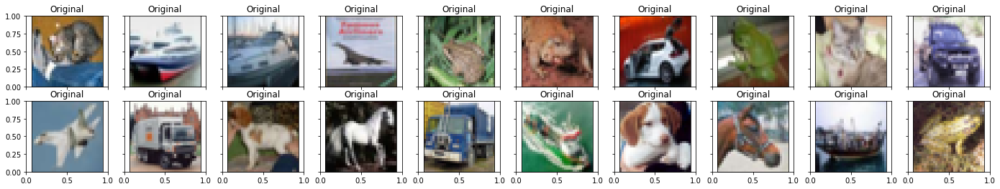

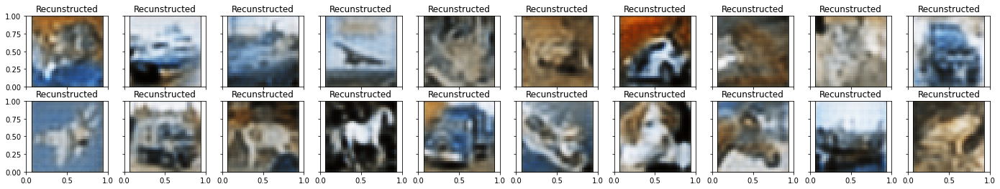


 EPOCH 11/30 	 train loss 0.5568482875823975 	 val loss 0.5605461001396179


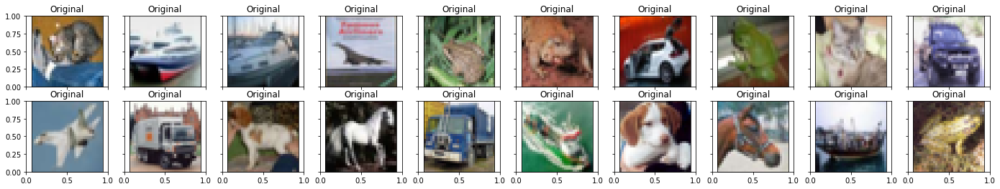

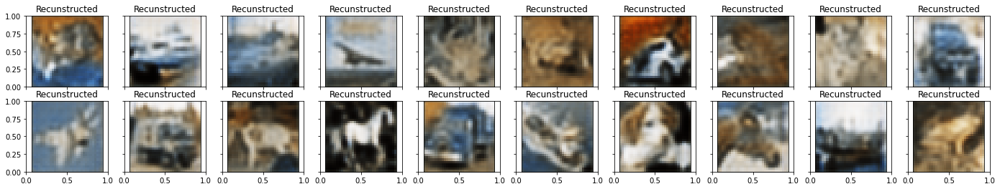


 EPOCH 12/30 	 train loss 0.5569239258766174 	 val loss 0.5632135272026062


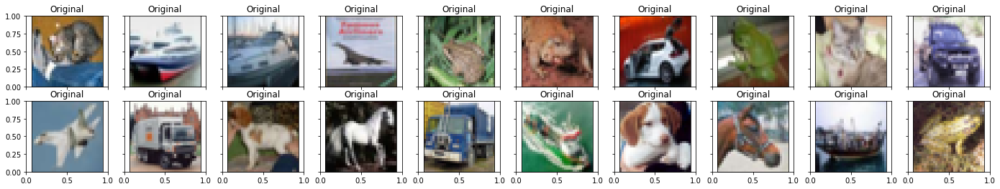

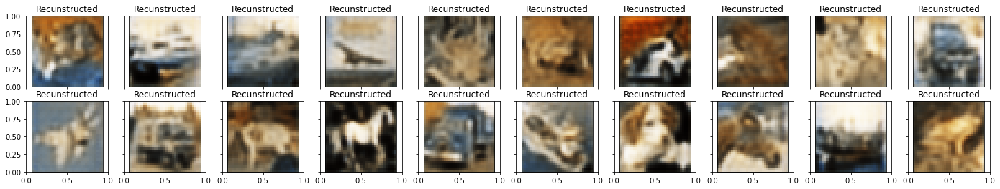


 EPOCH 13/30 	 train loss 0.5564870238304138 	 val loss 0.5622309446334839


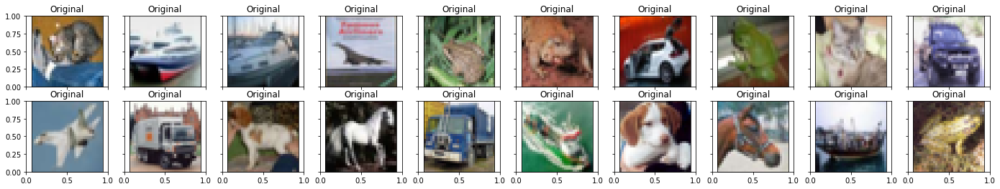

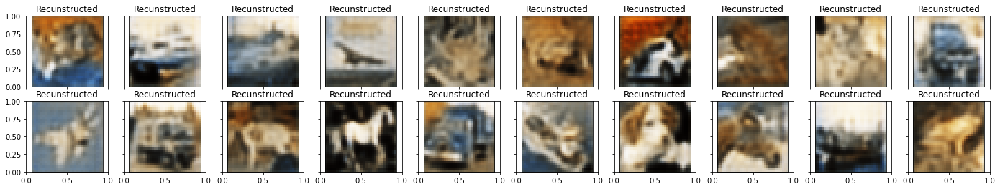


 EPOCH 14/30 	 train loss 0.5565691590309143 	 val loss 0.5583006739616394


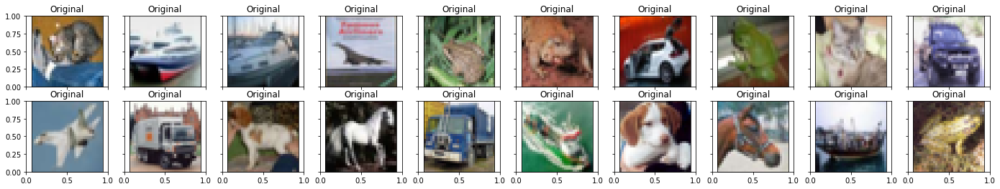

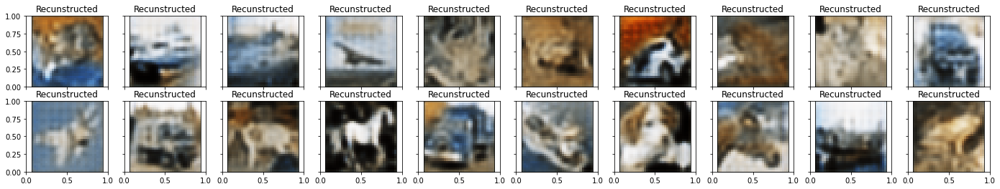


 EPOCH 15/30 	 train loss 0.556408703327179 	 val loss 0.559125542640686


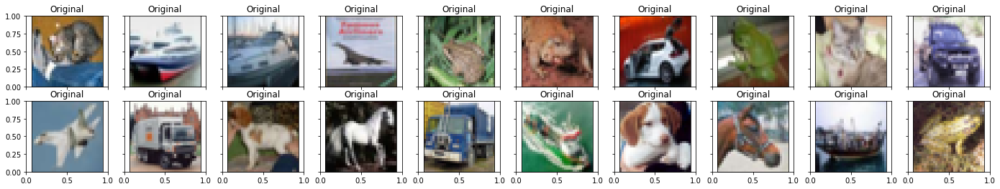

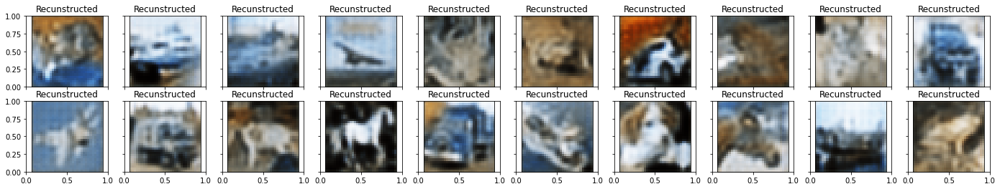


 EPOCH 16/30 	 train loss 0.5563409328460693 	 val loss 0.5592883825302124


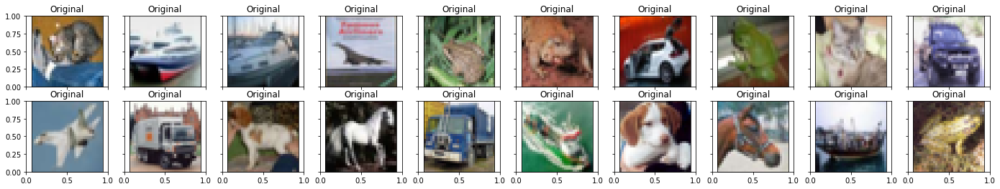

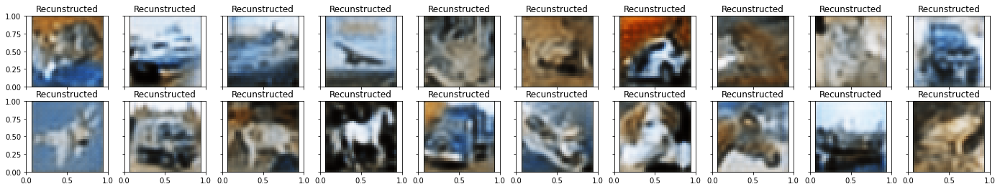


 EPOCH 17/30 	 train loss 0.5561291575431824 	 val loss 0.5574551224708557


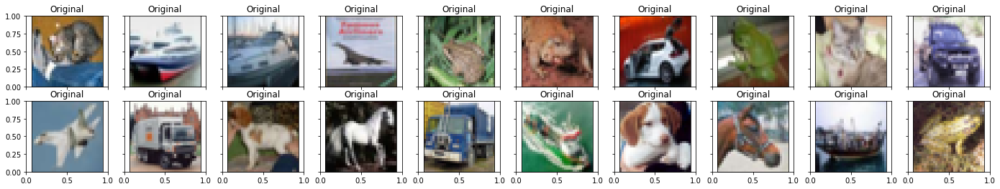

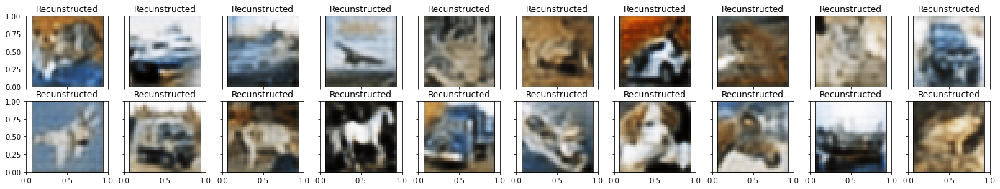


 EPOCH 18/30 	 train loss 0.5568282008171082 	 val loss 0.562241792678833


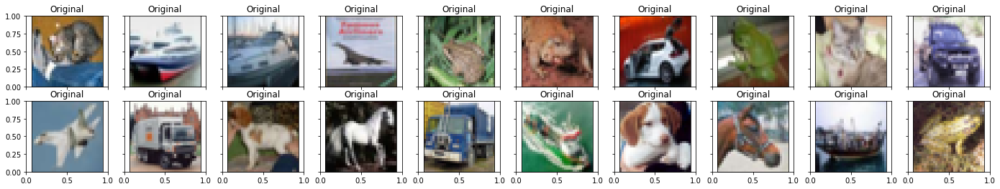

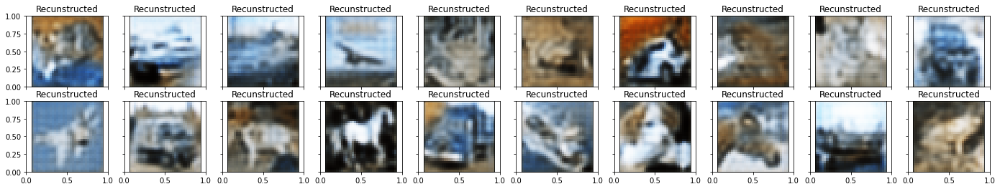


 EPOCH 19/30 	 train loss 0.5566726922988892 	 val loss 0.5677676796913147


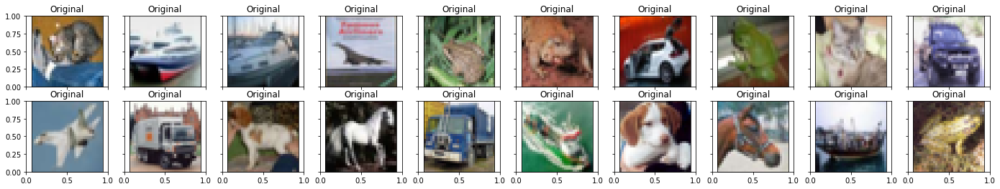

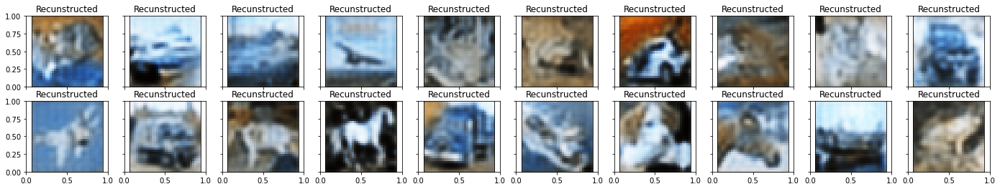


 EPOCH 20/30 	 train loss 0.5568469166755676 	 val loss 0.5590503811836243


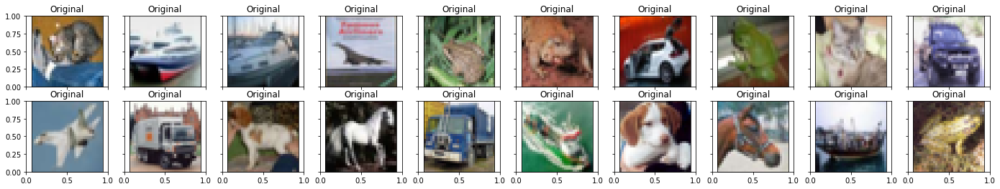

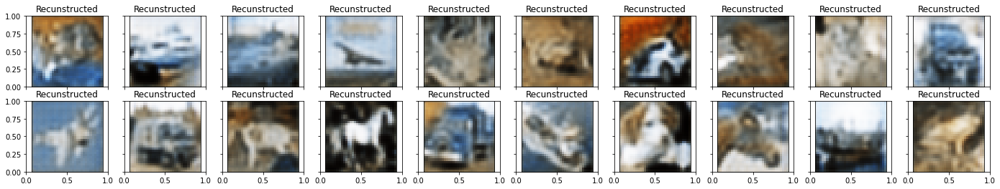


 EPOCH 21/30 	 train loss 0.5569033622741699 	 val loss 0.5586913228034973


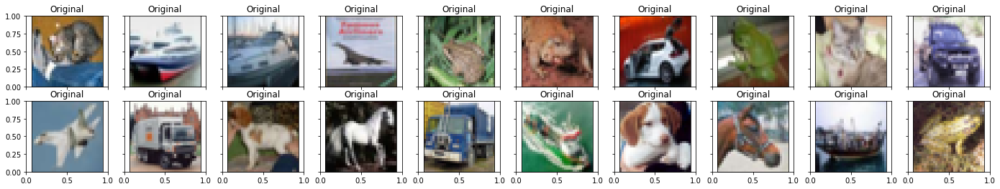

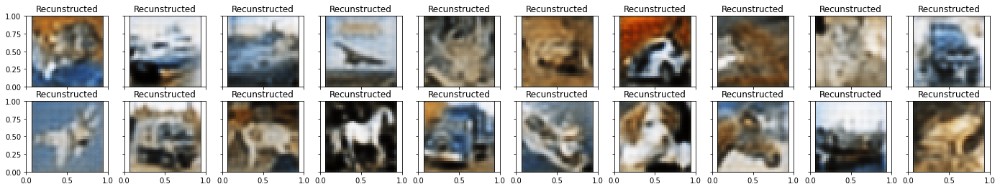


 EPOCH 22/30 	 train loss 0.5569443702697754 	 val loss 0.5639062523841858


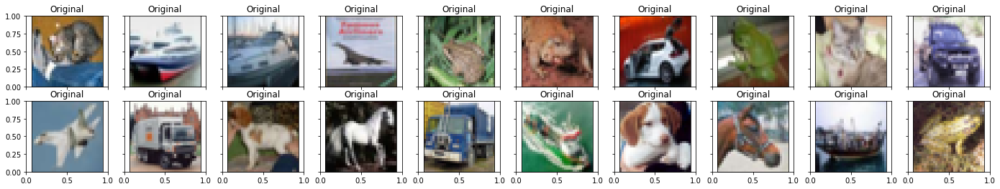

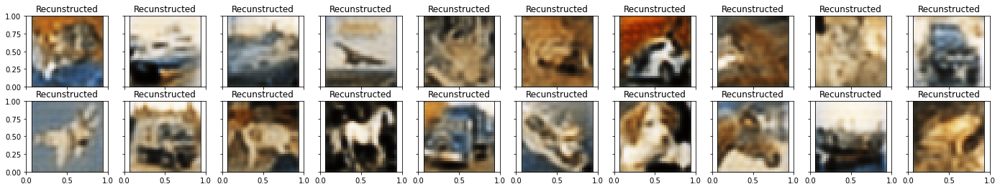


 EPOCH 23/30 	 train loss 0.5562395453453064 	 val loss 0.5608454346656799


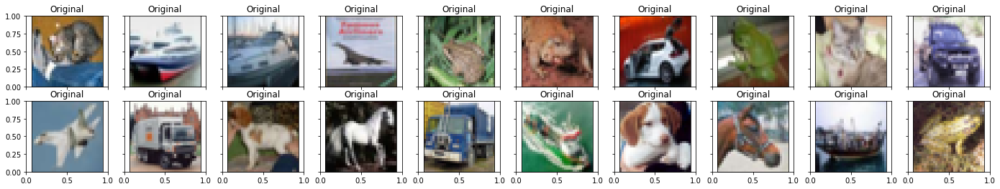

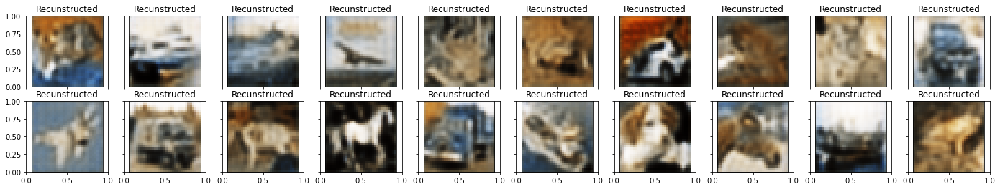


 EPOCH 24/30 	 train loss 0.5563974380493164 	 val loss 0.5585790276527405


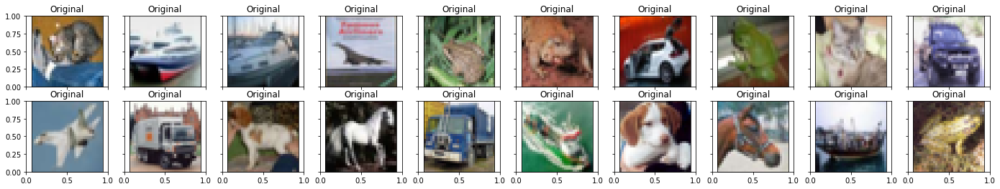

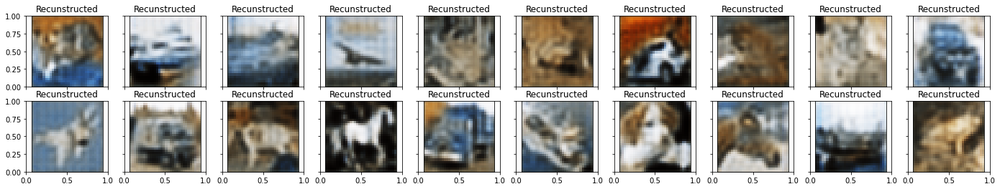


 EPOCH 25/30 	 train loss 0.5562686920166016 	 val loss 0.558112382888794


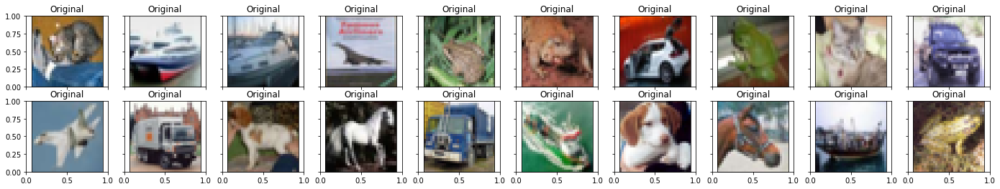

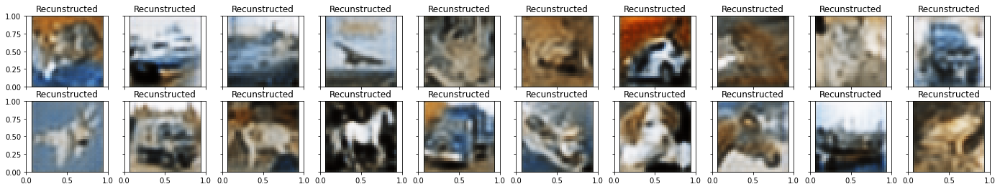


 EPOCH 26/30 	 train loss 0.555924654006958 	 val loss 0.5583600401878357


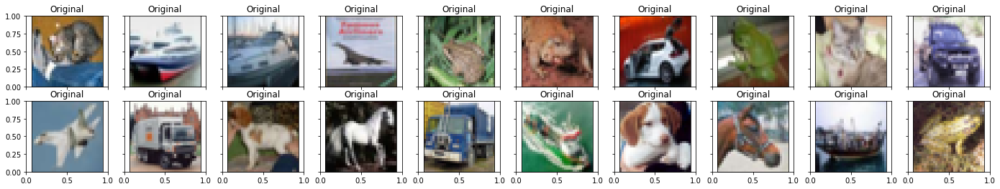

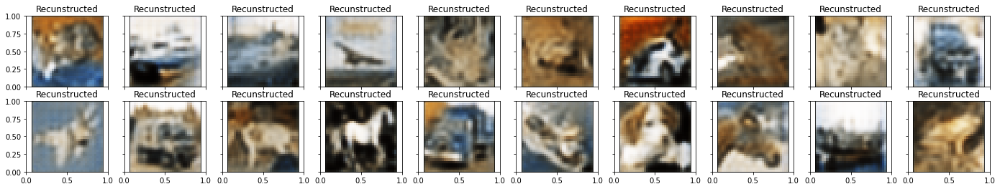


 EPOCH 27/30 	 train loss 0.5561801791191101 	 val loss 0.5574352741241455


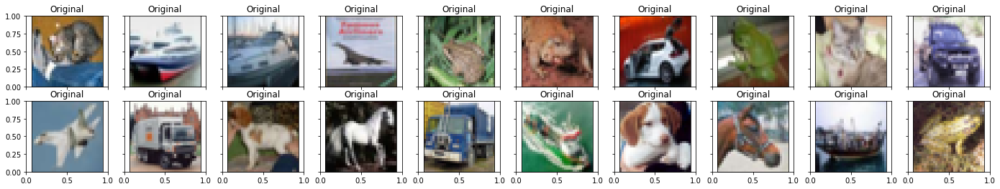

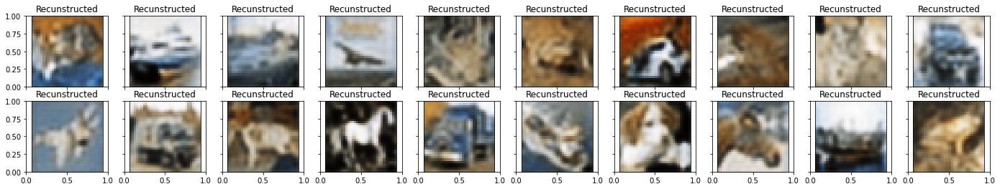


 EPOCH 28/30 	 train loss 0.555831253528595 	 val loss 0.5586526989936829


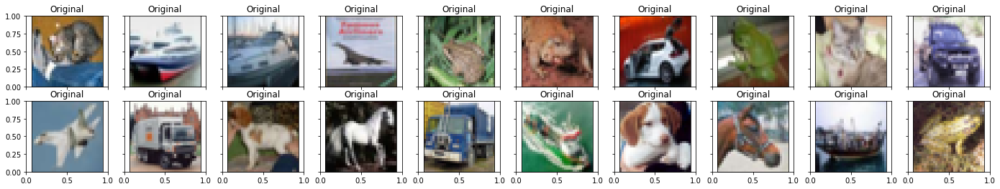

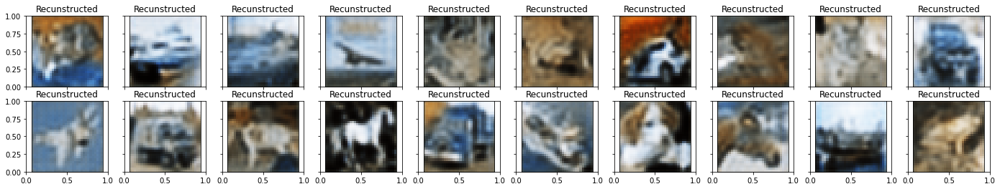


 EPOCH 29/30 	 train loss 0.5563339591026306 	 val loss 0.5594143271446228


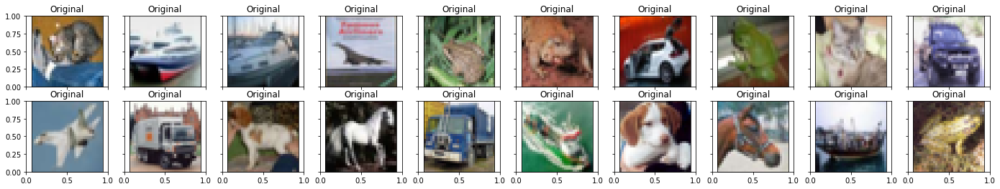

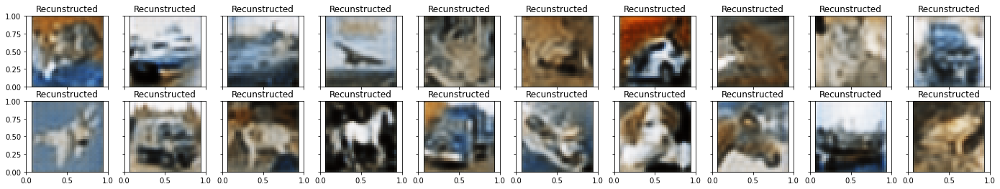


 EPOCH 30/30 	 train loss 0.5559642910957336 	 val loss 0.5603262782096863


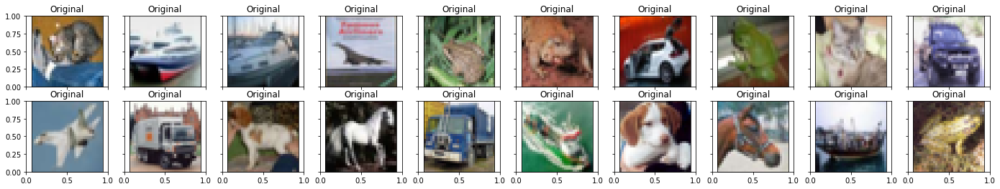

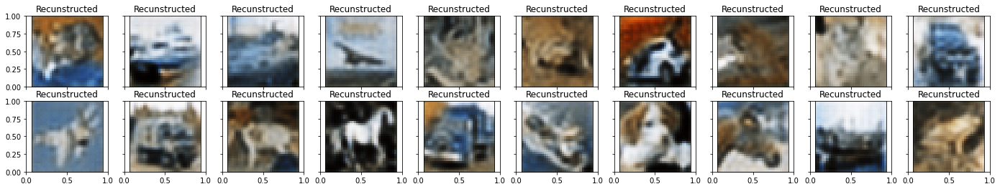

In [ ]:
num_epochs = 30
diz_loss = {'train_loss':[],'val_loss':[]}
for epoch in range(num_epochs):
   train_loss =train_epoch(encoder,decoder,device,train_loader,loss_fn,optimizer)
   val_loss = test_epoch(encoder,decoder,device,test_loader,loss_fn)
   print('\n EPOCH {}/{} \t train loss {} \t val loss {}'.format(epoch + 1, num_epochs,train_loss,val_loss))
   diz_loss['train_loss'].append(train_loss)
   diz_loss['val_loss'].append(val_loss)
   plot_ae_outputs(encoder,decoder, n=20)

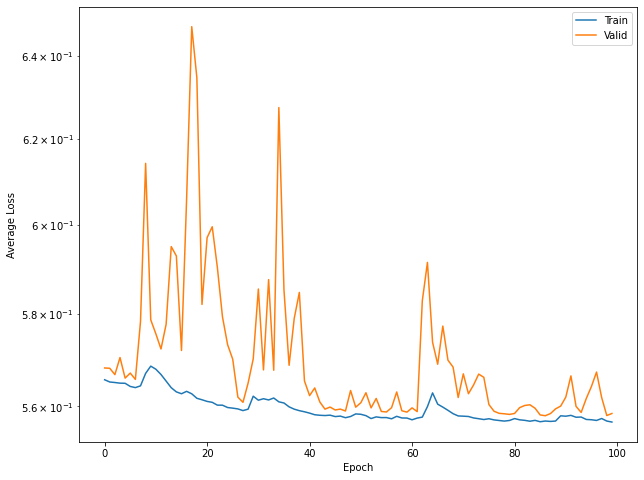

In [ ]:
# Plot losses
plt.figure(figsize=(10,8))
plt.semilogy(diz_loss['train_loss'], label='Train')
plt.semilogy(diz_loss['val_loss'], label='Valid')
plt.xlabel('Epoch')
plt.ylabel('Average Loss')
#plt.grid()
plt.legend()
#plt.title('loss')
plt.show()